# Rossmann Sales Forecasting with Prophet
This notebook demonstrates time-series forecasting using Facebook Prophet on sales data from the Rossmann store dataset.

In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import joblib
import os
from prophet import Prophet
from sklearn.metrics import mean_absolute_error, mean_squared_error
import warnings
warnings.filterwarnings('ignore')
sns.set(style='whitegrid')

In [2]:
# Manually upload the datasets

from google.colab import files
files.upload()  # Upload train.csv and store.csv

Saving store.csv to store.csv
Saving train.csv to train.csv


{'store.csv': b'"Store","StoreType","Assortment","CompetitionDistance","CompetitionOpenSinceMonth","CompetitionOpenSinceYear","Promo2","Promo2SinceWeek","Promo2SinceYear","PromoInterval"\n1,"c","a",1270,9,2008,0,,,""\n2,"a","a",570,11,2007,1,13,2010,"Jan,Apr,Jul,Oct"\n3,"a","a",14130,12,2006,1,14,2011,"Jan,Apr,Jul,Oct"\n4,"c","c",620,9,2009,0,,,""\n5,"a","a",29910,4,2015,0,,,""\n6,"a","a",310,12,2013,0,,,""\n7,"a","c",24000,4,2013,0,,,""\n8,"a","a",7520,10,2014,0,,,""\n9,"a","c",2030,8,2000,0,,,""\n10,"a","a",3160,9,2009,0,,,""\n11,"a","c",960,11,2011,1,1,2012,"Jan,Apr,Jul,Oct"\n12,"a","c",1070,,,1,13,2010,"Jan,Apr,Jul,Oct"\n13,"d","a",310,,,1,45,2009,"Feb,May,Aug,Nov"\n14,"a","a",1300,3,2014,1,40,2011,"Jan,Apr,Jul,Oct"\n15,"d","c",4110,3,2010,1,14,2011,"Jan,Apr,Jul,Oct"\n16,"a","c",3270,,,0,,,""\n17,"a","a",50,12,2005,1,26,2010,"Jan,Apr,Jul,Oct"\n18,"d","c",13840,6,2010,1,14,2012,"Jan,Apr,Jul,Oct"\n19,"a","c",3240,,,1,22,2011,"Mar,Jun,Sept,Dec"\n20,"d","a",2340,5,2009,1,40,2014,"Jan,A

In [3]:
import pandas as pd

df_sales = pd.read_csv('train.csv', parse_dates=['Date'])
df_store = pd.read_csv('store.csv')
df = df_sales.merge(df_store, on='Store') # this line merge df_sales and df_store using 'Store' column as the key
df.head()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,5,2015-07-31,5263,555,1,1,0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,5,2015-07-31,6064,625,1,1,0,1,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,5,2015-07-31,8314,821,1,1,0,1,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,5,2015-07-31,13995,1498,1,1,0,1,c,c,620.0,9.0,2009.0,0,NaN,NaN,NaN
4,5,5,2015-07-31,4822,559,1,1,0,1,a,a,29910.0,4.0,2015.0,0,NaN,NaN,NaN


In [4]:
# Exploratory Data Analysis (EDA)

# Check for null values, data types, etc.
print(df.info())
print(df.describe())
df.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1017209 entries, 0 to 1017208
Data columns (total 18 columns):
 #   Column                     Non-Null Count    Dtype         
---  ------                     --------------    -----         
 0   Store                      1017209 non-null  int64         
 1   DayOfWeek                  1017209 non-null  int64         
 2   Date                       1017209 non-null  datetime64[ns]
 3   Sales                      1017209 non-null  int64         
 4   Customers                  1017209 non-null  int64         
 5   Open                       1017209 non-null  int64         
 6   Promo                      1017209 non-null  int64         
 7   StateHoliday               1017209 non-null  object        
 8   SchoolHoliday              1017209 non-null  int64         
 9   StoreType                  1017209 non-null  object        
 10  Assortment                 1017209 non-null  object        
 11  CompetitionDistance        1014567 no

,0
Store,0
DayOfWeek,0
Date,0
Sales,0
Customers,0
Open,0
Promo,0
StateHoliday,0
SchoolHoliday,0
StoreType,0


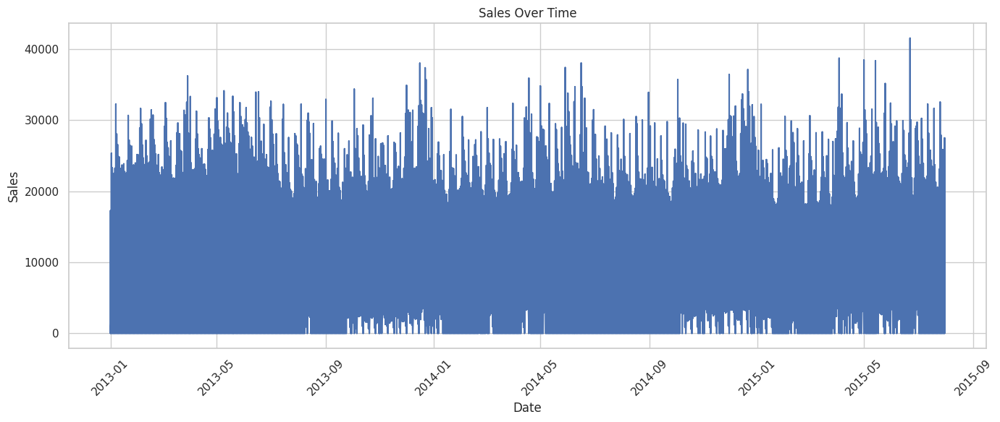

In [5]:
# Visualize sales over time
plt.figure(figsize=(14, 6))
plt.plot(df['Date'], df['Sales'])
plt.title('Sales Over Time')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [6]:
# Prepare Data for Prophet (Store 1 Example)

# Filter for a single store
store_df = df[df['Store'] == 1] # filters rows where store column is 1, i.e store_df only contains data for Store 1
store_df = store_df[(store_df['Open'] == 1) & (store_df['Sales'] > 0)]  # keeps only rows where store was open (==1) and where there's sale (>0)

# Prepare data for Prophet
df_prophet = store_df[['Date', 'Sales']].copy()
df_prophet.rename(columns={'Date': 'ds', 'Sales': 'y'}, inplace=True)
df_prophet.head()

,ds,y
0,2015-07-31,5263
1115,2015-07-30,5020
2230,2015-07-29,4782
3345,2015-07-28,5011
4460,2015-07-27,6102


In [7]:
# Fit the Model and Make Forecast

model = Prophet()
model.fit(df_prophet) # .fit() trains the model on the historical data (datatime column and sales values)

# Forecast for the next 60 days
future = model.make_future_dataframe(periods=60)
forecast = model.predict(future)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/81nyrgoq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jyan2hrj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79832', 'data', 'file=/tmp/tmpxeldf44v/81nyrgoq.json', 'init=/tmp/tmpxeldf44v/jyan2hrj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model7wvbktb5/prophet_model-20250701123346.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:33:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:33:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [8]:
# last 10 prediction

forecast.tail(10)[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]

,ds,yhat,yhat_lower,yhat_upper
831,2015-09-20,4279.107070,3239.276296,5317.637286
832,2015-09-21,4548.369875,3484.037853,5686.545550
833,2015-09-22,4088.818544,3012.389576,5172.831791
834,2015-09-23,4004.656667,2868.412139,5114.959425
835,2015-09-24,3949.097317,2873.769838,5113.560657
836,2015-09-25,4237.871295,3071.317648,5324.088036
837,2015-09-26,4476.894772,3382.196090,5538.002402
838,2015-09-27,4506.110778,3367.546236,5496.314768
839,2015-09-28,4777.461848,3676.078627,5823.684793
840,2015-09-29,4315.008751,3202.430606,5473.634063


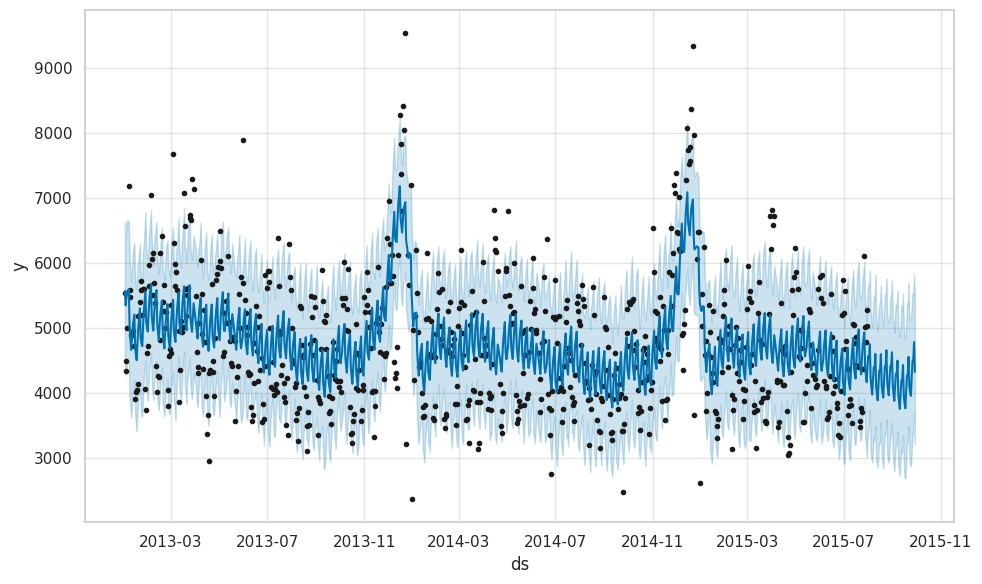

In [9]:
# Forecast Plot

fig1 = model.plot(forecast)
fig1.show()

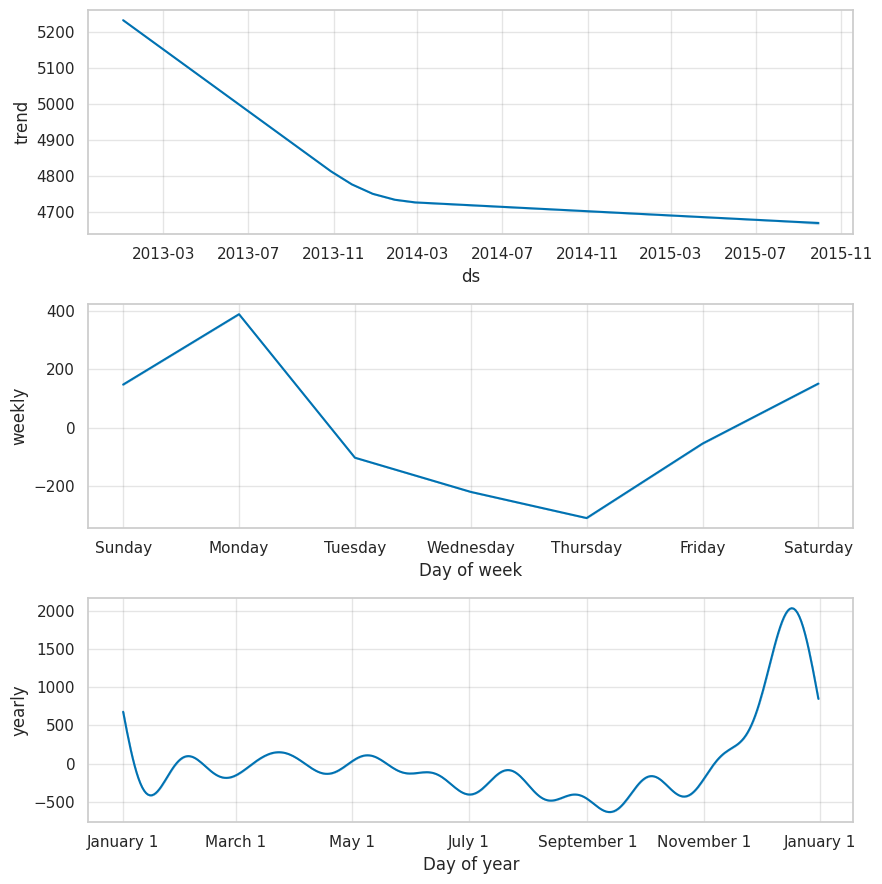

In [10]:
# Forecast Components

fig2 = model.plot_components(forecast)
fig2.show()

In [11]:
# Prophet predicts values for both historical dates and future dates
# forecast = model.predict(future)
# the future df includes the original dates from df_prophet['ds'] plus the future dates (additional 60 days)
# so it's not only predicting sales price for the future 60 days but for all existing day sales and the future 60 days
# so Prophet gives yhat for every date, both past and future
# Now, y(actual value) and yhat(predicted values) can be compared together

merged = df_prophet.merge(forecast[['ds', 'yhat']], on='ds')
merged.head(10)

,ds,y,yhat
0,2015-07-31,5263,4386.037576
1,2015-07-30,5020,4159.010250
2,2015-07-29,4782,4274.415651
3,2015-07-28,5011,4415.208269
4,2015-07-27,6102,4926.943432
5,2015-07-25,4364,4722.149401
6,2015-07-24,3706,4527.508940
7,2015-07-23,3769,4279.473623
8,2015-07-22,3464,4371.258840
9,2015-07-21,3558,4486.384617


In [12]:
# Evaluate Forecast Accuracy

mae = mean_absolute_error(merged['y'], merged['yhat'])
rmse = mean_squared_error(merged['y'], merged['yhat'])
rmse = np.sqrt(rmse)

print(f'MAE: {mae:.2f}')
print(f'RMSE: {rmse:.2f}')

MAE: 683.85
RMSE: 847.35


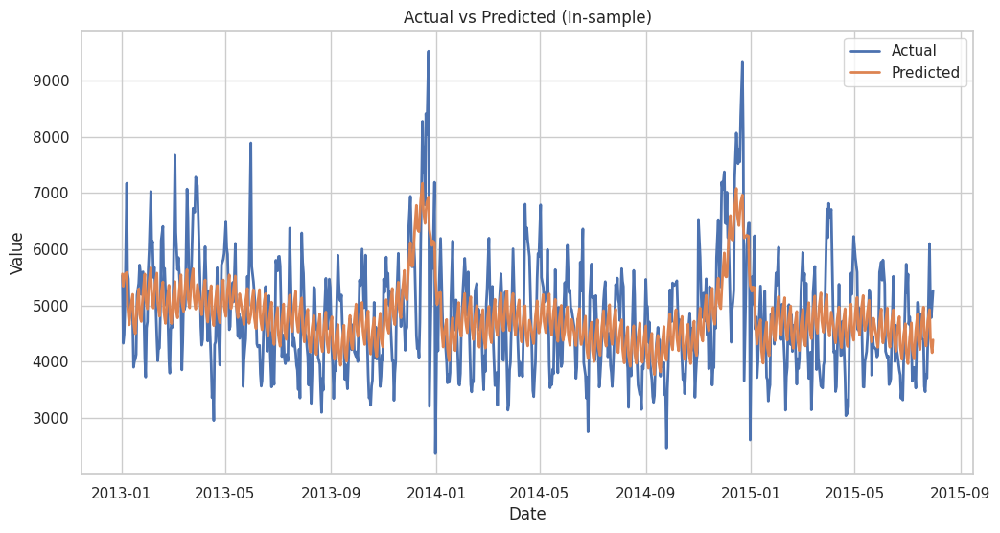

In [13]:
# Plot actual vs predicted

plt.figure(figsize=(12, 6))
plt.plot(merged['ds'], merged['y'], label='Actual', linewidth=2)
plt.plot(merged['ds'], merged['yhat'], label='Predicted', linewidth=2)
plt.legend()
plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Actual vs Predicted (In-sample)')
plt.grid(True)
plt.show()


# Multi-Store Forecasting and Holiday/Promo Handling support

The earlier model forecasts sales for only one store (Store == 1)

Multi-store forecasting loop through each store in the dataset and train one Prophet model per store

Rossmann sales are affected by state hoidays, school holidays, and promos. Prophet can automatically adjust forecasts around those dates if it was told when they happen

In [14]:
# Define holidays (Promo, StateHoliday, SchoolHoliday)
promo_days = df[df['Promo'] == 1]['Date'].drop_duplicates()
state_holidays = df[df['StateHoliday'].isin(['a', 'b', 'c'])]['Date'].drop_duplicates()
school_holidays = df[df['SchoolHoliday'] == 1]['Date'].drop_duplicates()

holidays = pd.concat([
    pd.DataFrame({'holiday': 'promo', 'ds': promo_days, 'lower_window': 0, 'upper_window': 0}),
    pd.DataFrame({'holiday': 'state_holiday', 'ds': state_holidays, 'lower_window': 0, 'upper_window': 1}),   # lower_window: how many days before the event the effect should apply
    pd.DataFrame({'holiday': 'school_holiday', 'ds': school_holidays, 'lower_window': 0, 'upper_window': 1})  # upper window: how many days after the event the effect should apply
])
# this merges all the three holiday df into one holidays df

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dnwai1ei.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/anckzz1a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64669', 'data', 'file=/tmp/tmpxeldf44v/dnwai1ei.json', 'init=/tmp/tmpxeldf44v/anckzz1a.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhppxk6kg/prophet_model-20250701123349.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:33:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:33:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Store 1 forecast done.


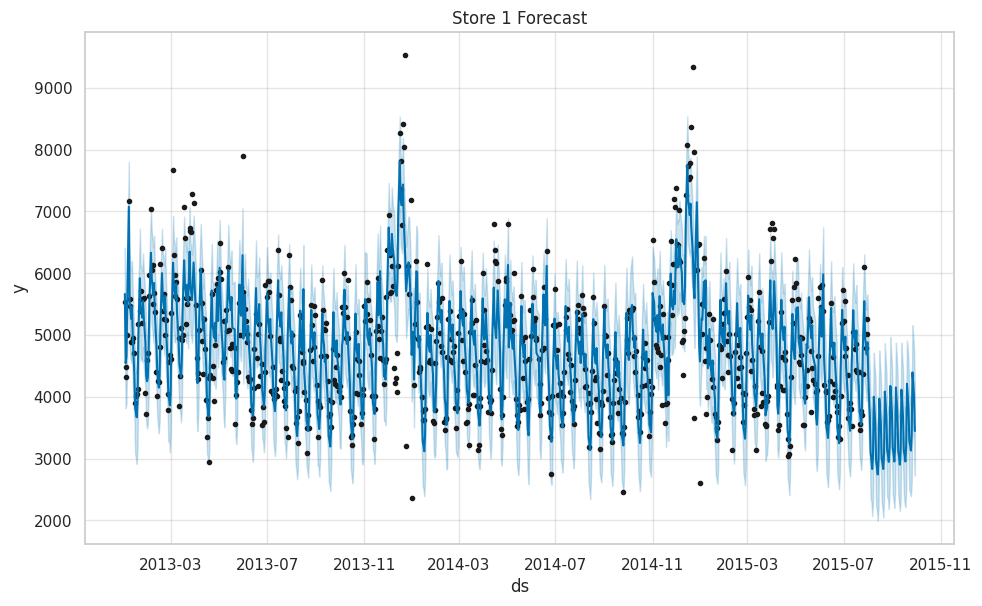

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uva3nzdz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9lkiop0f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35387', 'data', 'file=/tmp/tmpxeldf44v/uva3nzdz.json', 'init=/tmp/tmpxeldf44v/9lkiop0f.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_5mj0pdh/prophet_model-20250701123351.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:33:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:33:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Store 2 forecast done.


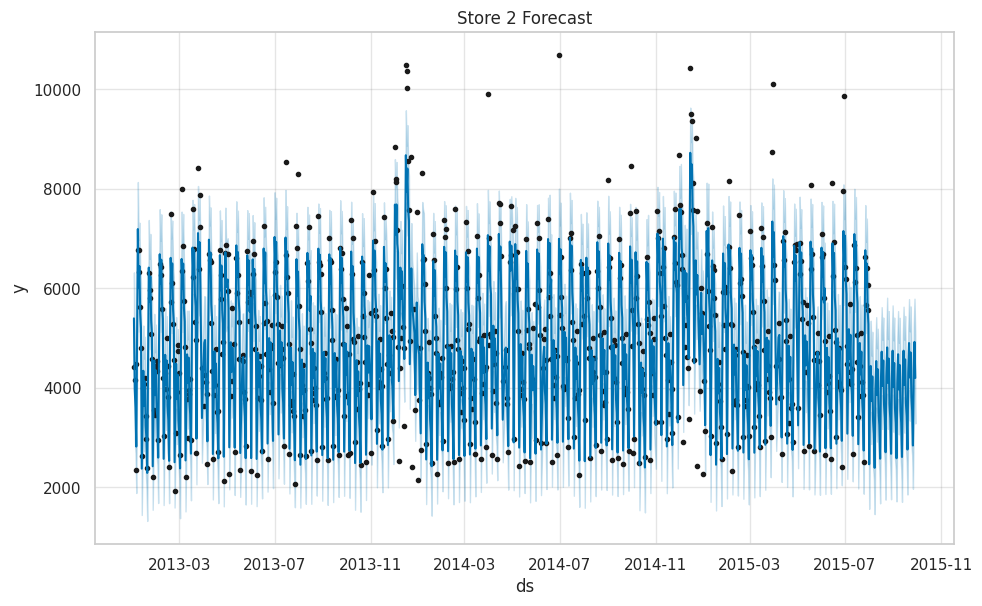

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5qgyevi9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/x5djqk_o.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79045', 'data', 'file=/tmp/tmpxeldf44v/5qgyevi9.json', 'init=/tmp/tmpxeldf44v/x5djqk_o.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwo3win0s/prophet_model-20250701123352.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:33:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:33:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Store 3 forecast done.


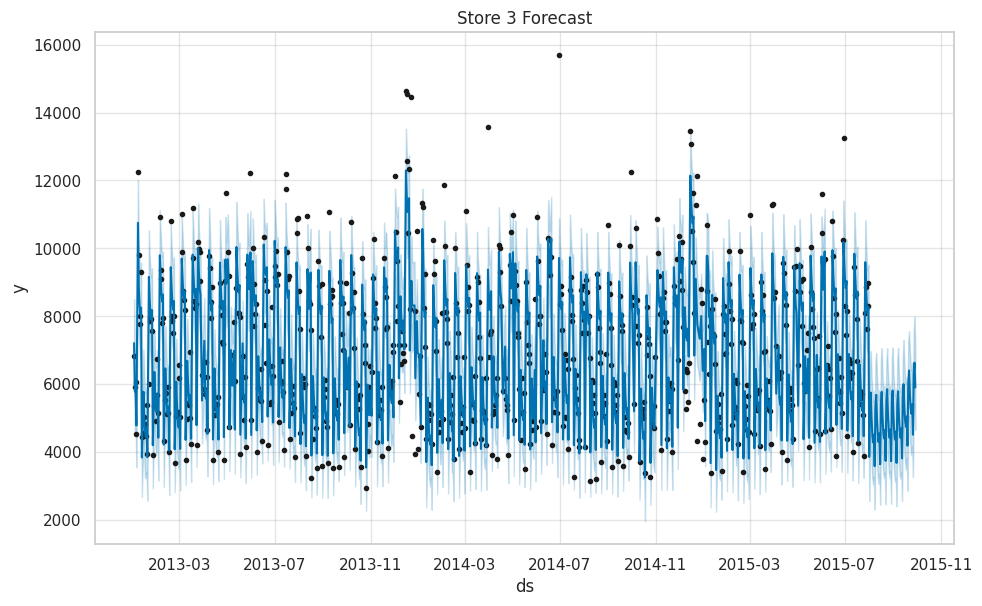

In [15]:
# Multi_Store Forecasting with Prophet

store_ids = df['Store'].unique()[:3]  # You can change to more stores
all_forecasts = []

for store_id in store_ids:
    store_df = df[(df['Store'] == store_id) & (df['Open'] == 1) & (df['Sales'] > 0)]
    df_prophet = store_df[['Date', 'Sales']].copy()
    df_prophet.rename(columns={'Date': 'ds', 'Sales': 'y'}, inplace=True)

    model = Prophet(holidays=holidays)
    model.fit(df_prophet)
    # trains a Prophet model, this time including holiday effects

    future = model.make_future_dataframe(periods=60)
    forecast = model.predict(future)
    # extends the timeline by 60 days and predicts sales for those dates
    forecast['Store'] = store_id
    # adds a Store column to the forecast
    all_forecasts.append(forecast)
    # appends to the list for later use

    print(f"Store {store_id} forecast done.")
    model.plot(forecast)
    plt.title(f"Store {store_id} Forecast")
    plt.show()
    # plots the forecast with uncertainty bands for each store

In [16]:
for store_id, forecast in zip(store_ids, all_forecasts):
    original = df[(df['Store'] == store_id) & (df['Open'] == 1) & (df['Sales'] > 0)][['Date', 'Sales']] # keeps only the date and sales columns
    original = original.rename(columns={'Date': 'ds', 'Sales': 'y'})
    merged = original.merge(forecast[['ds', 'yhat']], on='ds')  # joins actual (y) and predicted (yhat) sales on matching dates

    # Evaluate Forecast Accuracy For Each Store
    mae = mean_absolute_error(merged['y'], merged['yhat'])
    rmse = mean_squared_error(merged['y'], merged['yhat'])
    rmse = np.sqrt(rmse)
    print(f"Store {store_id} → MAE: {mae:.2f}, RMSE: {rmse:.2f}")

Store 1 → MAE: 429.65, RMSE: 577.93
Store 2 → MAE: 515.79, RMSE: 716.51
Store 3 → MAE: 715.79, RMSE: 980.83


# Evaluating Training Performance
Using text.cvs file to generate future forecasts
The goal is to match Prophet's forecast values yhat to the test.csv dates for each store

In [17]:
# Uploading the test.csv file

from google.colab import files
files.upload()

Saving test.csv to test.csv


{'test.csv': b'"Id","Store","DayOfWeek","Date","Open","Promo","StateHoliday","SchoolHoliday"\n1,1,4,2015-09-17,1,1,"0","0"\n2,3,4,2015-09-17,1,1,"0","0"\n3,7,4,2015-09-17,1,1,"0","0"\n4,8,4,2015-09-17,1,1,"0","0"\n5,9,4,2015-09-17,1,1,"0","0"\n6,10,4,2015-09-17,1,1,"0","0"\n7,11,4,2015-09-17,1,1,"0","0"\n8,12,4,2015-09-17,1,1,"0","0"\n9,13,4,2015-09-17,1,1,"0","0"\n10,14,4,2015-09-17,1,1,"0","0"\n11,15,4,2015-09-17,1,1,"0","0"\n12,16,4,2015-09-17,1,1,"0","0"\n13,19,4,2015-09-17,1,1,"0","0"\n14,20,4,2015-09-17,1,1,"0","0"\n15,21,4,2015-09-17,1,1,"0","0"\n16,22,4,2015-09-17,1,1,"0","0"\n17,23,4,2015-09-17,1,1,"0","0"\n18,24,4,2015-09-17,1,1,"0","0"\n19,25,4,2015-09-17,1,1,"0","0"\n20,27,4,2015-09-17,1,1,"0","0"\n21,29,4,2015-09-17,1,1,"0","0"\n22,30,4,2015-09-17,1,1,"0","0"\n23,31,4,2015-09-17,1,1,"0","0"\n24,32,4,2015-09-17,1,1,"0","0"\n25,33,4,2015-09-17,1,1,"0","0"\n26,35,4,2015-09-17,1,1,"0","0"\n27,36,4,2015-09-17,1,1,"0","0"\n28,38,4,2015-09-17,1,1,"0","0"\n29,39,4,2015-09-17,1,1,"

In [18]:
test_df = pd.read_csv("test.csv", parse_dates=["Date"])
test_df.head()

,Id,Store,DayOfWeek,Date,Open,Promo,StateHoliday,SchoolHoliday
0,1,1,4,2015-09-17,1.0,1,0,0
1,2,3,4,2015-09-17,1.0,1,0,0
2,3,7,4,2015-09-17,1.0,1,0,0
3,4,8,4,2015-09-17,1.0,1,0,0
4,5,9,4,2015-09-17,1.0,1,0,0


In [23]:
# Forecast for Each Store up to the Max Test Date
# Extraxt yhat only for those dates

# forecast horizon
test_dates = test_df["Date"].max()

# unique stores in the test set
store_ids = test_df['Store'].unique()
store_predictions = []

# directory to store models
os.makedirs("saved_models", exist_ok=True)

for store_id in store_ids:
    store_df = df[(df["Store"] == store_id) & (df["Open"] == 1) & (df["Sales"] > 0)]
    if store_df.empty:
        continue

    df_prophet = store_df[["Date", "Sales"]].rename(columns={"Date": "ds", "Sales": "y"})

    # Fit model
    model = Prophet(holidays=holidays)
    model.fit(df_prophet)

    # Save model to file
    model_path = f"saved_models/prophet_store_{store_id}.pkl"
    joblib.dump(model, model_path)
    print(f"Model for Store {store_id} saved to {model_path}")

    # Forecast until max date in test set
    last_train_date = df_prophet["ds"].max()
    days_to_forecast = (test_dates - last_train_date).days
    future = model.make_future_dataframe(periods=days_to_forecast)
    forecast = model.predict(future)

    # Filter forecast for test dates
    test_subset = test_df[test_df["Store"] == store_id][["Id", "Date"]].rename(columns={"Date": "ds"})
    prediction = test_subset.merge(forecast[["ds", "yhat"]], on="ds", how="left")
    prediction["Store"] = store_id
    store_predictions.append(prediction)


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_e588e17.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fw9tjsgt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1088', 'data', 'file=/tmp/tmpxeldf44v/_e588e17.json', 'init=/tmp/tmpxeldf44v/fw9tjsgt.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelk5uoyy24/prophet_model-20250701124927.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1 saved to saved_models/prophet_store_1.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w46tknb9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g6drlrma.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79164', 'data', 'file=/tmp/tmpxeldf44v/w46tknb9.json', 'init=/tmp/tmpxeldf44v/g6drlrma.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_g655xt6/prophet_model-20250701124928.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 3 saved to saved_models/prophet_store_3.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xiw8iq39.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/k4ubiqjx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10253', 'data', 'file=/tmp/tmpxeldf44v/xiw8iq39.json', 'init=/tmp/tmpxeldf44v/k4ubiqjx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modello9qguil/prophet_model-20250701124929.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 7 saved to saved_models/prophet_store_7.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xxzzyef6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7tqn6y1e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10456', 'data', 'file=/tmp/tmpxeldf44v/xxzzyef6.json', 'init=/tmp/tmpxeldf44v/7tqn6y1e.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9s57djoa/prophet_model-20250701124930.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 8 saved to saved_models/prophet_store_8.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gek6nxeu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/n6i4g543.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12270', 'data', 'file=/tmp/tmpxeldf44v/gek6nxeu.json', 'init=/tmp/tmpxeldf44v/n6i4g543.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1f6khz5q/prophet_model-20250701124931.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 9 saved to saved_models/prophet_store_9.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tjz7bc7a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/26hecwms.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74219', 'data', 'file=/tmp/tmpxeldf44v/tjz7bc7a.json', 'init=/tmp/tmpxeldf44v/26hecwms.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelsw5cs5qz/prophet_model-20250701124932.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 10 saved to saved_models/prophet_store_10.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/32c5shvj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dq9vwc8a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80331', 'data', 'file=/tmp/tmpxeldf44v/32c5shvj.json', 'init=/tmp/tmpxeldf44v/dq9vwc8a.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelimwyti8x/prophet_model-20250701124933.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 11 saved to saved_models/prophet_store_11.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vn15dz91.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1g9n6xiy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84027', 'data', 'file=/tmp/tmpxeldf44v/vn15dz91.json', 'init=/tmp/tmpxeldf44v/1g9n6xiy.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelnkaok507/prophet_model-20250701124934.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 12 saved to saved_models/prophet_store_12.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fekha6nc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3utct274.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80057', 'data', 'file=/tmp/tmpxeldf44v/fekha6nc.json', 'init=/tmp/tmpxeldf44v/3utct274.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli4mgz_k8/prophet_model-20250701124934.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 13 saved to saved_models/prophet_store_13.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b_zy3tdu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/13ndkzr_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30016', 'data', 'file=/tmp/tmpxeldf44v/b_zy3tdu.json', 'init=/tmp/tmpxeldf44v/13ndkzr_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model263z5yte/prophet_model-20250701124935.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 14 saved to saved_models/prophet_store_14.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ywhawstd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6ouq1vgn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93618', 'data', 'file=/tmp/tmpxeldf44v/ywhawstd.json', 'init=/tmp/tmpxeldf44v/6ouq1vgn.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3e4_t_lq/prophet_model-20250701124936.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 15 saved to saved_models/prophet_store_15.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qrncw2sa.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4jyr7unj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40393', 'data', 'file=/tmp/tmpxeldf44v/qrncw2sa.json', 'init=/tmp/tmpxeldf44v/4jyr7unj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeluxz2i1bj/prophet_model-20250701124936.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 16 saved to saved_models/prophet_store_16.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zbe_mpx1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y82vvli9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6856', 'data', 'file=/tmp/tmpxeldf44v/zbe_mpx1.json', 'init=/tmp/tmpxeldf44v/y82vvli9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwl55inu3/prophet_model-20250701124937.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 19 saved to saved_models/prophet_store_19.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kz75mueb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8t_2d782.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7403', 'data', 'file=/tmp/tmpxeldf44v/kz75mueb.json', 'init=/tmp/tmpxeldf44v/8t_2d782.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model7wo_6zmn/prophet_model-20250701124938.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 20 saved to saved_models/prophet_store_20.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g9yejlwc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uznwrte9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73427', 'data', 'file=/tmp/tmpxeldf44v/g9yejlwc.json', 'init=/tmp/tmpxeldf44v/uznwrte9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyhl7i12x/prophet_model-20250701124939.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 21 saved to saved_models/prophet_store_21.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/iws4491z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/20hm2v1w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97195', 'data', 'file=/tmp/tmpxeldf44v/iws4491z.json', 'init=/tmp/tmpxeldf44v/20hm2v1w.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelg75cyzy4/prophet_model-20250701124939.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 22 saved to saved_models/prophet_store_22.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ce2e6_2v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qvrmokdf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78653', 'data', 'file=/tmp/tmpxeldf44v/ce2e6_2v.json', 'init=/tmp/tmpxeldf44v/qvrmokdf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model34hb3naj/prophet_model-20250701124940.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 23 saved to saved_models/prophet_store_23.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6qpxhljb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/k4y_rqzf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=75868', 'data', 'file=/tmp/tmpxeldf44v/6qpxhljb.json', 'init=/tmp/tmpxeldf44v/k4y_rqzf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldt9cohey/prophet_model-20250701124941.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 24 saved to saved_models/prophet_store_24.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pjortfu7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w3rlql48.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71181', 'data', 'file=/tmp/tmpxeldf44v/pjortfu7.json', 'init=/tmp/tmpxeldf44v/w3rlql48.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9vf12z99/prophet_model-20250701124941.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 25 saved to saved_models/prophet_store_25.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/og3otarx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j2_4f4nh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20511', 'data', 'file=/tmp/tmpxeldf44v/og3otarx.json', 'init=/tmp/tmpxeldf44v/j2_4f4nh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzfjw8m4w/prophet_model-20250701124942.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 27 saved to saved_models/prophet_store_27.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6imffr9c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dncxczkf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48337', 'data', 'file=/tmp/tmpxeldf44v/6imffr9c.json', 'init=/tmp/tmpxeldf44v/dncxczkf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model07foe3yl/prophet_model-20250701124943.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 29 saved to saved_models/prophet_store_29.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wv6wut0s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gskm5uw8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96328', 'data', 'file=/tmp/tmpxeldf44v/wv6wut0s.json', 'init=/tmp/tmpxeldf44v/gskm5uw8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9ke2gxcm/prophet_model-20250701124944.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 30 saved to saved_models/prophet_store_30.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dz6r6wou.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/a5lwvhsl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=45042', 'data', 'file=/tmp/tmpxeldf44v/dz6r6wou.json', 'init=/tmp/tmpxeldf44v/a5lwvhsl.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelkafiv9xh/prophet_model-20250701124945.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 31 saved to saved_models/prophet_store_31.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rvej002o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rskjs_km.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18600', 'data', 'file=/tmp/tmpxeldf44v/rvej002o.json', 'init=/tmp/tmpxeldf44v/rskjs_km.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelnh94hbyz/prophet_model-20250701124946.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 32 saved to saved_models/prophet_store_32.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/112t9c0q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ol4_po3v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22827', 'data', 'file=/tmp/tmpxeldf44v/112t9c0q.json', 'init=/tmp/tmpxeldf44v/ol4_po3v.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelv1acubw2/prophet_model-20250701124947.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 33 saved to saved_models/prophet_store_33.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/d4y7xtz2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3f1p68up.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22470', 'data', 'file=/tmp/tmpxeldf44v/d4y7xtz2.json', 'init=/tmp/tmpxeldf44v/3f1p68up.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelle3m5mnl/prophet_model-20250701124947.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 35 saved to saved_models/prophet_store_35.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ehqg_dac.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i28m8xng.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98223', 'data', 'file=/tmp/tmpxeldf44v/ehqg_dac.json', 'init=/tmp/tmpxeldf44v/i28m8xng.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelilt9l722/prophet_model-20250701124948.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 36 saved to saved_models/prophet_store_36.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2bdh0c9i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/f3_ydw59.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50233', 'data', 'file=/tmp/tmpxeldf44v/2bdh0c9i.json', 'init=/tmp/tmpxeldf44v/f3_ydw59.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modely2ivif84/prophet_model-20250701124949.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 38 saved to saved_models/prophet_store_38.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hf4w4cfi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e9x1ugx7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=55963', 'data', 'file=/tmp/tmpxeldf44v/hf4w4cfi.json', 'init=/tmp/tmpxeldf44v/e9x1ugx7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelcc64nboh/prophet_model-20250701124950.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 39 saved to saved_models/prophet_store_39.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_4wodegb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9hfcnyl1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59613', 'data', 'file=/tmp/tmpxeldf44v/_4wodegb.json', 'init=/tmp/tmpxeldf44v/9hfcnyl1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model6yshe_lv/prophet_model-20250701124950.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 40 saved to saved_models/prophet_store_40.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/d3d1e3d8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hhh5qtjj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15601', 'data', 'file=/tmp/tmpxeldf44v/d3d1e3d8.json', 'init=/tmp/tmpxeldf44v/hhh5qtjj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljevv5a9f/prophet_model-20250701124951.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 41 saved to saved_models/prophet_store_41.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b9c17ul5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6pophd9r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36248', 'data', 'file=/tmp/tmpxeldf44v/b9c17ul5.json', 'init=/tmp/tmpxeldf44v/6pophd9r.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelr4vow4zg/prophet_model-20250701124952.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 42 saved to saved_models/prophet_store_42.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ob4v6qyr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0ikvvibc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77171', 'data', 'file=/tmp/tmpxeldf44v/ob4v6qyr.json', 'init=/tmp/tmpxeldf44v/0ikvvibc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modell7g1q6ty/prophet_model-20250701124953.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 43 saved to saved_models/prophet_store_43.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/h9t7zl2q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3abamsr3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3318', 'data', 'file=/tmp/tmpxeldf44v/h9t7zl2q.json', 'init=/tmp/tmpxeldf44v/3abamsr3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelntyicqn_/prophet_model-20250701124953.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 45 saved to saved_models/prophet_store_45.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/88apbtc0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pbsrpgi0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12888', 'data', 'file=/tmp/tmpxeldf44v/88apbtc0.json', 'init=/tmp/tmpxeldf44v/pbsrpgi0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgx0g610f/prophet_model-20250701124954.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 46 saved to saved_models/prophet_store_46.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1yew6x9h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/do8ckwmj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38841', 'data', 'file=/tmp/tmpxeldf44v/1yew6x9h.json', 'init=/tmp/tmpxeldf44v/do8ckwmj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model06y31xzw/prophet_model-20250701124955.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 47 saved to saved_models/prophet_store_47.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qw6fc7fp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1232miob.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82647', 'data', 'file=/tmp/tmpxeldf44v/qw6fc7fp.json', 'init=/tmp/tmpxeldf44v/1232miob.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelrffjsz2b/prophet_model-20250701124955.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 48 saved to saved_models/prophet_store_48.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/l5qthgid.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_joykllw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63316', 'data', 'file=/tmp/tmpxeldf44v/l5qthgid.json', 'init=/tmp/tmpxeldf44v/_joykllw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelsrlg2rpl/prophet_model-20250701124956.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 49 saved to saved_models/prophet_store_49.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pana6481.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fmpt3n8z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66524', 'data', 'file=/tmp/tmpxeldf44v/pana6481.json', 'init=/tmp/tmpxeldf44v/fmpt3n8z.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelp6bb3y1w/prophet_model-20250701124957.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 50 saved to saved_models/prophet_store_50.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1otlqoz4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/t56ofzac.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15059', 'data', 'file=/tmp/tmpxeldf44v/1otlqoz4.json', 'init=/tmp/tmpxeldf44v/t56ofzac.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqx5qaeq_/prophet_model-20250701124958.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 51 saved to saved_models/prophet_store_51.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/aiea2v8b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ep2gma8g.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40167', 'data', 'file=/tmp/tmpxeldf44v/aiea2v8b.json', 'init=/tmp/tmpxeldf44v/ep2gma8g.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelcfm0jgm2/prophet_model-20250701124959.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:49:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:49:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 52 saved to saved_models/prophet_store_52.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7e7iplwa.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qlatz04j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=46054', 'data', 'file=/tmp/tmpxeldf44v/7e7iplwa.json', 'init=/tmp/tmpxeldf44v/qlatz04j.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_5ejah9w/prophet_model-20250701125000.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 53 saved to saved_models/prophet_store_53.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/m6b28c1r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qa5l8km4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33219', 'data', 'file=/tmp/tmpxeldf44v/m6b28c1r.json', 'init=/tmp/tmpxeldf44v/qa5l8km4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modela421ev_x/prophet_model-20250701125000.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 56 saved to saved_models/prophet_store_56.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3z_lp5dx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nr7gmvc8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79953', 'data', 'file=/tmp/tmpxeldf44v/3z_lp5dx.json', 'init=/tmp/tmpxeldf44v/nr7gmvc8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelo5bn8fdn/prophet_model-20250701125001.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 58 saved to saved_models/prophet_store_58.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o0m14tjs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gnqiu430.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93950', 'data', 'file=/tmp/tmpxeldf44v/o0m14tjs.json', 'init=/tmp/tmpxeldf44v/gnqiu430.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelidmxce05/prophet_model-20250701125002.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 61 saved to saved_models/prophet_store_61.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c63tbwhz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s5msomiz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86597', 'data', 'file=/tmp/tmpxeldf44v/c63tbwhz.json', 'init=/tmp/tmpxeldf44v/s5msomiz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelb04ts4uo/prophet_model-20250701125003.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 62 saved to saved_models/prophet_store_62.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jogj30tr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/43e0t6bc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51458', 'data', 'file=/tmp/tmpxeldf44v/jogj30tr.json', 'init=/tmp/tmpxeldf44v/43e0t6bc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfyd7jfom/prophet_model-20250701125003.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 63 saved to saved_models/prophet_store_63.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/asw0b_co.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q1u48uon.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88230', 'data', 'file=/tmp/tmpxeldf44v/asw0b_co.json', 'init=/tmp/tmpxeldf44v/q1u48uon.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model7g2v670o/prophet_model-20250701125004.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 64 saved to saved_models/prophet_store_64.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2huw5n8t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8zkz8zwz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17853', 'data', 'file=/tmp/tmpxeldf44v/2huw5n8t.json', 'init=/tmp/tmpxeldf44v/8zkz8zwz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model4ospd45n/prophet_model-20250701125005.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 66 saved to saved_models/prophet_store_66.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pzbnd674.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_9nh8r7x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99338', 'data', 'file=/tmp/tmpxeldf44v/pzbnd674.json', 'init=/tmp/tmpxeldf44v/_9nh8r7x.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelphjw5l9p/prophet_model-20250701125006.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 67 saved to saved_models/prophet_store_67.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/eu70gwbs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i6zks7hz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76923', 'data', 'file=/tmp/tmpxeldf44v/eu70gwbs.json', 'init=/tmp/tmpxeldf44v/i6zks7hz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modele44rt_u8/prophet_model-20250701125007.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 68 saved to saved_models/prophet_store_68.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dikc6h8d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cu9dms4h.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10246', 'data', 'file=/tmp/tmpxeldf44v/dikc6h8d.json', 'init=/tmp/tmpxeldf44v/cu9dms4h.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli1ekl8k8/prophet_model-20250701125007.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 69 saved to saved_models/prophet_store_69.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8ucy3p62.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bntm03hk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57373', 'data', 'file=/tmp/tmpxeldf44v/8ucy3p62.json', 'init=/tmp/tmpxeldf44v/bntm03hk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyev9te3j/prophet_model-20250701125008.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 70 saved to saved_models/prophet_store_70.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/70y23zlg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kuxed3pi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83906', 'data', 'file=/tmp/tmpxeldf44v/70y23zlg.json', 'init=/tmp/tmpxeldf44v/kuxed3pi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8ob0h8fl/prophet_model-20250701125009.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 71 saved to saved_models/prophet_store_71.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/h0c5yrws.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/evbekkul.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2690', 'data', 'file=/tmp/tmpxeldf44v/h0c5yrws.json', 'init=/tmp/tmpxeldf44v/evbekkul.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelm8n3maza/prophet_model-20250701125010.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 72 saved to saved_models/prophet_store_72.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4sev_dfq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fkg61a3f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34402', 'data', 'file=/tmp/tmpxeldf44v/4sev_dfq.json', 'init=/tmp/tmpxeldf44v/fkg61a3f.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzog87pas/prophet_model-20250701125011.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 73 saved to saved_models/prophet_store_73.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cyjdqjb5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rls10eta.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22351', 'data', 'file=/tmp/tmpxeldf44v/cyjdqjb5.json', 'init=/tmp/tmpxeldf44v/rls10eta.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelh0lbkkg9/prophet_model-20250701125012.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 74 saved to saved_models/prophet_store_74.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v5075yuz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sgf1eout.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61498', 'data', 'file=/tmp/tmpxeldf44v/v5075yuz.json', 'init=/tmp/tmpxeldf44v/sgf1eout.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modellpnbnb7u/prophet_model-20250701125013.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 75 saved to saved_models/prophet_store_75.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rgg9x195.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/053hi11c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70779', 'data', 'file=/tmp/tmpxeldf44v/rgg9x195.json', 'init=/tmp/tmpxeldf44v/053hi11c.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelraw9rg1i/prophet_model-20250701125013.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 76 saved to saved_models/prophet_store_76.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/luyzhv3n.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ixi_5vc8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5078', 'data', 'file=/tmp/tmpxeldf44v/luyzhv3n.json', 'init=/tmp/tmpxeldf44v/ixi_5vc8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeld3q9h9xh/prophet_model-20250701125014.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 77 saved to saved_models/prophet_store_77.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2ane7x04.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jps6enot.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54213', 'data', 'file=/tmp/tmpxeldf44v/2ane7x04.json', 'init=/tmp/tmpxeldf44v/jps6enot.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelcrp9jgln/prophet_model-20250701125015.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 79 saved to saved_models/prophet_store_79.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v42f7qov.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bgh_uq6_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35099', 'data', 'file=/tmp/tmpxeldf44v/v42f7qov.json', 'init=/tmp/tmpxeldf44v/bgh_uq6_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model84ne81ep/prophet_model-20250701125015.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 80 saved to saved_models/prophet_store_80.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hrjybmk9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q5pgfcui.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36886', 'data', 'file=/tmp/tmpxeldf44v/hrjybmk9.json', 'init=/tmp/tmpxeldf44v/q5pgfcui.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model83htqln5/prophet_model-20250701125016.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 81 saved to saved_models/prophet_store_81.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ic24xr_l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rn3zz6o2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76942', 'data', 'file=/tmp/tmpxeldf44v/ic24xr_l.json', 'init=/tmp/tmpxeldf44v/rn3zz6o2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3xpss4_9/prophet_model-20250701125017.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 82 saved to saved_models/prophet_store_82.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0_rcwnhq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gaqt7ah3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62364', 'data', 'file=/tmp/tmpxeldf44v/0_rcwnhq.json', 'init=/tmp/tmpxeldf44v/gaqt7ah3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2o_7t08k/prophet_model-20250701125017.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 83 saved to saved_models/prophet_store_83.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_5n_8wp2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rq4ibr5k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48704', 'data', 'file=/tmp/tmpxeldf44v/_5n_8wp2.json', 'init=/tmp/tmpxeldf44v/rq4ibr5k.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelbn56tb7b/prophet_model-20250701125018.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 84 saved to saved_models/prophet_store_84.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mhc1amcf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vj21un9s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28675', 'data', 'file=/tmp/tmpxeldf44v/mhc1amcf.json', 'init=/tmp/tmpxeldf44v/vj21un9s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeleyou2jo2/prophet_model-20250701125019.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 86 saved to saved_models/prophet_store_86.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/04hl4wmd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w_pv3fng.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13351', 'data', 'file=/tmp/tmpxeldf44v/04hl4wmd.json', 'init=/tmp/tmpxeldf44v/w_pv3fng.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5_fq1nf4/prophet_model-20250701125020.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 89 saved to saved_models/prophet_store_89.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g5wnzki6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ds2zlu4j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5299', 'data', 'file=/tmp/tmpxeldf44v/g5wnzki6.json', 'init=/tmp/tmpxeldf44v/ds2zlu4j.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpmqwppdt/prophet_model-20250701125020.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 90 saved to saved_models/prophet_store_90.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/svg_t3ec.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gtt8sp1c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31554', 'data', 'file=/tmp/tmpxeldf44v/svg_t3ec.json', 'init=/tmp/tmpxeldf44v/gtt8sp1c.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2us5ajsv/prophet_model-20250701125021.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 91 saved to saved_models/prophet_store_91.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/regsiu_v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4qfrk9km.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37642', 'data', 'file=/tmp/tmpxeldf44v/regsiu_v.json', 'init=/tmp/tmpxeldf44v/4qfrk9km.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelq8cjvu2i/prophet_model-20250701125022.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 92 saved to saved_models/prophet_store_92.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u8uh0d1s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/czq096u8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36207', 'data', 'file=/tmp/tmpxeldf44v/u8uh0d1s.json', 'init=/tmp/tmpxeldf44v/czq096u8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5imlxxo8/prophet_model-20250701125023.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 93 saved to saved_models/prophet_store_93.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/69wdyl21.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ost52n7i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36070', 'data', 'file=/tmp/tmpxeldf44v/69wdyl21.json', 'init=/tmp/tmpxeldf44v/ost52n7i.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model34zt4pxh/prophet_model-20250701125024.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 94 saved to saved_models/prophet_store_94.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hmpd5i9h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/z5qo09dw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80544', 'data', 'file=/tmp/tmpxeldf44v/hmpd5i9h.json', 'init=/tmp/tmpxeldf44v/z5qo09dw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelstdfqns9/prophet_model-20250701125025.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 98 saved to saved_models/prophet_store_98.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g62mag6w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yun8k8l3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52299', 'data', 'file=/tmp/tmpxeldf44v/g62mag6w.json', 'init=/tmp/tmpxeldf44v/yun8k8l3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model__3meg1c/prophet_model-20250701125025.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 99 saved to saved_models/prophet_store_99.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7eulbudv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dsho3g0q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36865', 'data', 'file=/tmp/tmpxeldf44v/7eulbudv.json', 'init=/tmp/tmpxeldf44v/dsho3g0q.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelmjqyah0x/prophet_model-20250701125026.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 100 saved to saved_models/prophet_store_100.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qs8qhk2p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ufhneop3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=85781', 'data', 'file=/tmp/tmpxeldf44v/qs8qhk2p.json', 'init=/tmp/tmpxeldf44v/ufhneop3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model26_c2esf/prophet_model-20250701125027.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 101 saved to saved_models/prophet_store_101.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gkqfj0id.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/th5_lvnj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98826', 'data', 'file=/tmp/tmpxeldf44v/gkqfj0id.json', 'init=/tmp/tmpxeldf44v/th5_lvnj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelm62rooix/prophet_model-20250701125027.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 102 saved to saved_models/prophet_store_102.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fenkz35l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yjvgn2eg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65943', 'data', 'file=/tmp/tmpxeldf44v/fenkz35l.json', 'init=/tmp/tmpxeldf44v/yjvgn2eg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model51fdce5_/prophet_model-20250701125028.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 105 saved to saved_models/prophet_store_105.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fae6u250.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u9kvsbws.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49684', 'data', 'file=/tmp/tmpxeldf44v/fae6u250.json', 'init=/tmp/tmpxeldf44v/u9kvsbws.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltrtnk5rb/prophet_model-20250701125029.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 107 saved to saved_models/prophet_store_107.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jqd15gff.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2z3q6u2e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35004', 'data', 'file=/tmp/tmpxeldf44v/jqd15gff.json', 'init=/tmp/tmpxeldf44v/2z3q6u2e.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxuo_xukb/prophet_model-20250701125030.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 108 saved to saved_models/prophet_store_108.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0w0lr0je.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_xhbc15r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67341', 'data', 'file=/tmp/tmpxeldf44v/0w0lr0je.json', 'init=/tmp/tmpxeldf44v/_xhbc15r.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelg751axs3/prophet_model-20250701125031.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 109 saved to saved_models/prophet_store_109.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4lk_ny71.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/23kpjfkt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56035', 'data', 'file=/tmp/tmpxeldf44v/4lk_ny71.json', 'init=/tmp/tmpxeldf44v/23kpjfkt.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelz11dedyg/prophet_model-20250701125031.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 110 saved to saved_models/prophet_store_110.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qdhcpqca.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pwdkjf4h.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43723', 'data', 'file=/tmp/tmpxeldf44v/qdhcpqca.json', 'init=/tmp/tmpxeldf44v/pwdkjf4h.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2iu7qp78/prophet_model-20250701125032.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 111 saved to saved_models/prophet_store_111.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wc19un58.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6wy0mv7b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59719', 'data', 'file=/tmp/tmpxeldf44v/wc19un58.json', 'init=/tmp/tmpxeldf44v/6wy0mv7b.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqeusq_fd/prophet_model-20250701125033.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 112 saved to saved_models/prophet_store_112.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c79pe8hz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jr0s_0p2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93013', 'data', 'file=/tmp/tmpxeldf44v/c79pe8hz.json', 'init=/tmp/tmpxeldf44v/jr0s_0p2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelydxd5w34/prophet_model-20250701125033.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 113 saved to saved_models/prophet_store_113.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/19r2wytn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7jfni8m7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2798', 'data', 'file=/tmp/tmpxeldf44v/19r2wytn.json', 'init=/tmp/tmpxeldf44v/7jfni8m7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpb49r_ex/prophet_model-20250701125034.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 115 saved to saved_models/prophet_store_115.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sg1ardd9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1oefpy9d.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23952', 'data', 'file=/tmp/tmpxeldf44v/sg1ardd9.json', 'init=/tmp/tmpxeldf44v/1oefpy9d.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelt8yfsd3_/prophet_model-20250701125035.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 117 saved to saved_models/prophet_store_117.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4dimmet6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/aepxbn65.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4094', 'data', 'file=/tmp/tmpxeldf44v/4dimmet6.json', 'init=/tmp/tmpxeldf44v/aepxbn65.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelf21lwymf/prophet_model-20250701125036.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 118 saved to saved_models/prophet_store_118.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4xa1rr64.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uzmpz1w_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95617', 'data', 'file=/tmp/tmpxeldf44v/4xa1rr64.json', 'init=/tmp/tmpxeldf44v/uzmpz1w_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model4703ubpb/prophet_model-20250701125037.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 119 saved to saved_models/prophet_store_119.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/exp_taj1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0my5hdy3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56791', 'data', 'file=/tmp/tmpxeldf44v/exp_taj1.json', 'init=/tmp/tmpxeldf44v/0my5hdy3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0a3d_xeu/prophet_model-20250701125038.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 120 saved to saved_models/prophet_store_120.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ja2ecoro.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/48lumseo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30803', 'data', 'file=/tmp/tmpxeldf44v/ja2ecoro.json', 'init=/tmp/tmpxeldf44v/48lumseo.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1rdjl9y9/prophet_model-20250701125039.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 122 saved to saved_models/prophet_store_122.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mvfs3r8o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zaz3scv4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49916', 'data', 'file=/tmp/tmpxeldf44v/mvfs3r8o.json', 'init=/tmp/tmpxeldf44v/zaz3scv4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzil4wl9l/prophet_model-20250701125040.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 124 saved to saved_models/prophet_store_124.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qzmpukfs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ot5fxrmi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35955', 'data', 'file=/tmp/tmpxeldf44v/qzmpukfs.json', 'init=/tmp/tmpxeldf44v/ot5fxrmi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model584kxx9f/prophet_model-20250701125040.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 126 saved to saved_models/prophet_store_126.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1ne2kwch.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7ogrnjna.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87703', 'data', 'file=/tmp/tmpxeldf44v/1ne2kwch.json', 'init=/tmp/tmpxeldf44v/7ogrnjna.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfaxy790z/prophet_model-20250701125041.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 127 saved to saved_models/prophet_store_127.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_8c234i4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7pftenc7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71284', 'data', 'file=/tmp/tmpxeldf44v/_8c234i4.json', 'init=/tmp/tmpxeldf44v/7pftenc7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldw_1m1u9/prophet_model-20250701125042.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 128 saved to saved_models/prophet_store_128.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j42l796d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hbkjugtg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74197', 'data', 'file=/tmp/tmpxeldf44v/j42l796d.json', 'init=/tmp/tmpxeldf44v/hbkjugtg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeld0r0yajs/prophet_model-20250701125042.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 129 saved to saved_models/prophet_store_129.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j6klo8lk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s3wh8jia.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10227', 'data', 'file=/tmp/tmpxeldf44v/j6klo8lk.json', 'init=/tmp/tmpxeldf44v/s3wh8jia.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelokiot7b9/prophet_model-20250701125043.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 130 saved to saved_models/prophet_store_130.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3cm4gagp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/a1nteq4j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9107', 'data', 'file=/tmp/tmpxeldf44v/3cm4gagp.json', 'init=/tmp/tmpxeldf44v/a1nteq4j.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfxgkn_wf/prophet_model-20250701125044.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 131 saved to saved_models/prophet_store_131.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xgvg5f1_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/m_4k3c8v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53483', 'data', 'file=/tmp/tmpxeldf44v/xgvg5f1_.json', 'init=/tmp/tmpxeldf44v/m_4k3c8v.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyzsp__i2/prophet_model-20250701125045.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 132 saved to saved_models/prophet_store_132.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2moaz7w9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bvjs_7hu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18105', 'data', 'file=/tmp/tmpxeldf44v/2moaz7w9.json', 'init=/tmp/tmpxeldf44v/bvjs_7hu.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelc629isl8/prophet_model-20250701125045.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 135 saved to saved_models/prophet_store_135.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9srgwpk6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/at7ntkhk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11354', 'data', 'file=/tmp/tmpxeldf44v/9srgwpk6.json', 'init=/tmp/tmpxeldf44v/at7ntkhk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldoag8y_x/prophet_model-20250701125046.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 136 saved to saved_models/prophet_store_136.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/z582uiz5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y5wdbceh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98806', 'data', 'file=/tmp/tmpxeldf44v/z582uiz5.json', 'init=/tmp/tmpxeldf44v/y5wdbceh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpnp1m0er/prophet_model-20250701125047.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 137 saved to saved_models/prophet_store_137.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/66cb5ym1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kr9ingh8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24656', 'data', 'file=/tmp/tmpxeldf44v/66cb5ym1.json', 'init=/tmp/tmpxeldf44v/kr9ingh8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_qyr550_/prophet_model-20250701125048.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 139 saved to saved_models/prophet_store_139.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uk7zsfyx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uunwl1mp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80416', 'data', 'file=/tmp/tmpxeldf44v/uk7zsfyx.json', 'init=/tmp/tmpxeldf44v/uunwl1mp.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyim3z6s4/prophet_model-20250701125049.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 140 saved to saved_models/prophet_store_140.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ex1oawkd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o_gwghjr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11819', 'data', 'file=/tmp/tmpxeldf44v/ex1oawkd.json', 'init=/tmp/tmpxeldf44v/o_gwghjr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli7s1crn1/prophet_model-20250701125050.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 141 saved to saved_models/prophet_store_141.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/emf34aep.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ei3pe0l1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32869', 'data', 'file=/tmp/tmpxeldf44v/emf34aep.json', 'init=/tmp/tmpxeldf44v/ei3pe0l1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3mz7eobe/prophet_model-20250701125051.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 142 saved to saved_models/prophet_store_142.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xkqc6ff_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xuh7er2q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58372', 'data', 'file=/tmp/tmpxeldf44v/xkqc6ff_.json', 'init=/tmp/tmpxeldf44v/xuh7er2q.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model16ekvhg9/prophet_model-20250701125051.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 143 saved to saved_models/prophet_store_143.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/p601_6tm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/n5svcmcs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93690', 'data', 'file=/tmp/tmpxeldf44v/p601_6tm.json', 'init=/tmp/tmpxeldf44v/n5svcmcs.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelmr4_hpnu/prophet_model-20250701125052.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 144 saved to saved_models/prophet_store_144.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/swupfgzb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rzzwls4k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50730', 'data', 'file=/tmp/tmpxeldf44v/swupfgzb.json', 'init=/tmp/tmpxeldf44v/rzzwls4k.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelohxb233_/prophet_model-20250701125053.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 145 saved to saved_models/prophet_store_145.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9da2jmiv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gy4mj_x5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=46210', 'data', 'file=/tmp/tmpxeldf44v/9da2jmiv.json', 'init=/tmp/tmpxeldf44v/gy4mj_x5.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelakv5v86i/prophet_model-20250701125053.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 146 saved to saved_models/prophet_store_146.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q86k7tx_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/831itvzu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51706', 'data', 'file=/tmp/tmpxeldf44v/q86k7tx_.json', 'init=/tmp/tmpxeldf44v/831itvzu.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modele5ulew1c/prophet_model-20250701125054.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 147 saved to saved_models/prophet_store_147.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3a6ut2nr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/98nwm2aw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32121', 'data', 'file=/tmp/tmpxeldf44v/3a6ut2nr.json', 'init=/tmp/tmpxeldf44v/98nwm2aw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelb4ikcbxv/prophet_model-20250701125055.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 149 saved to saved_models/prophet_store_149.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ryz4tple.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/koc0ypzc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58042', 'data', 'file=/tmp/tmpxeldf44v/ryz4tple.json', 'init=/tmp/tmpxeldf44v/koc0ypzc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelakd8ikou/prophet_model-20250701125056.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 150 saved to saved_models/prophet_store_150.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/63a3bksr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hhp_k77s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79277', 'data', 'file=/tmp/tmpxeldf44v/63a3bksr.json', 'init=/tmp/tmpxeldf44v/hhp_k77s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelj0ki8f1g/prophet_model-20250701125056.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 152 saved to saved_models/prophet_store_152.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nnm0d35r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/m2edhu29.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91563', 'data', 'file=/tmp/tmpxeldf44v/nnm0d35r.json', 'init=/tmp/tmpxeldf44v/m2edhu29.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelygxu9dm3/prophet_model-20250701125057.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 153 saved to saved_models/prophet_store_153.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i1e4nv8s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/oq6_ibuh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81800', 'data', 'file=/tmp/tmpxeldf44v/i1e4nv8s.json', 'init=/tmp/tmpxeldf44v/oq6_ibuh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelaoddhj_z/prophet_model-20250701125058.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 154 saved to saved_models/prophet_store_154.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7_pm40oy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v07_7bvy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60127', 'data', 'file=/tmp/tmpxeldf44v/7_pm40oy.json', 'init=/tmp/tmpxeldf44v/v07_7bvy.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2b8qrsht/prophet_model-20250701125059.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:50:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 155 saved to saved_models/prophet_store_155.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1uebprky.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7gy5ne18.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36696', 'data', 'file=/tmp/tmpxeldf44v/1uebprky.json', 'init=/tmp/tmpxeldf44v/7gy5ne18.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0p_fwnib/prophet_model-20250701125059.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:50:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 157 saved to saved_models/prophet_store_157.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y51zk9vn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2xpwnlgi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53701', 'data', 'file=/tmp/tmpxeldf44v/y51zk9vn.json', 'init=/tmp/tmpxeldf44v/2xpwnlgi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model39e6p4ja/prophet_model-20250701125100.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 158 saved to saved_models/prophet_store_158.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/eaol85f0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qv1uz_1i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97042', 'data', 'file=/tmp/tmpxeldf44v/eaol85f0.json', 'init=/tmp/tmpxeldf44v/qv1uz_1i.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeleszqse09/prophet_model-20250701125101.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 159 saved to saved_models/prophet_store_159.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4k9w6gjv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ry7qkb06.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7338', 'data', 'file=/tmp/tmpxeldf44v/4k9w6gjv.json', 'init=/tmp/tmpxeldf44v/ry7qkb06.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8wirmlwm/prophet_model-20250701125103.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 160 saved to saved_models/prophet_store_160.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/p2wsn7y_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kuc89sqn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17573', 'data', 'file=/tmp/tmpxeldf44v/p2wsn7y_.json', 'init=/tmp/tmpxeldf44v/kuc89sqn.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhypb2z4_/prophet_model-20250701125103.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 161 saved to saved_models/prophet_store_161.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v3nb0i16.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/19b1vh45.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80276', 'data', 'file=/tmp/tmpxeldf44v/v3nb0i16.json', 'init=/tmp/tmpxeldf44v/19b1vh45.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxnssj1v_/prophet_model-20250701125104.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 162 saved to saved_models/prophet_store_162.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lnq9ro0o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kp3y5npj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20313', 'data', 'file=/tmp/tmpxeldf44v/lnq9ro0o.json', 'init=/tmp/tmpxeldf44v/kp3y5npj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelck1vgz4u/prophet_model-20250701125105.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 164 saved to saved_models/prophet_store_164.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/izyupb0y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s9n2sucg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81811', 'data', 'file=/tmp/tmpxeldf44v/izyupb0y.json', 'init=/tmp/tmpxeldf44v/s9n2sucg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2hw0j47e/prophet_model-20250701125106.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 165 saved to saved_models/prophet_store_165.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dp8mymak.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/apcwpii5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69524', 'data', 'file=/tmp/tmpxeldf44v/dp8mymak.json', 'init=/tmp/tmpxeldf44v/apcwpii5.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5iv7mvtn/prophet_model-20250701125107.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 166 saved to saved_models/prophet_store_166.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0xwh9uwv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/di8xk9ef.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27036', 'data', 'file=/tmp/tmpxeldf44v/0xwh9uwv.json', 'init=/tmp/tmpxeldf44v/di8xk9ef.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelrq3rvkgf/prophet_model-20250701125107.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 168 saved to saved_models/prophet_store_168.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3wsik2h8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o2rfoxdi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74245', 'data', 'file=/tmp/tmpxeldf44v/3wsik2h8.json', 'init=/tmp/tmpxeldf44v/o2rfoxdi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgwsu_ee6/prophet_model-20250701125108.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 169 saved to saved_models/prophet_store_169.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/m_rmvm0a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bbj4shp6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1982', 'data', 'file=/tmp/tmpxeldf44v/m_rmvm0a.json', 'init=/tmp/tmpxeldf44v/bbj4shp6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwhjr4b28/prophet_model-20250701125109.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 170 saved to saved_models/prophet_store_170.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qo0cs5_g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/73lyw4tv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=85621', 'data', 'file=/tmp/tmpxeldf44v/qo0cs5_g.json', 'init=/tmp/tmpxeldf44v/73lyw4tv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelmz03l5oz/prophet_model-20250701125110.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 171 saved to saved_models/prophet_store_171.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lfuww2vt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pk84qko8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65031', 'data', 'file=/tmp/tmpxeldf44v/lfuww2vt.json', 'init=/tmp/tmpxeldf44v/pk84qko8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxd9114kx/prophet_model-20250701125110.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 172 saved to saved_models/prophet_store_172.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y9kqjt17.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1_ysdcza.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17305', 'data', 'file=/tmp/tmpxeldf44v/y9kqjt17.json', 'init=/tmp/tmpxeldf44v/1_ysdcza.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelen82jfep/prophet_model-20250701125111.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 174 saved to saved_models/prophet_store_174.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/blzqgjjj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lz102kb7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73195', 'data', 'file=/tmp/tmpxeldf44v/blzqgjjj.json', 'init=/tmp/tmpxeldf44v/lz102kb7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelw0zaeeic/prophet_model-20250701125112.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 175 saved to saved_models/prophet_store_175.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dvw5pebc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mwsrs4rf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76086', 'data', 'file=/tmp/tmpxeldf44v/dvw5pebc.json', 'init=/tmp/tmpxeldf44v/mwsrs4rf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_uuziplc/prophet_model-20250701125113.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 176 saved to saved_models/prophet_store_176.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pv80q01x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ato8wg_7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78192', 'data', 'file=/tmp/tmpxeldf44v/pv80q01x.json', 'init=/tmp/tmpxeldf44v/ato8wg_7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model97ttxs_s/prophet_model-20250701125114.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 179 saved to saved_models/prophet_store_179.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/a0_0a2sf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5i22fruo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20556', 'data', 'file=/tmp/tmpxeldf44v/a0_0a2sf.json', 'init=/tmp/tmpxeldf44v/5i22fruo.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2w5s6rsj/prophet_model-20250701125115.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 180 saved to saved_models/prophet_store_180.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g013n65d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2vofdf2w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51574', 'data', 'file=/tmp/tmpxeldf44v/g013n65d.json', 'init=/tmp/tmpxeldf44v/2vofdf2w.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqprah_ya/prophet_model-20250701125116.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 181 saved to saved_models/prophet_store_181.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/li_5ii65.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/skjg2x8a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14689', 'data', 'file=/tmp/tmpxeldf44v/li_5ii65.json', 'init=/tmp/tmpxeldf44v/skjg2x8a.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelljsroffg/prophet_model-20250701125117.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 182 saved to saved_models/prophet_store_182.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jo8p3o52.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zhw96pol.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73182', 'data', 'file=/tmp/tmpxeldf44v/jo8p3o52.json', 'init=/tmp/tmpxeldf44v/zhw96pol.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelia6i4d85/prophet_model-20250701125117.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 183 saved to saved_models/prophet_store_183.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/am08za6e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3vb2xr4u.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2819', 'data', 'file=/tmp/tmpxeldf44v/am08za6e.json', 'init=/tmp/tmpxeldf44v/3vb2xr4u.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgyd8nmrv/prophet_model-20250701125118.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 184 saved to saved_models/prophet_store_184.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lb_9qu8i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3ursgr_6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52748', 'data', 'file=/tmp/tmpxeldf44v/lb_9qu8i.json', 'init=/tmp/tmpxeldf44v/3ursgr_6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model747v_tzp/prophet_model-20250701125119.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 186 saved to saved_models/prophet_store_186.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bo_a3xm8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mnzm0mz9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33041', 'data', 'file=/tmp/tmpxeldf44v/bo_a3xm8.json', 'init=/tmp/tmpxeldf44v/mnzm0mz9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvw2h_cm3/prophet_model-20250701125120.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 187 saved to saved_models/prophet_store_187.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q1glvknp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hd5e3zzg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88676', 'data', 'file=/tmp/tmpxeldf44v/q1glvknp.json', 'init=/tmp/tmpxeldf44v/hd5e3zzg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1_ltxs2q/prophet_model-20250701125120.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 188 saved to saved_models/prophet_store_188.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yg4_s4ou.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y9xgiaf5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91047', 'data', 'file=/tmp/tmpxeldf44v/yg4_s4ou.json', 'init=/tmp/tmpxeldf44v/y9xgiaf5.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeleiqgojlf/prophet_model-20250701125121.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 189 saved to saved_models/prophet_store_189.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vqkac_dc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s65uosfk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79210', 'data', 'file=/tmp/tmpxeldf44v/vqkac_dc.json', 'init=/tmp/tmpxeldf44v/s65uosfk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelz8x789_y/prophet_model-20250701125122.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 190 saved to saved_models/prophet_store_190.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c_72n3mk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dn90j4vi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82174', 'data', 'file=/tmp/tmpxeldf44v/c_72n3mk.json', 'init=/tmp/tmpxeldf44v/dn90j4vi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelmygqrkm3/prophet_model-20250701125123.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 191 saved to saved_models/prophet_store_191.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6hnyr6u8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q4eq76mx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81426', 'data', 'file=/tmp/tmpxeldf44v/6hnyr6u8.json', 'init=/tmp/tmpxeldf44v/q4eq76mx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpjv3u8fj/prophet_model-20250701125123.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 192 saved to saved_models/prophet_store_192.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/psce4qep.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i4apxmf9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98026', 'data', 'file=/tmp/tmpxeldf44v/psce4qep.json', 'init=/tmp/tmpxeldf44v/i4apxmf9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqgqs73uz/prophet_model-20250701125124.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 193 saved to saved_models/prophet_store_193.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c1vjn0vp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4swge9dc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20232', 'data', 'file=/tmp/tmpxeldf44v/c1vjn0vp.json', 'init=/tmp/tmpxeldf44v/4swge9dc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelspwubmm8/prophet_model-20250701125125.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 194 saved to saved_models/prophet_store_194.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7_i3j_fg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/743qyhgy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82453', 'data', 'file=/tmp/tmpxeldf44v/7_i3j_fg.json', 'init=/tmp/tmpxeldf44v/743qyhgy.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2vxz02n7/prophet_model-20250701125126.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 195 saved to saved_models/prophet_store_195.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sh8dwrnk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/iymyujxm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12406', 'data', 'file=/tmp/tmpxeldf44v/sh8dwrnk.json', 'init=/tmp/tmpxeldf44v/iymyujxm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelf5o1vi1e/prophet_model-20250701125127.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 197 saved to saved_models/prophet_store_197.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cw451lkz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yct6tjfm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53564', 'data', 'file=/tmp/tmpxeldf44v/cw451lkz.json', 'init=/tmp/tmpxeldf44v/yct6tjfm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelivk11e5x/prophet_model-20250701125128.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 199 saved to saved_models/prophet_store_199.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sq6ynlly.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4ro9le8t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=45323', 'data', 'file=/tmp/tmpxeldf44v/sq6ynlly.json', 'init=/tmp/tmpxeldf44v/4ro9le8t.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model15srvi2i/prophet_model-20250701125129.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 200 saved to saved_models/prophet_store_200.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hgy3mmhi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/39d2jmi3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68378', 'data', 'file=/tmp/tmpxeldf44v/hgy3mmhi.json', 'init=/tmp/tmpxeldf44v/39d2jmi3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelttj4lrxb/prophet_model-20250701125130.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 201 saved to saved_models/prophet_store_201.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uq3b3_kc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/f2so1gy6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31064', 'data', 'file=/tmp/tmpxeldf44v/uq3b3_kc.json', 'init=/tmp/tmpxeldf44v/f2so1gy6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgr4tydjz/prophet_model-20250701125130.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 202 saved to saved_models/prophet_store_202.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vjlq_qeu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zx7upat5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41254', 'data', 'file=/tmp/tmpxeldf44v/vjlq_qeu.json', 'init=/tmp/tmpxeldf44v/zx7upat5.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelq3gdknab/prophet_model-20250701125131.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 204 saved to saved_models/prophet_store_204.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/f2c08eyi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g_dwfg2i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54273', 'data', 'file=/tmp/tmpxeldf44v/f2c08eyi.json', 'init=/tmp/tmpxeldf44v/g_dwfg2i.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelujzy88e8/prophet_model-20250701125132.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 206 saved to saved_models/prophet_store_206.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/27iue8l7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8n055bub.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21968', 'data', 'file=/tmp/tmpxeldf44v/27iue8l7.json', 'init=/tmp/tmpxeldf44v/8n055bub.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9ee4aap0/prophet_model-20250701125133.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 207 saved to saved_models/prophet_store_207.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/np_3vdsy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/t6chyawn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10183', 'data', 'file=/tmp/tmpxeldf44v/np_3vdsy.json', 'init=/tmp/tmpxeldf44v/t6chyawn.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelw4vt9m0f/prophet_model-20250701125133.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 209 saved to saved_models/prophet_store_209.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/676cikbk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/f3u_5r1i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74219', 'data', 'file=/tmp/tmpxeldf44v/676cikbk.json', 'init=/tmp/tmpxeldf44v/f3u_5r1i.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelbc8gxfkn/prophet_model-20250701125134.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 210 saved to saved_models/prophet_store_210.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dmf5hq0x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7bmfzu50.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86498', 'data', 'file=/tmp/tmpxeldf44v/dmf5hq0x.json', 'init=/tmp/tmpxeldf44v/7bmfzu50.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzvwrdl1a/prophet_model-20250701125135.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 212 saved to saved_models/prophet_store_212.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kt205dv8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5wjxzmjm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=90920', 'data', 'file=/tmp/tmpxeldf44v/kt205dv8.json', 'init=/tmp/tmpxeldf44v/5wjxzmjm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model57tdnw99/prophet_model-20250701125136.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 213 saved to saved_models/prophet_store_213.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w6fohw9i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ytc78_sq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86144', 'data', 'file=/tmp/tmpxeldf44v/w6fohw9i.json', 'init=/tmp/tmpxeldf44v/ytc78_sq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model57gkpybf/prophet_model-20250701125136.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 214 saved to saved_models/prophet_store_214.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jtxxh39s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e0is_61t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3643', 'data', 'file=/tmp/tmpxeldf44v/jtxxh39s.json', 'init=/tmp/tmpxeldf44v/e0is_61t.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_models8tul7ne/prophet_model-20250701125137.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 215 saved to saved_models/prophet_store_215.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/avzvnf37.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ic02mbd6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99548', 'data', 'file=/tmp/tmpxeldf44v/avzvnf37.json', 'init=/tmp/tmpxeldf44v/ic02mbd6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model6gdm3moi/prophet_model-20250701125138.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 216 saved to saved_models/prophet_store_216.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wdu9roel.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zhj5dw8j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25716', 'data', 'file=/tmp/tmpxeldf44v/wdu9roel.json', 'init=/tmp/tmpxeldf44v/zhj5dw8j.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model18xsfi04/prophet_model-20250701125139.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 217 saved to saved_models/prophet_store_217.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0xro4twd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o5ah_9mj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83973', 'data', 'file=/tmp/tmpxeldf44v/0xro4twd.json', 'init=/tmp/tmpxeldf44v/o5ah_9mj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model4l6iv5gk/prophet_model-20250701125140.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 218 saved to saved_models/prophet_store_218.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/t7ithx1g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s6wizq4b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19983', 'data', 'file=/tmp/tmpxeldf44v/t7ithx1g.json', 'init=/tmp/tmpxeldf44v/s6wizq4b.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelumkaumpr/prophet_model-20250701125141.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 219 saved to saved_models/prophet_store_219.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6jg66vl3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mkic50ec.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11819', 'data', 'file=/tmp/tmpxeldf44v/6jg66vl3.json', 'init=/tmp/tmpxeldf44v/mkic50ec.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelungtt77y/prophet_model-20250701125142.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 220 saved to saved_models/prophet_store_220.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/aldyh1jg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kefoalwv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35974', 'data', 'file=/tmp/tmpxeldf44v/aldyh1jg.json', 'init=/tmp/tmpxeldf44v/kefoalwv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modele0q8wmn4/prophet_model-20250701125143.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 221 saved to saved_models/prophet_store_221.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4kyz2mu0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wtkh6jan.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82834', 'data', 'file=/tmp/tmpxeldf44v/4kyz2mu0.json', 'init=/tmp/tmpxeldf44v/wtkh6jan.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyn54svzm/prophet_model-20250701125144.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 224 saved to saved_models/prophet_store_224.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/62eh5h8u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pwikqjf3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65319', 'data', 'file=/tmp/tmpxeldf44v/62eh5h8u.json', 'init=/tmp/tmpxeldf44v/pwikqjf3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelr7m_minj/prophet_model-20250701125145.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 226 saved to saved_models/prophet_store_226.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/95n784j2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dme6o5b6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99687', 'data', 'file=/tmp/tmpxeldf44v/95n784j2.json', 'init=/tmp/tmpxeldf44v/dme6o5b6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvlce36m7/prophet_model-20250701125146.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 227 saved to saved_models/prophet_store_227.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_9ih_bki.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3cieqvn2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66609', 'data', 'file=/tmp/tmpxeldf44v/_9ih_bki.json', 'init=/tmp/tmpxeldf44v/3cieqvn2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljqh_6ilr/prophet_model-20250701125147.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 228 saved to saved_models/prophet_store_228.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/m673gyne.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qis0cjlq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65482', 'data', 'file=/tmp/tmpxeldf44v/m673gyne.json', 'init=/tmp/tmpxeldf44v/qis0cjlq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelc4o5gmro/prophet_model-20250701125147.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 229 saved to saved_models/prophet_store_229.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/f1wg2ffw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/px7qrrwg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8350', 'data', 'file=/tmp/tmpxeldf44v/f1wg2ffw.json', 'init=/tmp/tmpxeldf44v/px7qrrwg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2d4hijbj/prophet_model-20250701125148.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 230 saved to saved_models/prophet_store_230.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jaqhq4z2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/okhi91ws.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89977', 'data', 'file=/tmp/tmpxeldf44v/jaqhq4z2.json', 'init=/tmp/tmpxeldf44v/okhi91ws.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelsuuf0d0g/prophet_model-20250701125149.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 231 saved to saved_models/prophet_store_231.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/91oyx_6s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/m5b6ejs3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16185', 'data', 'file=/tmp/tmpxeldf44v/91oyx_6s.json', 'init=/tmp/tmpxeldf44v/m5b6ejs3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model4y_oe55r/prophet_model-20250701125150.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 233 saved to saved_models/prophet_store_233.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vqtp8u42.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ujw_y7f2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96925', 'data', 'file=/tmp/tmpxeldf44v/vqtp8u42.json', 'init=/tmp/tmpxeldf44v/ujw_y7f2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeld2uug7wp/prophet_model-20250701125150.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 234 saved to saved_models/prophet_store_234.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0wvzxz0g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cepdcnuy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71544', 'data', 'file=/tmp/tmpxeldf44v/0wvzxz0g.json', 'init=/tmp/tmpxeldf44v/cepdcnuy.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhlqgok7f/prophet_model-20250701125151.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 235 saved to saved_models/prophet_store_235.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q7njmcqu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/byuaaumc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31122', 'data', 'file=/tmp/tmpxeldf44v/q7njmcqu.json', 'init=/tmp/tmpxeldf44v/byuaaumc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9fkrpf81/prophet_model-20250701125152.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 238 saved to saved_models/prophet_store_238.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mtszhnqn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zvuu1y6l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48449', 'data', 'file=/tmp/tmpxeldf44v/mtszhnqn.json', 'init=/tmp/tmpxeldf44v/zvuu1y6l.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model08f9zetk/prophet_model-20250701125153.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 239 saved to saved_models/prophet_store_239.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/py161q8w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lipmghh3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30438', 'data', 'file=/tmp/tmpxeldf44v/py161q8w.json', 'init=/tmp/tmpxeldf44v/lipmghh3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5sop7bzz/prophet_model-20250701125154.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 241 saved to saved_models/prophet_store_241.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/35d3oktg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/19omoa1m.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30708', 'data', 'file=/tmp/tmpxeldf44v/35d3oktg.json', 'init=/tmp/tmpxeldf44v/19omoa1m.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelh2b6efhz/prophet_model-20250701125155.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 242 saved to saved_models/prophet_store_242.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jz3r8cb0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ybao7pk4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66020', 'data', 'file=/tmp/tmpxeldf44v/jz3r8cb0.json', 'init=/tmp/tmpxeldf44v/ybao7pk4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1ppt5xa3/prophet_model-20250701125156.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 243 saved to saved_models/prophet_store_243.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/x99l43uo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sruvp7te.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38892', 'data', 'file=/tmp/tmpxeldf44v/x99l43uo.json', 'init=/tmp/tmpxeldf44v/sruvp7te.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelh2xyuacn/prophet_model-20250701125157.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 244 saved to saved_models/prophet_store_244.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/onp_w9qa.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bh1kbpsf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=971', 'data', 'file=/tmp/tmpxeldf44v/onp_w9qa.json', 'init=/tmp/tmpxeldf44v/bh1kbpsf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modely0q82ms3/prophet_model-20250701125158.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 245 saved to saved_models/prophet_store_245.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cx2dnef2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3tcclmjv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52530', 'data', 'file=/tmp/tmpxeldf44v/cx2dnef2.json', 'init=/tmp/tmpxeldf44v/3tcclmjv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelkdnn8sjb/prophet_model-20250701125159.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:51:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:51:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 246 saved to saved_models/prophet_store_246.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/29sl5n3y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8l5_sra7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21205', 'data', 'file=/tmp/tmpxeldf44v/29sl5n3y.json', 'init=/tmp/tmpxeldf44v/8l5_sra7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelk0y16x32/prophet_model-20250701125200.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 247 saved to saved_models/prophet_store_247.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_tlpellc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3w0q6ms8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76756', 'data', 'file=/tmp/tmpxeldf44v/_tlpellc.json', 'init=/tmp/tmpxeldf44v/3w0q6ms8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelji1j04np/prophet_model-20250701125201.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 248 saved to saved_models/prophet_store_248.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q8gd7rh6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vpy4r1y1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84265', 'data', 'file=/tmp/tmpxeldf44v/q8gd7rh6.json', 'init=/tmp/tmpxeldf44v/vpy4r1y1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhpo_i3ig/prophet_model-20250701125201.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 249 saved to saved_models/prophet_store_249.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9dcjlaa8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/myclft2f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7056', 'data', 'file=/tmp/tmpxeldf44v/9dcjlaa8.json', 'init=/tmp/tmpxeldf44v/myclft2f.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelad7y5_n9/prophet_model-20250701125202.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 250 saved to saved_models/prophet_store_250.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/na9o2rgg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1oc8wawq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98089', 'data', 'file=/tmp/tmpxeldf44v/na9o2rgg.json', 'init=/tmp/tmpxeldf44v/1oc8wawq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqqm3xpoi/prophet_model-20250701125203.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 251 saved to saved_models/prophet_store_251.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g_p437nq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_jsc386j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88479', 'data', 'file=/tmp/tmpxeldf44v/g_p437nq.json', 'init=/tmp/tmpxeldf44v/_jsc386j.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modely0a_era8/prophet_model-20250701125204.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 252 saved to saved_models/prophet_store_252.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cogjr95l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4axx1tba.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28850', 'data', 'file=/tmp/tmpxeldf44v/cogjr95l.json', 'init=/tmp/tmpxeldf44v/4axx1tba.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeloro1nrgd/prophet_model-20250701125205.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 253 saved to saved_models/prophet_store_253.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sj9q09a9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dm6_y7xr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12546', 'data', 'file=/tmp/tmpxeldf44v/sj9q09a9.json', 'init=/tmp/tmpxeldf44v/dm6_y7xr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeleytlycie/prophet_model-20250701125206.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 254 saved to saved_models/prophet_store_254.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i03ynmm7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i_mq46nh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74554', 'data', 'file=/tmp/tmpxeldf44v/i03ynmm7.json', 'init=/tmp/tmpxeldf44v/i_mq46nh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyrm1qn42/prophet_model-20250701125207.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 255 saved to saved_models/prophet_store_255.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_f6cwbpb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/07mx8ijv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60852', 'data', 'file=/tmp/tmpxeldf44v/_f6cwbpb.json', 'init=/tmp/tmpxeldf44v/07mx8ijv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelab22la38/prophet_model-20250701125208.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 256 saved to saved_models/prophet_store_256.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/t0x619_z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8ya6gymq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76418', 'data', 'file=/tmp/tmpxeldf44v/t0x619_z.json', 'init=/tmp/tmpxeldf44v/8ya6gymq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelt6_1_l62/prophet_model-20250701125209.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 258 saved to saved_models/prophet_store_258.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w2p6dlev.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/n1qo4esk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71257', 'data', 'file=/tmp/tmpxeldf44v/w2p6dlev.json', 'init=/tmp/tmpxeldf44v/n1qo4esk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modellc19pwi7/prophet_model-20250701125209.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 259 saved to saved_models/prophet_store_259.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/by_ysiop.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/h5mg6se6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97958', 'data', 'file=/tmp/tmpxeldf44v/by_ysiop.json', 'init=/tmp/tmpxeldf44v/h5mg6se6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3tgy11v1/prophet_model-20250701125210.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 262 saved to saved_models/prophet_store_262.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lpd_gh40.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/z963kkpu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63949', 'data', 'file=/tmp/tmpxeldf44v/lpd_gh40.json', 'init=/tmp/tmpxeldf44v/z963kkpu.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelks7as2n3/prophet_model-20250701125211.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 263 saved to saved_models/prophet_store_263.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q8udd3gu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2gtl1vhz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88122', 'data', 'file=/tmp/tmpxeldf44v/q8udd3gu.json', 'init=/tmp/tmpxeldf44v/2gtl1vhz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5y4l6u06/prophet_model-20250701125212.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 265 saved to saved_models/prophet_store_265.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/go7dggcv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gih76_mp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15827', 'data', 'file=/tmp/tmpxeldf44v/go7dggcv.json', 'init=/tmp/tmpxeldf44v/gih76_mp.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0bgdoklk/prophet_model-20250701125213.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 267 saved to saved_models/prophet_store_267.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ncew0fg0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0i8d8b01.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21215', 'data', 'file=/tmp/tmpxeldf44v/ncew0fg0.json', 'init=/tmp/tmpxeldf44v/0i8d8b01.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model6y6dnwj_/prophet_model-20250701125213.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 268 saved to saved_models/prophet_store_268.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8flobr9e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8qedcmy0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83832', 'data', 'file=/tmp/tmpxeldf44v/8flobr9e.json', 'init=/tmp/tmpxeldf44v/8qedcmy0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljorg9fnb/prophet_model-20250701125214.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 269 saved to saved_models/prophet_store_269.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/by4rzzpt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/igd9_uvv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62576', 'data', 'file=/tmp/tmpxeldf44v/by4rzzpt.json', 'init=/tmp/tmpxeldf44v/igd9_uvv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelorxks2a2/prophet_model-20250701125215.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 272 saved to saved_models/prophet_store_272.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_p02hwyx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7ptfigt2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95323', 'data', 'file=/tmp/tmpxeldf44v/_p02hwyx.json', 'init=/tmp/tmpxeldf44v/7ptfigt2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldz_6nka4/prophet_model-20250701125216.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 273 saved to saved_models/prophet_store_273.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c84u_c_4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r4jif20l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83468', 'data', 'file=/tmp/tmpxeldf44v/c84u_c_4.json', 'init=/tmp/tmpxeldf44v/r4jif20l.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqc9hjtkc/prophet_model-20250701125217.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 274 saved to saved_models/prophet_store_274.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bsc8ju89.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5kqv04nm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9475', 'data', 'file=/tmp/tmpxeldf44v/bsc8ju89.json', 'init=/tmp/tmpxeldf44v/5kqv04nm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelsnqeatpu/prophet_model-20250701125217.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 275 saved to saved_models/prophet_store_275.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jwjbq9zq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/48hlkwnk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99525', 'data', 'file=/tmp/tmpxeldf44v/jwjbq9zq.json', 'init=/tmp/tmpxeldf44v/48hlkwnk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelr6cm03ao/prophet_model-20250701125218.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 277 saved to saved_models/prophet_store_277.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8ouf1wht.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/juhv4dut.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3340', 'data', 'file=/tmp/tmpxeldf44v/8ouf1wht.json', 'init=/tmp/tmpxeldf44v/juhv4dut.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5wnbdmn0/prophet_model-20250701125219.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 278 saved to saved_models/prophet_store_278.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gg6naz7h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6531l8ao.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21553', 'data', 'file=/tmp/tmpxeldf44v/gg6naz7h.json', 'init=/tmp/tmpxeldf44v/6531l8ao.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljqvo1wfx/prophet_model-20250701125220.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 279 saved to saved_models/prophet_store_279.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3sjjtfop.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/64_vgkvj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69108', 'data', 'file=/tmp/tmpxeldf44v/3sjjtfop.json', 'init=/tmp/tmpxeldf44v/64_vgkvj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwfbgjk9i/prophet_model-20250701125221.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 280 saved to saved_models/prophet_store_280.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/784hrhmt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/olpurwi1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=94989', 'data', 'file=/tmp/tmpxeldf44v/784hrhmt.json', 'init=/tmp/tmpxeldf44v/olpurwi1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model7858o8gs/prophet_model-20250701125222.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 281 saved to saved_models/prophet_store_281.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8x75dl8l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/d1o0q5lh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84922', 'data', 'file=/tmp/tmpxeldf44v/8x75dl8l.json', 'init=/tmp/tmpxeldf44v/d1o0q5lh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2pu5ifg7/prophet_model-20250701125223.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 283 saved to saved_models/prophet_store_283.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mgx6nep8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xjt5l3h4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29540', 'data', 'file=/tmp/tmpxeldf44v/mgx6nep8.json', 'init=/tmp/tmpxeldf44v/xjt5l3h4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelm24h7bp8/prophet_model-20250701125223.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 284 saved to saved_models/prophet_store_284.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c0pvaosc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tzperv5r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63979', 'data', 'file=/tmp/tmpxeldf44v/c0pvaosc.json', 'init=/tmp/tmpxeldf44v/tzperv5r.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpepp1kl6/prophet_model-20250701125224.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 285 saved to saved_models/prophet_store_285.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c5kzve7_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b6pu1ik8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97659', 'data', 'file=/tmp/tmpxeldf44v/c5kzve7_.json', 'init=/tmp/tmpxeldf44v/b6pu1ik8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model6rolr07b/prophet_model-20250701125225.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 287 saved to saved_models/prophet_store_287.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/k_mtdm1t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sft4tfzi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61846', 'data', 'file=/tmp/tmpxeldf44v/k_mtdm1t.json', 'init=/tmp/tmpxeldf44v/sft4tfzi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelot13hm1o/prophet_model-20250701125226.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 288 saved to saved_models/prophet_store_288.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kz6uo1x1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ikrjh8qn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=45548', 'data', 'file=/tmp/tmpxeldf44v/kz6uo1x1.json', 'init=/tmp/tmpxeldf44v/ikrjh8qn.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model65asarmk/prophet_model-20250701125226.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 289 saved to saved_models/prophet_store_289.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7yrfta77.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r3pi2lhc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12604', 'data', 'file=/tmp/tmpxeldf44v/7yrfta77.json', 'init=/tmp/tmpxeldf44v/r3pi2lhc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli6s4rmb_/prophet_model-20250701125227.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 290 saved to saved_models/prophet_store_290.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/10gggs1k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yzvxziqs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98626', 'data', 'file=/tmp/tmpxeldf44v/10gggs1k.json', 'init=/tmp/tmpxeldf44v/yzvxziqs.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelffhdc2ey/prophet_model-20250701125228.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 294 saved to saved_models/prophet_store_294.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sbtug2ai.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jx25a5h8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61156', 'data', 'file=/tmp/tmpxeldf44v/sbtug2ai.json', 'init=/tmp/tmpxeldf44v/jx25a5h8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model97hi_aef/prophet_model-20250701125229.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 295 saved to saved_models/prophet_store_295.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7_d7hv5f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8xwh0xor.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97841', 'data', 'file=/tmp/tmpxeldf44v/7_d7hv5f.json', 'init=/tmp/tmpxeldf44v/8xwh0xor.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8ux23uba/prophet_model-20250701125229.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 296 saved to saved_models/prophet_store_296.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fz65hrzp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mxikx4rp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98253', 'data', 'file=/tmp/tmpxeldf44v/fz65hrzp.json', 'init=/tmp/tmpxeldf44v/mxikx4rp.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model7zbqjeft/prophet_model-20250701125230.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 297 saved to saved_models/prophet_store_297.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uh_s6pro.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0fq5_5_w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87888', 'data', 'file=/tmp/tmpxeldf44v/uh_s6pro.json', 'init=/tmp/tmpxeldf44v/0fq5_5_w.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgnwj_gr2/prophet_model-20250701125231.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 298 saved to saved_models/prophet_store_298.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jc2k1phv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ujtz3xwr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30888', 'data', 'file=/tmp/tmpxeldf44v/jc2k1phv.json', 'init=/tmp/tmpxeldf44v/ujtz3xwr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model18qwkhk_/prophet_model-20250701125232.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 299 saved to saved_models/prophet_store_299.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/99wmh3k4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wabxgrtr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80894', 'data', 'file=/tmp/tmpxeldf44v/99wmh3k4.json', 'init=/tmp/tmpxeldf44v/wabxgrtr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model10x369dd/prophet_model-20250701125233.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 300 saved to saved_models/prophet_store_300.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sdrv3931.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kzgvngf7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3543', 'data', 'file=/tmp/tmpxeldf44v/sdrv3931.json', 'init=/tmp/tmpxeldf44v/kzgvngf7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqvfp9nyd/prophet_model-20250701125234.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 301 saved to saved_models/prophet_store_301.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yjjvmr9m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/epw1t_x8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50063', 'data', 'file=/tmp/tmpxeldf44v/yjjvmr9m.json', 'init=/tmp/tmpxeldf44v/epw1t_x8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfq2gjld1/prophet_model-20250701125235.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 302 saved to saved_models/prophet_store_302.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/klhj3243.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ra8qk5na.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=641', 'data', 'file=/tmp/tmpxeldf44v/klhj3243.json', 'init=/tmp/tmpxeldf44v/ra8qk5na.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelixc67j9i/prophet_model-20250701125236.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 303 saved to saved_models/prophet_store_303.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/97lfblw5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v8v_c3as.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5717', 'data', 'file=/tmp/tmpxeldf44v/97lfblw5.json', 'init=/tmp/tmpxeldf44v/v8v_c3as.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqk7gia2m/prophet_model-20250701125236.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 304 saved to saved_models/prophet_store_304.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/p6m6hdvh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u8lk6ed2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6403', 'data', 'file=/tmp/tmpxeldf44v/p6m6hdvh.json', 'init=/tmp/tmpxeldf44v/u8lk6ed2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfo9zki6c/prophet_model-20250701125237.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 305 saved to saved_models/prophet_store_305.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pn2u10ix.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lp04hgmr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57344', 'data', 'file=/tmp/tmpxeldf44v/pn2u10ix.json', 'init=/tmp/tmpxeldf44v/lp04hgmr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelh5agkt1v/prophet_model-20250701125238.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 306 saved to saved_models/prophet_store_306.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8en64flt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/226iz219.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89156', 'data', 'file=/tmp/tmpxeldf44v/8en64flt.json', 'init=/tmp/tmpxeldf44v/226iz219.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8wpw1rr2/prophet_model-20250701125238.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 308 saved to saved_models/prophet_store_308.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b01a4xx8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ef9nlrv9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40444', 'data', 'file=/tmp/tmpxeldf44v/b01a4xx8.json', 'init=/tmp/tmpxeldf44v/ef9nlrv9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model77eoem6q/prophet_model-20250701125239.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 309 saved to saved_models/prophet_store_309.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v_6fpxs5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6om9feu_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30626', 'data', 'file=/tmp/tmpxeldf44v/v_6fpxs5.json', 'init=/tmp/tmpxeldf44v/6om9feu_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelouhx02lt/prophet_model-20250701125240.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 310 saved to saved_models/prophet_store_310.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xbay3g4x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/20qk2m3c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39047', 'data', 'file=/tmp/tmpxeldf44v/xbay3g4x.json', 'init=/tmp/tmpxeldf44v/20qk2m3c.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli_qpmgjr/prophet_model-20250701125241.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 311 saved to saved_models/prophet_store_311.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/40q5hytq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_c45ijwi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26709', 'data', 'file=/tmp/tmpxeldf44v/40q5hytq.json', 'init=/tmp/tmpxeldf44v/_c45ijwi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelkltqo5qe/prophet_model-20250701125242.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 312 saved to saved_models/prophet_store_312.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qr91eoy7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s009jshd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36849', 'data', 'file=/tmp/tmpxeldf44v/qr91eoy7.json', 'init=/tmp/tmpxeldf44v/s009jshd.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelj2s108ph/prophet_model-20250701125242.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 314 saved to saved_models/prophet_store_314.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6vki58ve.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ize01mj_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4821', 'data', 'file=/tmp/tmpxeldf44v/6vki58ve.json', 'init=/tmp/tmpxeldf44v/ize01mj_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2a_bds6b/prophet_model-20250701125243.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 315 saved to saved_models/prophet_store_315.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vpwsyniu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2_jg73ua.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73925', 'data', 'file=/tmp/tmpxeldf44v/vpwsyniu.json', 'init=/tmp/tmpxeldf44v/2_jg73ua.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelih_3b5ov/prophet_model-20250701125244.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 316 saved to saved_models/prophet_store_316.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/t5h9ivce.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5qp2n1h_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20261', 'data', 'file=/tmp/tmpxeldf44v/t5h9ivce.json', 'init=/tmp/tmpxeldf44v/5qp2n1h_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyciaxou_/prophet_model-20250701125246.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 317 saved to saved_models/prophet_store_317.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bfqlnhkb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q3859ev4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24914', 'data', 'file=/tmp/tmpxeldf44v/bfqlnhkb.json', 'init=/tmp/tmpxeldf44v/q3859ev4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9sfu882v/prophet_model-20250701125247.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 319 saved to saved_models/prophet_store_319.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/l9didbke.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/f55fapya.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25772', 'data', 'file=/tmp/tmpxeldf44v/l9didbke.json', 'init=/tmp/tmpxeldf44v/f55fapya.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwg32gvn3/prophet_model-20250701125248.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 320 saved to saved_models/prophet_store_320.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6pdyxv3q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0sybqtgh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39849', 'data', 'file=/tmp/tmpxeldf44v/6pdyxv3q.json', 'init=/tmp/tmpxeldf44v/0sybqtgh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgc4kz8kh/prophet_model-20250701125248.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 323 saved to saved_models/prophet_store_323.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pqqb4xoj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4e4rqxbg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62287', 'data', 'file=/tmp/tmpxeldf44v/pqqb4xoj.json', 'init=/tmp/tmpxeldf44v/4e4rqxbg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1j7f660z/prophet_model-20250701125249.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 325 saved to saved_models/prophet_store_325.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/a61aj8yf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6d6dsh29.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92271', 'data', 'file=/tmp/tmpxeldf44v/a61aj8yf.json', 'init=/tmp/tmpxeldf44v/6d6dsh29.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1smi8pr1/prophet_model-20250701125250.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 326 saved to saved_models/prophet_store_326.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/k4vgkpsb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uk48libs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26778', 'data', 'file=/tmp/tmpxeldf44v/k4vgkpsb.json', 'init=/tmp/tmpxeldf44v/uk48libs.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwjwxrbhx/prophet_model-20250701125251.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 328 saved to saved_models/prophet_store_328.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/um3jkb0_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1gyf5luj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11533', 'data', 'file=/tmp/tmpxeldf44v/um3jkb0_.json', 'init=/tmp/tmpxeldf44v/1gyf5luj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhtsomov5/prophet_model-20250701125251.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 329 saved to saved_models/prophet_store_329.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/onjmvyp8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cjln6qf6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83897', 'data', 'file=/tmp/tmpxeldf44v/onjmvyp8.json', 'init=/tmp/tmpxeldf44v/cjln6qf6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9gfzyc45/prophet_model-20250701125252.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 330 saved to saved_models/prophet_store_330.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ejvbe98a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/k9124gdx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4078', 'data', 'file=/tmp/tmpxeldf44v/ejvbe98a.json', 'init=/tmp/tmpxeldf44v/k9124gdx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelc9i57wfp/prophet_model-20250701125253.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 331 saved to saved_models/prophet_store_331.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/81hvdjed.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kbgnqzcq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31135', 'data', 'file=/tmp/tmpxeldf44v/81hvdjed.json', 'init=/tmp/tmpxeldf44v/kbgnqzcq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelu3tb7if3/prophet_model-20250701125254.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 333 saved to saved_models/prophet_store_333.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jwndpc4e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2rjinhln.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71287', 'data', 'file=/tmp/tmpxeldf44v/jwndpc4e.json', 'init=/tmp/tmpxeldf44v/2rjinhln.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelexnmaduv/prophet_model-20250701125254.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 334 saved to saved_models/prophet_store_334.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wb0jhpft.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1gm5tn17.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26736', 'data', 'file=/tmp/tmpxeldf44v/wb0jhpft.json', 'init=/tmp/tmpxeldf44v/1gm5tn17.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelh2km0ut8/prophet_model-20250701125255.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 335 saved to saved_models/prophet_store_335.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rv86475c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v2hxze9w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25764', 'data', 'file=/tmp/tmpxeldf44v/rv86475c.json', 'init=/tmp/tmpxeldf44v/v2hxze9w.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelral76m8d/prophet_model-20250701125256.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 336 saved to saved_models/prophet_store_336.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xg2e1sp5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jp5oha5a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7285', 'data', 'file=/tmp/tmpxeldf44v/xg2e1sp5.json', 'init=/tmp/tmpxeldf44v/jp5oha5a.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelmof9r7sh/prophet_model-20250701125257.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 337 saved to saved_models/prophet_store_337.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7amuxfp7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rl0kts8y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=913', 'data', 'file=/tmp/tmpxeldf44v/7amuxfp7.json', 'init=/tmp/tmpxeldf44v/rl0kts8y.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelmx_7prhj/prophet_model-20250701125258.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:52:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 338 saved to saved_models/prophet_store_338.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mbwg8p80.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zhpde9aw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14897', 'data', 'file=/tmp/tmpxeldf44v/mbwg8p80.json', 'init=/tmp/tmpxeldf44v/zhpde9aw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modela6x3sdiv/prophet_model-20250701125259.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:52:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 339 saved to saved_models/prophet_store_339.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/97da_z1f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ppxyc474.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12855', 'data', 'file=/tmp/tmpxeldf44v/97da_z1f.json', 'init=/tmp/tmpxeldf44v/ppxyc474.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelinyq0a9g/prophet_model-20250701125300.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 340 saved to saved_models/prophet_store_340.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pmnix0zl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/96j_tufi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57004', 'data', 'file=/tmp/tmpxeldf44v/pmnix0zl.json', 'init=/tmp/tmpxeldf44v/96j_tufi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelb77fo_m1/prophet_model-20250701125301.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 341 saved to saved_models/prophet_store_341.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/x05686jo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2mdxc3n9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9024', 'data', 'file=/tmp/tmpxeldf44v/x05686jo.json', 'init=/tmp/tmpxeldf44v/2mdxc3n9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhrcdg0q6/prophet_model-20250701125302.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 342 saved to saved_models/prophet_store_342.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vx7altwy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/d9zeow9i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41946', 'data', 'file=/tmp/tmpxeldf44v/vx7altwy.json', 'init=/tmp/tmpxeldf44v/d9zeow9i.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0hf6equk/prophet_model-20250701125303.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 343 saved to saved_models/prophet_store_343.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nw10uu3l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/oykqn43h.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70542', 'data', 'file=/tmp/tmpxeldf44v/nw10uu3l.json', 'init=/tmp/tmpxeldf44v/oykqn43h.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelc80adwiu/prophet_model-20250701125303.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 344 saved to saved_models/prophet_store_344.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rcekgejj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/unqww0vq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43063', 'data', 'file=/tmp/tmpxeldf44v/rcekgejj.json', 'init=/tmp/tmpxeldf44v/unqww0vq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelq0gqt_07/prophet_model-20250701125304.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 345 saved to saved_models/prophet_store_345.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qmsaretp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vh_lc3zz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18114', 'data', 'file=/tmp/tmpxeldf44v/qmsaretp.json', 'init=/tmp/tmpxeldf44v/vh_lc3zz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0_gbcd1o/prophet_model-20250701125305.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 346 saved to saved_models/prophet_store_346.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0y40dpcb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8flrvqgs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61273', 'data', 'file=/tmp/tmpxeldf44v/0y40dpcb.json', 'init=/tmp/tmpxeldf44v/8flrvqgs.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modellxa52mj_/prophet_model-20250701125306.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 347 saved to saved_models/prophet_store_347.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/57eey3ta.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qb3q__ai.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51557', 'data', 'file=/tmp/tmpxeldf44v/57eey3ta.json', 'init=/tmp/tmpxeldf44v/qb3q__ai.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1vb1utl4/prophet_model-20250701125307.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 348 saved to saved_models/prophet_store_348.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nj4ms8kf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jpvm0xsu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91574', 'data', 'file=/tmp/tmpxeldf44v/nj4ms8kf.json', 'init=/tmp/tmpxeldf44v/jpvm0xsu.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpbu6_i4p/prophet_model-20250701125307.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 350 saved to saved_models/prophet_store_350.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/79d9zju8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mjs94b6l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73031', 'data', 'file=/tmp/tmpxeldf44v/79d9zju8.json', 'init=/tmp/tmpxeldf44v/mjs94b6l.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modellcadxdcf/prophet_model-20250701125308.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 351 saved to saved_models/prophet_store_351.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hltb387a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/16w5qi19.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87167', 'data', 'file=/tmp/tmpxeldf44v/hltb387a.json', 'init=/tmp/tmpxeldf44v/16w5qi19.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeld3xn34pp/prophet_model-20250701125309.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 352 saved to saved_models/prophet_store_352.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g7ecehbd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qrunmj6k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62393', 'data', 'file=/tmp/tmpxeldf44v/g7ecehbd.json', 'init=/tmp/tmpxeldf44v/qrunmj6k.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltv3rmflp/prophet_model-20250701125310.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 353 saved to saved_models/prophet_store_353.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cel6e4fn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jq70jev8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13289', 'data', 'file=/tmp/tmpxeldf44v/cel6e4fn.json', 'init=/tmp/tmpxeldf44v/jq70jev8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelue339bln/prophet_model-20250701125311.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 354 saved to saved_models/prophet_store_354.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/k8o8aui5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r6fwy5yd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99487', 'data', 'file=/tmp/tmpxeldf44v/k8o8aui5.json', 'init=/tmp/tmpxeldf44v/r6fwy5yd.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxdw757yu/prophet_model-20250701125312.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 355 saved to saved_models/prophet_store_355.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hzejr2du.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5j2h901p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5142', 'data', 'file=/tmp/tmpxeldf44v/hzejr2du.json', 'init=/tmp/tmpxeldf44v/5j2h901p.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelcnyeyta6/prophet_model-20250701125313.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 356 saved to saved_models/prophet_store_356.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v5nhk8p9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7c3rl2bm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66266', 'data', 'file=/tmp/tmpxeldf44v/v5nhk8p9.json', 'init=/tmp/tmpxeldf44v/7c3rl2bm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9oth0mas/prophet_model-20250701125314.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 358 saved to saved_models/prophet_store_358.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/472mg_pq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0h20skd1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47234', 'data', 'file=/tmp/tmpxeldf44v/472mg_pq.json', 'init=/tmp/tmpxeldf44v/0h20skd1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelr_9l7tse/prophet_model-20250701125315.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 359 saved to saved_models/prophet_store_359.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lnh8288w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/puzxjf0f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52795', 'data', 'file=/tmp/tmpxeldf44v/lnh8288w.json', 'init=/tmp/tmpxeldf44v/puzxjf0f.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelsaof8jjs/prophet_model-20250701125315.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 362 saved to saved_models/prophet_store_362.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wapgwdvo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1p2keohb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15712', 'data', 'file=/tmp/tmpxeldf44v/wapgwdvo.json', 'init=/tmp/tmpxeldf44v/1p2keohb.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model7s7klhbc/prophet_model-20250701125316.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 364 saved to saved_models/prophet_store_364.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_eqm1mbi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ikwh3wo9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92504', 'data', 'file=/tmp/tmpxeldf44v/_eqm1mbi.json', 'init=/tmp/tmpxeldf44v/ikwh3wo9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5cz1zw4x/prophet_model-20250701125317.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 365 saved to saved_models/prophet_store_365.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1pdw38d8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e71c7xej.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37555', 'data', 'file=/tmp/tmpxeldf44v/1pdw38d8.json', 'init=/tmp/tmpxeldf44v/e71c7xej.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelg7h7_jpc/prophet_model-20250701125318.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 367 saved to saved_models/prophet_store_367.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v9hz3d9g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v36flrre.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11433', 'data', 'file=/tmp/tmpxeldf44v/v9hz3d9g.json', 'init=/tmp/tmpxeldf44v/v36flrre.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelr6ljzfkl/prophet_model-20250701125318.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 368 saved to saved_models/prophet_store_368.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tvo6ll8x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gxsxuy2j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66681', 'data', 'file=/tmp/tmpxeldf44v/tvo6ll8x.json', 'init=/tmp/tmpxeldf44v/gxsxuy2j.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelty40nhlh/prophet_model-20250701125319.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 369 saved to saved_models/prophet_store_369.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/93pp7fxv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7mdruj2m.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84559', 'data', 'file=/tmp/tmpxeldf44v/93pp7fxv.json', 'init=/tmp/tmpxeldf44v/7mdruj2m.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelnzgv2gn6/prophet_model-20250701125320.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 370 saved to saved_models/prophet_store_370.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/13i6nba6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/royfu9db.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38254', 'data', 'file=/tmp/tmpxeldf44v/13i6nba6.json', 'init=/tmp/tmpxeldf44v/royfu9db.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelkja28kgh/prophet_model-20250701125321.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 371 saved to saved_models/prophet_store_371.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2b1nq9lw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lv8xpssh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30621', 'data', 'file=/tmp/tmpxeldf44v/2b1nq9lw.json', 'init=/tmp/tmpxeldf44v/lv8xpssh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelj1nw29wd/prophet_model-20250701125322.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 372 saved to saved_models/prophet_store_372.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j055boh8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0atderjz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4581', 'data', 'file=/tmp/tmpxeldf44v/j055boh8.json', 'init=/tmp/tmpxeldf44v/0atderjz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljgcp31yx/prophet_model-20250701125322.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 373 saved to saved_models/prophet_store_373.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xnllkzma.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ytz9f3s_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40042', 'data', 'file=/tmp/tmpxeldf44v/xnllkzma.json', 'init=/tmp/tmpxeldf44v/ytz9f3s_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0yxojk7n/prophet_model-20250701125323.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 377 saved to saved_models/prophet_store_377.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nnipu11f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/n1c1hf3w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57000', 'data', 'file=/tmp/tmpxeldf44v/nnipu11f.json', 'init=/tmp/tmpxeldf44v/n1c1hf3w.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelaxrzd3bw/prophet_model-20250701125324.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 378 saved to saved_models/prophet_store_378.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g3cy56ry.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v98ix3bj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72793', 'data', 'file=/tmp/tmpxeldf44v/g3cy56ry.json', 'init=/tmp/tmpxeldf44v/v98ix3bj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelnozt3qb1/prophet_model-20250701125325.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 379 saved to saved_models/prophet_store_379.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cd7412k9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jb04upb8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58350', 'data', 'file=/tmp/tmpxeldf44v/cd7412k9.json', 'init=/tmp/tmpxeldf44v/jb04upb8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelq1h8id25/prophet_model-20250701125326.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 380 saved to saved_models/prophet_store_380.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c0r94gj8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/k_rhjvty.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6261', 'data', 'file=/tmp/tmpxeldf44v/c0r94gj8.json', 'init=/tmp/tmpxeldf44v/k_rhjvty.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelubqej0ey/prophet_model-20250701125327.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 383 saved to saved_models/prophet_store_383.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gi3vpb3h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/n0e5xvem.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70396', 'data', 'file=/tmp/tmpxeldf44v/gi3vpb3h.json', 'init=/tmp/tmpxeldf44v/n0e5xvem.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelm_czn_m5/prophet_model-20250701125328.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 385 saved to saved_models/prophet_store_385.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pvokz1cg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8qiwwt2w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50503', 'data', 'file=/tmp/tmpxeldf44v/pvokz1cg.json', 'init=/tmp/tmpxeldf44v/8qiwwt2w.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelrdrq549h/prophet_model-20250701125329.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 386 saved to saved_models/prophet_store_386.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4x_fn4hi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3orkz6je.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99117', 'data', 'file=/tmp/tmpxeldf44v/4x_fn4hi.json', 'init=/tmp/tmpxeldf44v/3orkz6je.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_i5bzbsp/prophet_model-20250701125329.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 387 saved to saved_models/prophet_store_387.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/f9im3epv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j4z1ti71.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39200', 'data', 'file=/tmp/tmpxeldf44v/f9im3epv.json', 'init=/tmp/tmpxeldf44v/j4z1ti71.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelm8141i6u/prophet_model-20250701125330.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 388 saved to saved_models/prophet_store_388.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/eqldb1dk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zu6ha6xv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73646', 'data', 'file=/tmp/tmpxeldf44v/eqldb1dk.json', 'init=/tmp/tmpxeldf44v/zu6ha6xv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelavbzck_1/prophet_model-20250701125331.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 389 saved to saved_models/prophet_store_389.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mq515ml5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c4mqd8pi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82970', 'data', 'file=/tmp/tmpxeldf44v/mq515ml5.json', 'init=/tmp/tmpxeldf44v/c4mqd8pi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelkku3c19a/prophet_model-20250701125332.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 391 saved to saved_models/prophet_store_391.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/z76md5c6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6m95wxmo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57870', 'data', 'file=/tmp/tmpxeldf44v/z76md5c6.json', 'init=/tmp/tmpxeldf44v/6m95wxmo.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0x5f1w1g/prophet_model-20250701125333.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 392 saved to saved_models/prophet_store_392.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vmzww4ut.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q_sqb6qw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64811', 'data', 'file=/tmp/tmpxeldf44v/vmzww4ut.json', 'init=/tmp/tmpxeldf44v/q_sqb6qw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelaus1w6fh/prophet_model-20250701125333.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 393 saved to saved_models/prophet_store_393.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ajafx0fj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5xqna10p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69481', 'data', 'file=/tmp/tmpxeldf44v/ajafx0fj.json', 'init=/tmp/tmpxeldf44v/5xqna10p.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3_0a4xrb/prophet_model-20250701125334.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 394 saved to saved_models/prophet_store_394.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ffoiiglo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/n_wzx00m.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40544', 'data', 'file=/tmp/tmpxeldf44v/ffoiiglo.json', 'init=/tmp/tmpxeldf44v/n_wzx00m.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfuc6_c74/prophet_model-20250701125335.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 395 saved to saved_models/prophet_store_395.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sj3k2j_s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8kcas447.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67140', 'data', 'file=/tmp/tmpxeldf44v/sj3k2j_s.json', 'init=/tmp/tmpxeldf44v/8kcas447.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model7vn3iqsf/prophet_model-20250701125336.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 397 saved to saved_models/prophet_store_397.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6ox2wra4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r094_ipj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68795', 'data', 'file=/tmp/tmpxeldf44v/6ox2wra4.json', 'init=/tmp/tmpxeldf44v/r094_ipj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljvguw0r7/prophet_model-20250701125337.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 398 saved to saved_models/prophet_store_398.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/x8x51crn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ezachyx6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87360', 'data', 'file=/tmp/tmpxeldf44v/x8x51crn.json', 'init=/tmp/tmpxeldf44v/ezachyx6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5k7wq4li/prophet_model-20250701125338.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 399 saved to saved_models/prophet_store_399.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jcruo5b6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5u_ryjw0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=487', 'data', 'file=/tmp/tmpxeldf44v/jcruo5b6.json', 'init=/tmp/tmpxeldf44v/5u_ryjw0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvinvw4oo/prophet_model-20250701125339.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 403 saved to saved_models/prophet_store_403.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6s8ibgrc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c9dz20xc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=55753', 'data', 'file=/tmp/tmpxeldf44v/6s8ibgrc.json', 'init=/tmp/tmpxeldf44v/c9dz20xc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8l93cuvp/prophet_model-20250701125340.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 404 saved to saved_models/prophet_store_404.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wbg1nv5d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5by3he1c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18388', 'data', 'file=/tmp/tmpxeldf44v/wbg1nv5d.json', 'init=/tmp/tmpxeldf44v/5by3he1c.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3o2gftvr/prophet_model-20250701125341.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 405 saved to saved_models/prophet_store_405.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ynzu1vzh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pco7rbxn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93097', 'data', 'file=/tmp/tmpxeldf44v/ynzu1vzh.json', 'init=/tmp/tmpxeldf44v/pco7rbxn.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modely42ao_22/prophet_model-20250701125341.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 406 saved to saved_models/prophet_store_406.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w00bdtpk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pcef6c08.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16566', 'data', 'file=/tmp/tmpxeldf44v/w00bdtpk.json', 'init=/tmp/tmpxeldf44v/pcef6c08.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9fad5tg8/prophet_model-20250701125342.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 407 saved to saved_models/prophet_store_407.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nkrl2sc1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/z_upy_q1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86823', 'data', 'file=/tmp/tmpxeldf44v/nkrl2sc1.json', 'init=/tmp/tmpxeldf44v/z_upy_q1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqp71fy5b/prophet_model-20250701125343.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 408 saved to saved_models/prophet_store_408.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9zv8ff0m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i8rfz1r6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57034', 'data', 'file=/tmp/tmpxeldf44v/9zv8ff0m.json', 'init=/tmp/tmpxeldf44v/i8rfz1r6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeliwz8jzh_/prophet_model-20250701125344.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 409 saved to saved_models/prophet_store_409.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gbiv3bx8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4zwobwzh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54785', 'data', 'file=/tmp/tmpxeldf44v/gbiv3bx8.json', 'init=/tmp/tmpxeldf44v/4zwobwzh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli0woezj9/prophet_model-20250701125345.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 410 saved to saved_models/prophet_store_410.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wgty6_4g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xrl_f2wf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30575', 'data', 'file=/tmp/tmpxeldf44v/wgty6_4g.json', 'init=/tmp/tmpxeldf44v/xrl_f2wf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model01qkfzmr/prophet_model-20250701125346.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 411 saved to saved_models/prophet_store_411.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b516q6i0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/of6sybit.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53553', 'data', 'file=/tmp/tmpxeldf44v/b516q6i0.json', 'init=/tmp/tmpxeldf44v/of6sybit.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelsmj2azpo/prophet_model-20250701125346.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 412 saved to saved_models/prophet_store_412.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hl4qrqm4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/a5ke54cm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18676', 'data', 'file=/tmp/tmpxeldf44v/hl4qrqm4.json', 'init=/tmp/tmpxeldf44v/a5ke54cm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modela4dvl6ot/prophet_model-20250701125347.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 413 saved to saved_models/prophet_store_413.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4slscl_6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ay3v_5_m.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65818', 'data', 'file=/tmp/tmpxeldf44v/4slscl_6.json', 'init=/tmp/tmpxeldf44v/ay3v_5_m.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_lsxkhco/prophet_model-20250701125348.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 414 saved to saved_models/prophet_store_414.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/taqnqcsr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/aeh44ahw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79289', 'data', 'file=/tmp/tmpxeldf44v/taqnqcsr.json', 'init=/tmp/tmpxeldf44v/aeh44ahw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelahegyjyt/prophet_model-20250701125349.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 415 saved to saved_models/prophet_store_415.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/p3pdzpjl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_1x5hud7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84907', 'data', 'file=/tmp/tmpxeldf44v/p3pdzpjl.json', 'init=/tmp/tmpxeldf44v/_1x5hud7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelrl0en8an/prophet_model-20250701125349.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 416 saved to saved_models/prophet_store_416.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/aew3oz3d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ya1zsr2b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74676', 'data', 'file=/tmp/tmpxeldf44v/aew3oz3d.json', 'init=/tmp/tmpxeldf44v/ya1zsr2b.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzag5_jmx/prophet_model-20250701125351.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 417 saved to saved_models/prophet_store_417.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8j0j8w8x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zuyvdcl8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72276', 'data', 'file=/tmp/tmpxeldf44v/8j0j8w8x.json', 'init=/tmp/tmpxeldf44v/zuyvdcl8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldh8u1tjl/prophet_model-20250701125352.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 418 saved to saved_models/prophet_store_418.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/53njwx8_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y1zf6urm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63419', 'data', 'file=/tmp/tmpxeldf44v/53njwx8_.json', 'init=/tmp/tmpxeldf44v/y1zf6urm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpd5m1xrt/prophet_model-20250701125353.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 420 saved to saved_models/prophet_store_420.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rsowzd8i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0qamr34u.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10525', 'data', 'file=/tmp/tmpxeldf44v/rsowzd8i.json', 'init=/tmp/tmpxeldf44v/0qamr34u.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9tov61mj/prophet_model-20250701125353.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 421 saved to saved_models/prophet_store_421.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/swq1hymg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/amharg7k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28402', 'data', 'file=/tmp/tmpxeldf44v/swq1hymg.json', 'init=/tmp/tmpxeldf44v/amharg7k.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelymy6arsx/prophet_model-20250701125354.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 422 saved to saved_models/prophet_store_422.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/idhfrxhf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/oih5e490.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68966', 'data', 'file=/tmp/tmpxeldf44v/idhfrxhf.json', 'init=/tmp/tmpxeldf44v/oih5e490.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltq0occc4/prophet_model-20250701125355.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 424 saved to saved_models/prophet_store_424.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e4apmp1n.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cchiqs4q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4790', 'data', 'file=/tmp/tmpxeldf44v/e4apmp1n.json', 'init=/tmp/tmpxeldf44v/cchiqs4q.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelq7g_9eno/prophet_model-20250701125356.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 425 saved to saved_models/prophet_store_425.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/itid65fn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ugyt3ybl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2959', 'data', 'file=/tmp/tmpxeldf44v/itid65fn.json', 'init=/tmp/tmpxeldf44v/ugyt3ybl.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelk6gr6ggx/prophet_model-20250701125357.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 426 saved to saved_models/prophet_store_426.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zjvuno2q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v56ep_51.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37825', 'data', 'file=/tmp/tmpxeldf44v/zjvuno2q.json', 'init=/tmp/tmpxeldf44v/v56ep_51.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzl0hko6e/prophet_model-20250701125358.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 427 saved to saved_models/prophet_store_427.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/st4ez4vz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/t4c4p0ti.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25710', 'data', 'file=/tmp/tmpxeldf44v/st4ez4vz.json', 'init=/tmp/tmpxeldf44v/t4c4p0ti.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqrnz1lub/prophet_model-20250701125358.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 428 saved to saved_models/prophet_store_428.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7xe2ooe8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/he31mnax.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=537', 'data', 'file=/tmp/tmpxeldf44v/7xe2ooe8.json', 'init=/tmp/tmpxeldf44v/he31mnax.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model53l20h3r/prophet_model-20250701125359.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:53:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:53:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 429 saved to saved_models/prophet_store_429.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/t5hvoo6f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/60694gmx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63622', 'data', 'file=/tmp/tmpxeldf44v/t5hvoo6f.json', 'init=/tmp/tmpxeldf44v/60694gmx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model21j5m66c/prophet_model-20250701125400.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 430 saved to saved_models/prophet_store_430.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e677c834.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b1zj96pq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37670', 'data', 'file=/tmp/tmpxeldf44v/e677c834.json', 'init=/tmp/tmpxeldf44v/b1zj96pq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzzokntlz/prophet_model-20250701125400.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 431 saved to saved_models/prophet_store_431.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/om1ndkc0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5_u_uwzn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89333', 'data', 'file=/tmp/tmpxeldf44v/om1ndkc0.json', 'init=/tmp/tmpxeldf44v/5_u_uwzn.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelw4nzmzci/prophet_model-20250701125401.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 432 saved to saved_models/prophet_store_432.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yr012upk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1wu1z1p3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69028', 'data', 'file=/tmp/tmpxeldf44v/yr012upk.json', 'init=/tmp/tmpxeldf44v/1wu1z1p3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelt80hmx5i/prophet_model-20250701125402.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 433 saved to saved_models/prophet_store_433.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/iq3k_6qh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0pfd8ld7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66438', 'data', 'file=/tmp/tmpxeldf44v/iq3k_6qh.json', 'init=/tmp/tmpxeldf44v/0pfd8ld7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2k9dcxms/prophet_model-20250701125403.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 434 saved to saved_models/prophet_store_434.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s6i5rqs2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cznfnth1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25142', 'data', 'file=/tmp/tmpxeldf44v/s6i5rqs2.json', 'init=/tmp/tmpxeldf44v/cznfnth1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1gfzjwax/prophet_model-20250701125404.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 435 saved to saved_models/prophet_store_435.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6vqtyofy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ncxghlly.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37196', 'data', 'file=/tmp/tmpxeldf44v/6vqtyofy.json', 'init=/tmp/tmpxeldf44v/ncxghlly.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5ktpbm55/prophet_model-20250701125405.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 440 saved to saved_models/prophet_store_440.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vifih9yp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q8p180mq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=144', 'data', 'file=/tmp/tmpxeldf44v/vifih9yp.json', 'init=/tmp/tmpxeldf44v/q8p180mq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model98n11d3o/prophet_model-20250701125406.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 441 saved to saved_models/prophet_store_441.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1_vyf4ep.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ucmu11gm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49608', 'data', 'file=/tmp/tmpxeldf44v/1_vyf4ep.json', 'init=/tmp/tmpxeldf44v/ucmu11gm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelicth6irr/prophet_model-20250701125407.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 442 saved to saved_models/prophet_store_442.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ejgd1_k9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mmitcngk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87064', 'data', 'file=/tmp/tmpxeldf44v/ejgd1_k9.json', 'init=/tmp/tmpxeldf44v/mmitcngk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelr9veepgt/prophet_model-20250701125408.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 445 saved to saved_models/prophet_store_445.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nt3kx360.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_8x8kz79.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81967', 'data', 'file=/tmp/tmpxeldf44v/nt3kx360.json', 'init=/tmp/tmpxeldf44v/_8x8kz79.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_4c3y_2j/prophet_model-20250701125409.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 446 saved to saved_models/prophet_store_446.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u_q4uqrq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g_rgocyb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78450', 'data', 'file=/tmp/tmpxeldf44v/u_q4uqrq.json', 'init=/tmp/tmpxeldf44v/g_rgocyb.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5zlnxq6i/prophet_model-20250701125409.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 447 saved to saved_models/prophet_store_447.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/n0zcil16.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/39pqni6s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68893', 'data', 'file=/tmp/tmpxeldf44v/n0zcil16.json', 'init=/tmp/tmpxeldf44v/39pqni6s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelo3vg9wii/prophet_model-20250701125410.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 448 saved to saved_models/prophet_store_448.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1c26qef8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zjltrbzn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7633', 'data', 'file=/tmp/tmpxeldf44v/1c26qef8.json', 'init=/tmp/tmpxeldf44v/zjltrbzn.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5xab2__d/prophet_model-20250701125411.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 449 saved to saved_models/prophet_store_449.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/11ig_t47.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/anz1y09m.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28298', 'data', 'file=/tmp/tmpxeldf44v/11ig_t47.json', 'init=/tmp/tmpxeldf44v/anz1y09m.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_msm__wv/prophet_model-20250701125412.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 450 saved to saved_models/prophet_store_450.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wu01cicb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g5ha7p2f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71578', 'data', 'file=/tmp/tmpxeldf44v/wu01cicb.json', 'init=/tmp/tmpxeldf44v/g5ha7p2f.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelv5j4f84y/prophet_model-20250701125412.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 451 saved to saved_models/prophet_store_451.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mv9am_za.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5o53pujr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21600', 'data', 'file=/tmp/tmpxeldf44v/mv9am_za.json', 'init=/tmp/tmpxeldf44v/5o53pujr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2mtlcl5s/prophet_model-20250701125413.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 452 saved to saved_models/prophet_store_452.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3jb7nn8l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e87yxryb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89873', 'data', 'file=/tmp/tmpxeldf44v/3jb7nn8l.json', 'init=/tmp/tmpxeldf44v/e87yxryb.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelbhg76dsn/prophet_model-20250701125414.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 453 saved to saved_models/prophet_store_453.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j2yhwlon.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vysxbm1c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34623', 'data', 'file=/tmp/tmpxeldf44v/j2yhwlon.json', 'init=/tmp/tmpxeldf44v/vysxbm1c.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9599qnk_/prophet_model-20250701125415.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 455 saved to saved_models/prophet_store_455.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9cqozkle.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/238eo8wx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76314', 'data', 'file=/tmp/tmpxeldf44v/9cqozkle.json', 'init=/tmp/tmpxeldf44v/238eo8wx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelrpv61x76/prophet_model-20250701125416.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 456 saved to saved_models/prophet_store_456.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fqv3_kpm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/se_jhhc6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73174', 'data', 'file=/tmp/tmpxeldf44v/fqv3_kpm.json', 'init=/tmp/tmpxeldf44v/se_jhhc6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2pqzy80z/prophet_model-20250701125417.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 457 saved to saved_models/prophet_store_457.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i5kuyrli.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xxy6e5dv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15604', 'data', 'file=/tmp/tmpxeldf44v/i5kuyrli.json', 'init=/tmp/tmpxeldf44v/xxy6e5dv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modellnxns9o2/prophet_model-20250701125418.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 458 saved to saved_models/prophet_store_458.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0aobj9bs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/x2zqtzvu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71607', 'data', 'file=/tmp/tmpxeldf44v/0aobj9bs.json', 'init=/tmp/tmpxeldf44v/x2zqtzvu.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli5iky43b/prophet_model-20250701125419.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 459 saved to saved_models/prophet_store_459.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bzu92x6r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zjr1d98m.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29409', 'data', 'file=/tmp/tmpxeldf44v/bzu92x6r.json', 'init=/tmp/tmpxeldf44v/zjr1d98m.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvw2l8n70/prophet_model-20250701125420.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 461 saved to saved_models/prophet_store_461.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i9nr__r7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2usp4vd_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24968', 'data', 'file=/tmp/tmpxeldf44v/i9nr__r7.json', 'init=/tmp/tmpxeldf44v/2usp4vd_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxhbzlr3c/prophet_model-20250701125421.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 463 saved to saved_models/prophet_store_463.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gcvcd0kv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/suxbx0e6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27533', 'data', 'file=/tmp/tmpxeldf44v/gcvcd0kv.json', 'init=/tmp/tmpxeldf44v/suxbx0e6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelh1pxygzi/prophet_model-20250701125421.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 465 saved to saved_models/prophet_store_465.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tw31_62b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ttb68u0r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=45835', 'data', 'file=/tmp/tmpxeldf44v/tw31_62b.json', 'init=/tmp/tmpxeldf44v/ttb68u0r.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_nffros5/prophet_model-20250701125422.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 466 saved to saved_models/prophet_store_466.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j9jr229d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/clteikbm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96441', 'data', 'file=/tmp/tmpxeldf44v/j9jr229d.json', 'init=/tmp/tmpxeldf44v/clteikbm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldbigdak_/prophet_model-20250701125423.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 467 saved to saved_models/prophet_store_467.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wcrptjal.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xpcm2_mo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97228', 'data', 'file=/tmp/tmpxeldf44v/wcrptjal.json', 'init=/tmp/tmpxeldf44v/xpcm2_mo.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwoh5fv57/prophet_model-20250701125424.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 468 saved to saved_models/prophet_store_468.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mcjgj6tl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8bms_sbv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27118', 'data', 'file=/tmp/tmpxeldf44v/mcjgj6tl.json', 'init=/tmp/tmpxeldf44v/8bms_sbv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3ek55cj2/prophet_model-20250701125424.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 470 saved to saved_models/prophet_store_470.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ydcrahpn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6mh4vtnm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91406', 'data', 'file=/tmp/tmpxeldf44v/ydcrahpn.json', 'init=/tmp/tmpxeldf44v/6mh4vtnm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelws7_u6_r/prophet_model-20250701125425.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 471 saved to saved_models/prophet_store_471.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y0du41z0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4m9sm0b7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84772', 'data', 'file=/tmp/tmpxeldf44v/y0du41z0.json', 'init=/tmp/tmpxeldf44v/4m9sm0b7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelcm5dlfrr/prophet_model-20250701125426.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 472 saved to saved_models/prophet_store_472.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mi9y9n4k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j7apsxyx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67905', 'data', 'file=/tmp/tmpxeldf44v/mi9y9n4k.json', 'init=/tmp/tmpxeldf44v/j7apsxyx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model80h9xpuo/prophet_model-20250701125427.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 473 saved to saved_models/prophet_store_473.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/chszn7mb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/l_5ddk0d.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78412', 'data', 'file=/tmp/tmpxeldf44v/chszn7mb.json', 'init=/tmp/tmpxeldf44v/l_5ddk0d.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwnw5o8la/prophet_model-20250701125428.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 475 saved to saved_models/prophet_store_475.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7b1cd30f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8p1bw8xf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29337', 'data', 'file=/tmp/tmpxeldf44v/7b1cd30f.json', 'init=/tmp/tmpxeldf44v/8p1bw8xf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelm9gbxtbs/prophet_model-20250701125428.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 477 saved to saved_models/prophet_store_477.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lqi2ldc1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tbf66rea.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6900', 'data', 'file=/tmp/tmpxeldf44v/lqi2ldc1.json', 'init=/tmp/tmpxeldf44v/tbf66rea.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelv13kkhoh/prophet_model-20250701125429.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 481 saved to saved_models/prophet_store_481.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ikoobv3w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/p6k_9ioc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19303', 'data', 'file=/tmp/tmpxeldf44v/ikoobv3w.json', 'init=/tmp/tmpxeldf44v/p6k_9ioc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modele2e3wkuh/prophet_model-20250701125430.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 484 saved to saved_models/prophet_store_484.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wp7u40wp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hvykit2z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17215', 'data', 'file=/tmp/tmpxeldf44v/wp7u40wp.json', 'init=/tmp/tmpxeldf44v/hvykit2z.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5acs8lfd/prophet_model-20250701125432.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 485 saved to saved_models/prophet_store_485.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o4m3rvm5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fy_uk3oj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26046', 'data', 'file=/tmp/tmpxeldf44v/o4m3rvm5.json', 'init=/tmp/tmpxeldf44v/fy_uk3oj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1lz0_l44/prophet_model-20250701125432.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 486 saved to saved_models/prophet_store_486.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zmzwfq11.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w4mkbjc2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20145', 'data', 'file=/tmp/tmpxeldf44v/zmzwfq11.json', 'init=/tmp/tmpxeldf44v/w4mkbjc2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfkfe0d_j/prophet_model-20250701125433.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 487 saved to saved_models/prophet_store_487.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/op_ne1rn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9mxo0pjk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35132', 'data', 'file=/tmp/tmpxeldf44v/op_ne1rn.json', 'init=/tmp/tmpxeldf44v/9mxo0pjk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5f5vhw0z/prophet_model-20250701125434.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 488 saved to saved_models/prophet_store_488.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2wilp7a8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4sdbbr2x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81967', 'data', 'file=/tmp/tmpxeldf44v/2wilp7a8.json', 'init=/tmp/tmpxeldf44v/4sdbbr2x.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelv3x2qkow/prophet_model-20250701125435.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 490 saved to saved_models/prophet_store_490.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b1585kol.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1xf9k013.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19466', 'data', 'file=/tmp/tmpxeldf44v/b1585kol.json', 'init=/tmp/tmpxeldf44v/1xf9k013.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldnrkgz9j/prophet_model-20250701125436.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 491 saved to saved_models/prophet_store_491.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ey7uus2g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b6llrv14.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7036', 'data', 'file=/tmp/tmpxeldf44v/ey7uus2g.json', 'init=/tmp/tmpxeldf44v/b6llrv14.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljg2lmnh2/prophet_model-20250701125436.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 492 saved to saved_models/prophet_store_492.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wbq1q5g1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8xgm3nyv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50081', 'data', 'file=/tmp/tmpxeldf44v/wbq1q5g1.json', 'init=/tmp/tmpxeldf44v/8xgm3nyv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5fxsd9lb/prophet_model-20250701125437.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 493 saved to saved_models/prophet_store_493.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/siv_8js1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/90u7ygrh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56425', 'data', 'file=/tmp/tmpxeldf44v/siv_8js1.json', 'init=/tmp/tmpxeldf44v/90u7ygrh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelmcmg0qmn/prophet_model-20250701125438.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 495 saved to saved_models/prophet_store_495.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j0irtsgg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4xq1xufa.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77450', 'data', 'file=/tmp/tmpxeldf44v/j0irtsgg.json', 'init=/tmp/tmpxeldf44v/4xq1xufa.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeld26xgp8w/prophet_model-20250701125439.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 497 saved to saved_models/prophet_store_497.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mik97jg0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/na6y_oq0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97667', 'data', 'file=/tmp/tmpxeldf44v/mik97jg0.json', 'init=/tmp/tmpxeldf44v/na6y_oq0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli6i2kqis/prophet_model-20250701125439.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 498 saved to saved_models/prophet_store_498.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4eeghfof.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i2sw92ok.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=94455', 'data', 'file=/tmp/tmpxeldf44v/4eeghfof.json', 'init=/tmp/tmpxeldf44v/i2sw92ok.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelcyigue58/prophet_model-20250701125440.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 499 saved to saved_models/prophet_store_499.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tgzzkw77.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9w1dj3n_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=90777', 'data', 'file=/tmp/tmpxeldf44v/tgzzkw77.json', 'init=/tmp/tmpxeldf44v/9w1dj3n_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelnm4caeg1/prophet_model-20250701125441.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 500 saved to saved_models/prophet_store_500.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/laevbmqm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xsmk_bc3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43133', 'data', 'file=/tmp/tmpxeldf44v/laevbmqm.json', 'init=/tmp/tmpxeldf44v/xsmk_bc3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modell8lh19rh/prophet_model-20250701125442.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 501 saved to saved_models/prophet_store_501.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_wbhyci7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ya__razf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33668', 'data', 'file=/tmp/tmpxeldf44v/_wbhyci7.json', 'init=/tmp/tmpxeldf44v/ya__razf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model03o0ciws/prophet_model-20250701125443.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 502 saved to saved_models/prophet_store_502.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s1mmdt7w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_zaa1xrw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5970', 'data', 'file=/tmp/tmpxeldf44v/s1mmdt7w.json', 'init=/tmp/tmpxeldf44v/_zaa1xrw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeleu8wip8t/prophet_model-20250701125444.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 504 saved to saved_models/prophet_store_504.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/iv2s8dcg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/avc5fxn8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70195', 'data', 'file=/tmp/tmpxeldf44v/iv2s8dcg.json', 'init=/tmp/tmpxeldf44v/avc5fxn8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model50ujfa33/prophet_model-20250701125445.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 505 saved to saved_models/prophet_store_505.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u8ga77rl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qoda5d9i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40837', 'data', 'file=/tmp/tmpxeldf44v/u8ga77rl.json', 'init=/tmp/tmpxeldf44v/qoda5d9i.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvyrcrfzt/prophet_model-20250701125446.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 506 saved to saved_models/prophet_store_506.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8ja19r_5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dlus8oo7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9486', 'data', 'file=/tmp/tmpxeldf44v/8ja19r_5.json', 'init=/tmp/tmpxeldf44v/dlus8oo7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelo8kzs9ox/prophet_model-20250701125447.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 507 saved to saved_models/prophet_store_507.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nrq65ie3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vbzazzed.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82109', 'data', 'file=/tmp/tmpxeldf44v/nrq65ie3.json', 'init=/tmp/tmpxeldf44v/vbzazzed.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli7zyi53f/prophet_model-20250701125447.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 508 saved to saved_models/prophet_store_508.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/m5jtuv_q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dh6h8eae.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47644', 'data', 'file=/tmp/tmpxeldf44v/m5jtuv_q.json', 'init=/tmp/tmpxeldf44v/dh6h8eae.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfns87u2y/prophet_model-20250701125448.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 509 saved to saved_models/prophet_store_509.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vt713bk7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nqt0cuv7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17534', 'data', 'file=/tmp/tmpxeldf44v/vt713bk7.json', 'init=/tmp/tmpxeldf44v/nqt0cuv7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli50vycrz/prophet_model-20250701125449.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 510 saved to saved_models/prophet_store_510.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/207xkuhv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7jdukvay.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=46771', 'data', 'file=/tmp/tmpxeldf44v/207xkuhv.json', 'init=/tmp/tmpxeldf44v/7jdukvay.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzidy9d9s/prophet_model-20250701125450.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 511 saved to saved_models/prophet_store_511.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0pcflg88.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r99wkqtj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=94281', 'data', 'file=/tmp/tmpxeldf44v/0pcflg88.json', 'init=/tmp/tmpxeldf44v/r99wkqtj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model4ivnp1th/prophet_model-20250701125450.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 512 saved to saved_models/prophet_store_512.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7hju_hvc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6ih9gttm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64690', 'data', 'file=/tmp/tmpxeldf44v/7hju_hvc.json', 'init=/tmp/tmpxeldf44v/6ih9gttm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeliegvcd14/prophet_model-20250701125451.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 514 saved to saved_models/prophet_store_514.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8wge2pnh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dklglakv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18030', 'data', 'file=/tmp/tmpxeldf44v/8wge2pnh.json', 'init=/tmp/tmpxeldf44v/dklglakv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltx86nkja/prophet_model-20250701125452.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 515 saved to saved_models/prophet_store_515.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8ill3l3m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8m_7hmz1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47098', 'data', 'file=/tmp/tmpxeldf44v/8ill3l3m.json', 'init=/tmp/tmpxeldf44v/8m_7hmz1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljn1no2zt/prophet_model-20250701125453.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 516 saved to saved_models/prophet_store_516.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3c3jyx46.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cr14_lzk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=94332', 'data', 'file=/tmp/tmpxeldf44v/3c3jyx46.json', 'init=/tmp/tmpxeldf44v/cr14_lzk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelj8k28hzy/prophet_model-20250701125454.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 517 saved to saved_models/prophet_store_517.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hyrngc5h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dfmkt9bi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31631', 'data', 'file=/tmp/tmpxeldf44v/hyrngc5h.json', 'init=/tmp/tmpxeldf44v/dfmkt9bi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltk0sb3k6/prophet_model-20250701125454.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 518 saved to saved_models/prophet_store_518.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/12zhidue.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lo36r9gp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33931', 'data', 'file=/tmp/tmpxeldf44v/12zhidue.json', 'init=/tmp/tmpxeldf44v/lo36r9gp.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltmbi5fuu/prophet_model-20250701125455.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 519 saved to saved_models/prophet_store_519.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_rtmsecl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8mi2v697.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96463', 'data', 'file=/tmp/tmpxeldf44v/_rtmsecl.json', 'init=/tmp/tmpxeldf44v/8mi2v697.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modele84xg8vh/prophet_model-20250701125456.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 520 saved to saved_models/prophet_store_520.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_b9kexjz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mz9ubl5c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=45322', 'data', 'file=/tmp/tmpxeldf44v/_b9kexjz.json', 'init=/tmp/tmpxeldf44v/mz9ubl5c.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelaptu68eu/prophet_model-20250701125457.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 521 saved to saved_models/prophet_store_521.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c8sl4o3h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hc02zxwz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43982', 'data', 'file=/tmp/tmpxeldf44v/c8sl4o3h.json', 'init=/tmp/tmpxeldf44v/hc02zxwz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model6v5c8o5e/prophet_model-20250701125459.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 522 saved to saved_models/prophet_store_522.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pv6fux_h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3szofj4v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92134', 'data', 'file=/tmp/tmpxeldf44v/pv6fux_h.json', 'init=/tmp/tmpxeldf44v/3szofj4v.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelphq2qz2j/prophet_model-20250701125459.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:54:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:54:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 524 saved to saved_models/prophet_store_524.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3mdu06m0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ld0ohts8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62249', 'data', 'file=/tmp/tmpxeldf44v/3mdu06m0.json', 'init=/tmp/tmpxeldf44v/ld0ohts8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3bvycabq/prophet_model-20250701125500.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 527 saved to saved_models/prophet_store_527.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nml7uc4n.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o3xtagx0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43979', 'data', 'file=/tmp/tmpxeldf44v/nml7uc4n.json', 'init=/tmp/tmpxeldf44v/o3xtagx0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli8__j0rq/prophet_model-20250701125501.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 528 saved to saved_models/prophet_store_528.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mmfgkc2p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v_db3br6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62868', 'data', 'file=/tmp/tmpxeldf44v/mmfgkc2p.json', 'init=/tmp/tmpxeldf44v/v_db3br6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelm5c0xsp7/prophet_model-20250701125502.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 529 saved to saved_models/prophet_store_529.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vus1bhbr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/__r4huye.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77383', 'data', 'file=/tmp/tmpxeldf44v/vus1bhbr.json', 'init=/tmp/tmpxeldf44v/__r4huye.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpjiarnsu/prophet_model-20250701125503.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 530 saved to saved_models/prophet_store_530.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e4dxc0oj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rp65l0ra.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92620', 'data', 'file=/tmp/tmpxeldf44v/e4dxc0oj.json', 'init=/tmp/tmpxeldf44v/rp65l0ra.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxxpx5v24/prophet_model-20250701125503.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 531 saved to saved_models/prophet_store_531.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ltt3eknw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lmeltce1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10063', 'data', 'file=/tmp/tmpxeldf44v/ltt3eknw.json', 'init=/tmp/tmpxeldf44v/lmeltce1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model044c7yr6/prophet_model-20250701125504.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 532 saved to saved_models/prophet_store_532.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/d75l_77y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ufwnzgvi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79748', 'data', 'file=/tmp/tmpxeldf44v/d75l_77y.json', 'init=/tmp/tmpxeldf44v/ufwnzgvi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2osg3urk/prophet_model-20250701125505.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 533 saved to saved_models/prophet_store_533.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/08_aj4f1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/h7nd8by6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68324', 'data', 'file=/tmp/tmpxeldf44v/08_aj4f1.json', 'init=/tmp/tmpxeldf44v/h7nd8by6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9l6yok5v/prophet_model-20250701125506.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 534 saved to saved_models/prophet_store_534.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hphrs9c3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xn_yaid1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66835', 'data', 'file=/tmp/tmpxeldf44v/hphrs9c3.json', 'init=/tmp/tmpxeldf44v/xn_yaid1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelro2vt6ae/prophet_model-20250701125507.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 535 saved to saved_models/prophet_store_535.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wgk_8l2q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8wutpcxn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91685', 'data', 'file=/tmp/tmpxeldf44v/wgk_8l2q.json', 'init=/tmp/tmpxeldf44v/8wutpcxn.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeloh9u6i_g/prophet_model-20250701125508.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 536 saved to saved_models/prophet_store_536.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6n8qv6fz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_4_zjdh2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99256', 'data', 'file=/tmp/tmpxeldf44v/6n8qv6fz.json', 'init=/tmp/tmpxeldf44v/_4_zjdh2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelb4rrv9mh/prophet_model-20250701125509.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 537 saved to saved_models/prophet_store_537.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/a6h23y6i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e8j4q7z5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99971', 'data', 'file=/tmp/tmpxeldf44v/a6h23y6i.json', 'init=/tmp/tmpxeldf44v/e8j4q7z5.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfcd706lo/prophet_model-20250701125510.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 538 saved to saved_models/prophet_store_538.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nmblneu1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u3oargpv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27452', 'data', 'file=/tmp/tmpxeldf44v/nmblneu1.json', 'init=/tmp/tmpxeldf44v/u3oargpv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqtkohfvd/prophet_model-20250701125511.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 539 saved to saved_models/prophet_store_539.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4f55y3ys.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wv1gg6ws.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99929', 'data', 'file=/tmp/tmpxeldf44v/4f55y3ys.json', 'init=/tmp/tmpxeldf44v/wv1gg6ws.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_fn1_1tb/prophet_model-20250701125512.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 540 saved to saved_models/prophet_store_540.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uvi4f95m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q7ox6969.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84805', 'data', 'file=/tmp/tmpxeldf44v/uvi4f95m.json', 'init=/tmp/tmpxeldf44v/q7ox6969.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpioty4bf/prophet_model-20250701125513.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 541 saved to saved_models/prophet_store_541.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ed48a165.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mohbj9mu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84094', 'data', 'file=/tmp/tmpxeldf44v/ed48a165.json', 'init=/tmp/tmpxeldf44v/mohbj9mu.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqjr4lok0/prophet_model-20250701125514.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 542 saved to saved_models/prophet_store_542.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2i0d8bfy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4s377mic.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=75551', 'data', 'file=/tmp/tmpxeldf44v/2i0d8bfy.json', 'init=/tmp/tmpxeldf44v/4s377mic.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelcb4b1ppt/prophet_model-20250701125515.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 543 saved to saved_models/prophet_store_543.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0qkaw654.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cf1dw1je.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79226', 'data', 'file=/tmp/tmpxeldf44v/0qkaw654.json', 'init=/tmp/tmpxeldf44v/cf1dw1je.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model91a1w4f2/prophet_model-20250701125516.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 545 saved to saved_models/prophet_store_545.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9xte9k8s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/iurkpfwo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78972', 'data', 'file=/tmp/tmpxeldf44v/9xte9k8s.json', 'init=/tmp/tmpxeldf44v/iurkpfwo.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0a_tsj9f/prophet_model-20250701125517.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 547 saved to saved_models/prophet_store_547.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3oag68tj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2w11aro4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34490', 'data', 'file=/tmp/tmpxeldf44v/3oag68tj.json', 'init=/tmp/tmpxeldf44v/2w11aro4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldtgkmtxo/prophet_model-20250701125517.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 548 saved to saved_models/prophet_store_548.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5uyuk8bi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/aeixneht.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=55867', 'data', 'file=/tmp/tmpxeldf44v/5uyuk8bi.json', 'init=/tmp/tmpxeldf44v/aeixneht.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelscvi9hhv/prophet_model-20250701125518.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 549 saved to saved_models/prophet_store_549.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/94fqkwh5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/l8mftl0x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87219', 'data', 'file=/tmp/tmpxeldf44v/94fqkwh5.json', 'init=/tmp/tmpxeldf44v/l8mftl0x.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelq2mlrjrj/prophet_model-20250701125519.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 550 saved to saved_models/prophet_store_550.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sykby8ey.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ppwguaf9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=85254', 'data', 'file=/tmp/tmpxeldf44v/sykby8ey.json', 'init=/tmp/tmpxeldf44v/ppwguaf9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelsll5e5_e/prophet_model-20250701125520.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 551 saved to saved_models/prophet_store_551.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/oc284iel.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c7x9gsvq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48269', 'data', 'file=/tmp/tmpxeldf44v/oc284iel.json', 'init=/tmp/tmpxeldf44v/c7x9gsvq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modellnfupky2/prophet_model-20250701125521.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 552 saved to saved_models/prophet_store_552.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g6h3a4eb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4tviva6d.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67379', 'data', 'file=/tmp/tmpxeldf44v/g6h3a4eb.json', 'init=/tmp/tmpxeldf44v/4tviva6d.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelioein00o/prophet_model-20250701125522.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 553 saved to saved_models/prophet_store_553.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ysy19j0i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dcw8iy7y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14341', 'data', 'file=/tmp/tmpxeldf44v/ysy19j0i.json', 'init=/tmp/tmpxeldf44v/dcw8iy7y.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5jk22bsp/prophet_model-20250701125523.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 554 saved to saved_models/prophet_store_554.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o573u2u5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j0bytq6y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38985', 'data', 'file=/tmp/tmpxeldf44v/o573u2u5.json', 'init=/tmp/tmpxeldf44v/j0bytq6y.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8e7gy6sk/prophet_model-20250701125524.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 555 saved to saved_models/prophet_store_555.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uax3iy7n.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r1fc0s4q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36361', 'data', 'file=/tmp/tmpxeldf44v/uax3iy7n.json', 'init=/tmp/tmpxeldf44v/r1fc0s4q.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelheq1ub4u/prophet_model-20250701125525.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 557 saved to saved_models/prophet_store_557.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0h5j5tgu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5828cpzj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28348', 'data', 'file=/tmp/tmpxeldf44v/0h5j5tgu.json', 'init=/tmp/tmpxeldf44v/5828cpzj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model88rhrr0h/prophet_model-20250701125526.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 558 saved to saved_models/prophet_store_558.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uldl_kw8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/45a50001.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18338', 'data', 'file=/tmp/tmpxeldf44v/uldl_kw8.json', 'init=/tmp/tmpxeldf44v/45a50001.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modellf83vfdc/prophet_model-20250701125526.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 561 saved to saved_models/prophet_store_561.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lfmoye6v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gv1cj8k4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5230', 'data', 'file=/tmp/tmpxeldf44v/lfmoye6v.json', 'init=/tmp/tmpxeldf44v/gv1cj8k4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelz2crjeq8/prophet_model-20250701125527.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 562 saved to saved_models/prophet_store_562.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/p6eych1t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nc1sw7f3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86194', 'data', 'file=/tmp/tmpxeldf44v/p6eych1t.json', 'init=/tmp/tmpxeldf44v/nc1sw7f3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3skfhi4n/prophet_model-20250701125528.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 563 saved to saved_models/prophet_store_563.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_y42wclo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/z1bdfnip.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17815', 'data', 'file=/tmp/tmpxeldf44v/_y42wclo.json', 'init=/tmp/tmpxeldf44v/z1bdfnip.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelnrmc2xgu/prophet_model-20250701125529.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 564 saved to saved_models/prophet_store_564.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3lr3kbrx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tvdlezbq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60771', 'data', 'file=/tmp/tmpxeldf44v/3lr3kbrx.json', 'init=/tmp/tmpxeldf44v/tvdlezbq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvzi0o46w/prophet_model-20250701125530.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 565 saved to saved_models/prophet_store_565.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8x0fefxp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7klyf2mf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47031', 'data', 'file=/tmp/tmpxeldf44v/8x0fefxp.json', 'init=/tmp/tmpxeldf44v/7klyf2mf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelw6dxkm2a/prophet_model-20250701125531.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 566 saved to saved_models/prophet_store_566.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/oeiv60qa.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/z46o5jmh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54311', 'data', 'file=/tmp/tmpxeldf44v/oeiv60qa.json', 'init=/tmp/tmpxeldf44v/z46o5jmh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelm24fxn7d/prophet_model-20250701125531.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 567 saved to saved_models/prophet_store_567.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/h14104ls.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u_39vt1x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3078', 'data', 'file=/tmp/tmpxeldf44v/h14104ls.json', 'init=/tmp/tmpxeldf44v/u_39vt1x.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxtnh9ix0/prophet_model-20250701125532.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 568 saved to saved_models/prophet_store_568.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2hkn2e04.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wkfcpir0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70521', 'data', 'file=/tmp/tmpxeldf44v/2hkn2e04.json', 'init=/tmp/tmpxeldf44v/wkfcpir0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8oszk6ir/prophet_model-20250701125533.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 570 saved to saved_models/prophet_store_570.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g0i1w6nv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cr2v43da.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92810', 'data', 'file=/tmp/tmpxeldf44v/g0i1w6nv.json', 'init=/tmp/tmpxeldf44v/cr2v43da.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelopbtif0g/prophet_model-20250701125534.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 571 saved to saved_models/prophet_store_571.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o_9kipbb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v6flpcjm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48128', 'data', 'file=/tmp/tmpxeldf44v/o_9kipbb.json', 'init=/tmp/tmpxeldf44v/v6flpcjm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeloqbyfaag/prophet_model-20250701125535.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 572 saved to saved_models/prophet_store_572.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_b4pcc3i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nsi7j8sh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63434', 'data', 'file=/tmp/tmpxeldf44v/_b4pcc3i.json', 'init=/tmp/tmpxeldf44v/nsi7j8sh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelp7i5uiwj/prophet_model-20250701125536.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 573 saved to saved_models/prophet_store_573.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qha1xwnt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zwxsungp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83018', 'data', 'file=/tmp/tmpxeldf44v/qha1xwnt.json', 'init=/tmp/tmpxeldf44v/zwxsungp.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldcniui_9/prophet_model-20250701125537.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 574 saved to saved_models/prophet_store_574.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q7nr_9hp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gy7sow8r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38308', 'data', 'file=/tmp/tmpxeldf44v/q7nr_9hp.json', 'init=/tmp/tmpxeldf44v/gy7sow8r.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelax6wnh64/prophet_model-20250701125538.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 575 saved to saved_models/prophet_store_575.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v1y4t3qc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wmbmp41p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40913', 'data', 'file=/tmp/tmpxeldf44v/v1y4t3qc.json', 'init=/tmp/tmpxeldf44v/wmbmp41p.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwuz7raep/prophet_model-20250701125539.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 577 saved to saved_models/prophet_store_577.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bd9mcper.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/57bqyhnz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23474', 'data', 'file=/tmp/tmpxeldf44v/bd9mcper.json', 'init=/tmp/tmpxeldf44v/57bqyhnz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeln16j6m1y/prophet_model-20250701125539.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 578 saved to saved_models/prophet_store_578.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/98321pez.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1p6ew12m.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71724', 'data', 'file=/tmp/tmpxeldf44v/98321pez.json', 'init=/tmp/tmpxeldf44v/1p6ew12m.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelrvuiq2zk/prophet_model-20250701125540.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 579 saved to saved_models/prophet_store_579.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sldnwl1i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wizbuhfh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33912', 'data', 'file=/tmp/tmpxeldf44v/sldnwl1i.json', 'init=/tmp/tmpxeldf44v/wizbuhfh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelaebxdqkm/prophet_model-20250701125541.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 580 saved to saved_models/prophet_store_580.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xsjpb72y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/k8pgzoz1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1812', 'data', 'file=/tmp/tmpxeldf44v/xsjpb72y.json', 'init=/tmp/tmpxeldf44v/k8pgzoz1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8ialaqen/prophet_model-20250701125542.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 581 saved to saved_models/prophet_store_581.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/n_e34qci.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/n4_s6ofe.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64830', 'data', 'file=/tmp/tmpxeldf44v/n_e34qci.json', 'init=/tmp/tmpxeldf44v/n4_s6ofe.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8jar3y4l/prophet_model-20250701125543.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 582 saved to saved_models/prophet_store_582.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_tmj01uz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/77blh_96.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73024', 'data', 'file=/tmp/tmpxeldf44v/_tmj01uz.json', 'init=/tmp/tmpxeldf44v/77blh_96.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelir7kfqx3/prophet_model-20250701125544.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 584 saved to saved_models/prophet_store_584.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0hdknti9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xp91c58u.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17843', 'data', 'file=/tmp/tmpxeldf44v/0hdknti9.json', 'init=/tmp/tmpxeldf44v/xp91c58u.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_models3frhit1/prophet_model-20250701125544.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 585 saved to saved_models/prophet_store_585.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zod_x1c4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hfz6qy6o.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53039', 'data', 'file=/tmp/tmpxeldf44v/zod_x1c4.json', 'init=/tmp/tmpxeldf44v/hfz6qy6o.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelj54e4eyr/prophet_model-20250701125545.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 586 saved to saved_models/prophet_store_586.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/go8w62pg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mb1x2dzg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48373', 'data', 'file=/tmp/tmpxeldf44v/go8w62pg.json', 'init=/tmp/tmpxeldf44v/mb1x2dzg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modele_z_l2r0/prophet_model-20250701125546.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 587 saved to saved_models/prophet_store_587.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xb04hi89.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2xh00d72.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60556', 'data', 'file=/tmp/tmpxeldf44v/xb04hi89.json', 'init=/tmp/tmpxeldf44v/2xh00d72.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3fu6hnp2/prophet_model-20250701125547.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 588 saved to saved_models/prophet_store_588.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9ivu2v1t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/whf3o7bc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64632', 'data', 'file=/tmp/tmpxeldf44v/9ivu2v1t.json', 'init=/tmp/tmpxeldf44v/whf3o7bc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelo0gca27n/prophet_model-20250701125548.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 589 saved to saved_models/prophet_store_589.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ialyjeqo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ktrvw0a1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41866', 'data', 'file=/tmp/tmpxeldf44v/ialyjeqo.json', 'init=/tmp/tmpxeldf44v/ktrvw0a1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpsl7kgmp/prophet_model-20250701125549.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 590 saved to saved_models/prophet_store_590.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9pyv9hnu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j5ov07pk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84262', 'data', 'file=/tmp/tmpxeldf44v/9pyv9hnu.json', 'init=/tmp/tmpxeldf44v/j5ov07pk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model75e0t5fg/prophet_model-20250701125550.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 591 saved to saved_models/prophet_store_591.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tsb6km5_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r0hsnb8s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72992', 'data', 'file=/tmp/tmpxeldf44v/tsb6km5_.json', 'init=/tmp/tmpxeldf44v/r0hsnb8s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelmuayk1h_/prophet_model-20250701125551.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 592 saved to saved_models/prophet_store_592.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rito5pjg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jbu1x4oo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41433', 'data', 'file=/tmp/tmpxeldf44v/rito5pjg.json', 'init=/tmp/tmpxeldf44v/jbu1x4oo.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelol1pemeq/prophet_model-20250701125552.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 593 saved to saved_models/prophet_store_593.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7b3ag0b6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qoquxsbj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51032', 'data', 'file=/tmp/tmpxeldf44v/7b3ag0b6.json', 'init=/tmp/tmpxeldf44v/qoquxsbj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3fnxs78n/prophet_model-20250701125553.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 597 saved to saved_models/prophet_store_597.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u8hak41l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ulez2vc6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53786', 'data', 'file=/tmp/tmpxeldf44v/u8hak41l.json', 'init=/tmp/tmpxeldf44v/ulez2vc6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelaux9foog/prophet_model-20250701125554.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 598 saved to saved_models/prophet_store_598.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/woa97s0y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4c6wwz80.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53041', 'data', 'file=/tmp/tmpxeldf44v/woa97s0y.json', 'init=/tmp/tmpxeldf44v/4c6wwz80.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelt_idoeoq/prophet_model-20250701125555.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 600 saved to saved_models/prophet_store_600.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5rll8hes.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jpndz7e6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82947', 'data', 'file=/tmp/tmpxeldf44v/5rll8hes.json', 'init=/tmp/tmpxeldf44v/jpndz7e6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model4fikxksj/prophet_model-20250701125555.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 601 saved to saved_models/prophet_store_601.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pembpoy1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o62i8gux.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19046', 'data', 'file=/tmp/tmpxeldf44v/pembpoy1.json', 'init=/tmp/tmpxeldf44v/o62i8gux.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelli627wea/prophet_model-20250701125556.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 602 saved to saved_models/prophet_store_602.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v7uywjol.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8gr8dvii.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74946', 'data', 'file=/tmp/tmpxeldf44v/v7uywjol.json', 'init=/tmp/tmpxeldf44v/8gr8dvii.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model61mlr8_a/prophet_model-20250701125557.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 603 saved to saved_models/prophet_store_603.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o80ypsmh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hw2vvxe2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52759', 'data', 'file=/tmp/tmpxeldf44v/o80ypsmh.json', 'init=/tmp/tmpxeldf44v/hw2vvxe2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model21xg22gx/prophet_model-20250701125558.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 604 saved to saved_models/prophet_store_604.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1jclgwap.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/irmbxsm9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50246', 'data', 'file=/tmp/tmpxeldf44v/1jclgwap.json', 'init=/tmp/tmpxeldf44v/irmbxsm9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhxyeuk5f/prophet_model-20250701125559.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:55:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:55:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 605 saved to saved_models/prophet_store_605.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/17m8ogr6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jdzntf12.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20558', 'data', 'file=/tmp/tmpxeldf44v/17m8ogr6.json', 'init=/tmp/tmpxeldf44v/jdzntf12.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhe0pkq18/prophet_model-20250701125600.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 610 saved to saved_models/prophet_store_610.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sopmvhl6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mwre5idl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38114', 'data', 'file=/tmp/tmpxeldf44v/sopmvhl6.json', 'init=/tmp/tmpxeldf44v/mwre5idl.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model73ayv7f0/prophet_model-20250701125600.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 611 saved to saved_models/prophet_store_611.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g8mpje6u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s4_3s62d.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23274', 'data', 'file=/tmp/tmpxeldf44v/g8mpje6u.json', 'init=/tmp/tmpxeldf44v/s4_3s62d.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyw99nje6/prophet_model-20250701125601.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 612 saved to saved_models/prophet_store_612.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pf44s3ar.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xdj77_bu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39380', 'data', 'file=/tmp/tmpxeldf44v/pf44s3ar.json', 'init=/tmp/tmpxeldf44v/xdj77_bu.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltyygq59q/prophet_model-20250701125602.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 615 saved to saved_models/prophet_store_615.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jnq4y55x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/phory37s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41401', 'data', 'file=/tmp/tmpxeldf44v/jnq4y55x.json', 'init=/tmp/tmpxeldf44v/phory37s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelk0h9o0px/prophet_model-20250701125603.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 616 saved to saved_models/prophet_store_616.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2qumufq8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8s7rv00t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35583', 'data', 'file=/tmp/tmpxeldf44v/2qumufq8.json', 'init=/tmp/tmpxeldf44v/8s7rv00t.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelg94ig4io/prophet_model-20250701125605.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 618 saved to saved_models/prophet_store_618.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/k54f7sfa.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9kbua7bp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1383', 'data', 'file=/tmp/tmpxeldf44v/k54f7sfa.json', 'init=/tmp/tmpxeldf44v/9kbua7bp.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model7v9z9qrk/prophet_model-20250701125605.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 619 saved to saved_models/prophet_store_619.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9v5gy_60.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dcpzolcd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16090', 'data', 'file=/tmp/tmpxeldf44v/9v5gy_60.json', 'init=/tmp/tmpxeldf44v/dcpzolcd.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modely9slgwad/prophet_model-20250701125606.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 620 saved to saved_models/prophet_store_620.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mgmnx35_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y2q8qiia.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26228', 'data', 'file=/tmp/tmpxeldf44v/mgmnx35_.json', 'init=/tmp/tmpxeldf44v/y2q8qiia.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxvhvz2ie/prophet_model-20250701125607.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 621 saved to saved_models/prophet_store_621.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gtl7zuex.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nrqmvshi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83520', 'data', 'file=/tmp/tmpxeldf44v/gtl7zuex.json', 'init=/tmp/tmpxeldf44v/nrqmvshi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5_82ehqw/prophet_model-20250701125608.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 622 saved to saved_models/prophet_store_622.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2dcf3qtb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dvvwpaxx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42429', 'data', 'file=/tmp/tmpxeldf44v/2dcf3qtb.json', 'init=/tmp/tmpxeldf44v/dvvwpaxx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelmjjfodyx/prophet_model-20250701125609.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 623 saved to saved_models/prophet_store_623.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8wgh8bpu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rlmxffcw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71991', 'data', 'file=/tmp/tmpxeldf44v/8wgh8bpu.json', 'init=/tmp/tmpxeldf44v/rlmxffcw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1xln51vf/prophet_model-20250701125609.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 624 saved to saved_models/prophet_store_624.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bawj4lg2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/aar2ql6r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3044', 'data', 'file=/tmp/tmpxeldf44v/bawj4lg2.json', 'init=/tmp/tmpxeldf44v/aar2ql6r.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8trhpugq/prophet_model-20250701125610.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 625 saved to saved_models/prophet_store_625.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lz3ji604.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sebdey44.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59448', 'data', 'file=/tmp/tmpxeldf44v/lz3ji604.json', 'init=/tmp/tmpxeldf44v/sebdey44.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltgrm8f9t/prophet_model-20250701125611.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 627 saved to saved_models/prophet_store_627.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dvr7fhbv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nkyk7pv2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54038', 'data', 'file=/tmp/tmpxeldf44v/dvr7fhbv.json', 'init=/tmp/tmpxeldf44v/nkyk7pv2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelt4yndj8r/prophet_model-20250701125612.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 628 saved to saved_models/prophet_store_628.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b74di9b4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/08vrjtit.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43502', 'data', 'file=/tmp/tmpxeldf44v/b74di9b4.json', 'init=/tmp/tmpxeldf44v/08vrjtit.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_tsn1aie/prophet_model-20250701125612.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 629 saved to saved_models/prophet_store_629.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/96cw6ruv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rav2i3li.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50700', 'data', 'file=/tmp/tmpxeldf44v/96cw6ruv.json', 'init=/tmp/tmpxeldf44v/rav2i3li.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model4jcotjcy/prophet_model-20250701125613.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 631 saved to saved_models/prophet_store_631.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_doip_w9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8id5yti8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2326', 'data', 'file=/tmp/tmpxeldf44v/_doip_w9.json', 'init=/tmp/tmpxeldf44v/8id5yti8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelm7idz5m_/prophet_model-20250701125614.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 632 saved to saved_models/prophet_store_632.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i1op_t_w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7sggprdr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39352', 'data', 'file=/tmp/tmpxeldf44v/i1op_t_w.json', 'init=/tmp/tmpxeldf44v/7sggprdr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model7p6p8xak/prophet_model-20250701125615.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 633 saved to saved_models/prophet_store_633.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ykvu09ob.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s16_eay1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70335', 'data', 'file=/tmp/tmpxeldf44v/ykvu09ob.json', 'init=/tmp/tmpxeldf44v/s16_eay1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelrf5fiki_/prophet_model-20250701125616.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 636 saved to saved_models/prophet_store_636.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/12b8rb58.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/otf4rezu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39721', 'data', 'file=/tmp/tmpxeldf44v/12b8rb58.json', 'init=/tmp/tmpxeldf44v/otf4rezu.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeluzl0yatj/prophet_model-20250701125617.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 637 saved to saved_models/prophet_store_637.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/d84m3vx0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/duz_lun1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60045', 'data', 'file=/tmp/tmpxeldf44v/d84m3vx0.json', 'init=/tmp/tmpxeldf44v/duz_lun1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelg1aq_piy/prophet_model-20250701125618.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 638 saved to saved_models/prophet_store_638.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wrmhv2hu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/df2ekwpq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40285', 'data', 'file=/tmp/tmpxeldf44v/wrmhv2hu.json', 'init=/tmp/tmpxeldf44v/df2ekwpq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhmj6i7jj/prophet_model-20250701125619.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 639 saved to saved_models/prophet_store_639.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_0dqpj58.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4iixaqr7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57925', 'data', 'file=/tmp/tmpxeldf44v/_0dqpj58.json', 'init=/tmp/tmpxeldf44v/4iixaqr7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelat99m_zn/prophet_model-20250701125619.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 640 saved to saved_models/prophet_store_640.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/am6bxr9q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7m4elpsg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37321', 'data', 'file=/tmp/tmpxeldf44v/am6bxr9q.json', 'init=/tmp/tmpxeldf44v/7m4elpsg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfmtd_dtl/prophet_model-20250701125620.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 641 saved to saved_models/prophet_store_641.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wklj4j5k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kztg4v64.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98877', 'data', 'file=/tmp/tmpxeldf44v/wklj4j5k.json', 'init=/tmp/tmpxeldf44v/kztg4v64.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelchzu8tmm/prophet_model-20250701125621.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 642 saved to saved_models/prophet_store_642.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/63vw60yb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8isjbmsr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88777', 'data', 'file=/tmp/tmpxeldf44v/63vw60yb.json', 'init=/tmp/tmpxeldf44v/8isjbmsr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_yz8g7lw/prophet_model-20250701125622.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 643 saved to saved_models/prophet_store_643.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/62rk20u4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_3iewkii.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14965', 'data', 'file=/tmp/tmpxeldf44v/62rk20u4.json', 'init=/tmp/tmpxeldf44v/_3iewkii.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelv23kilcr/prophet_model-20250701125623.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 644 saved to saved_models/prophet_store_644.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v6ej4tr3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1mgglvpo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47269', 'data', 'file=/tmp/tmpxeldf44v/v6ej4tr3.json', 'init=/tmp/tmpxeldf44v/1mgglvpo.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqx4ggevi/prophet_model-20250701125623.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 645 saved to saved_models/prophet_store_645.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_zlond1j.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3l_9m_n1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16325', 'data', 'file=/tmp/tmpxeldf44v/_zlond1j.json', 'init=/tmp/tmpxeldf44v/3l_9m_n1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1k6bx63c/prophet_model-20250701125624.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 646 saved to saved_models/prophet_store_646.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ux3o3w4f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5a_t5f9f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33202', 'data', 'file=/tmp/tmpxeldf44v/ux3o3w4f.json', 'init=/tmp/tmpxeldf44v/5a_t5f9f.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelg53ddkrj/prophet_model-20250701125625.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 647 saved to saved_models/prophet_store_647.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7zqtsvxx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8i63oly8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86847', 'data', 'file=/tmp/tmpxeldf44v/7zqtsvxx.json', 'init=/tmp/tmpxeldf44v/8i63oly8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeliibs_pfe/prophet_model-20250701125626.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 650 saved to saved_models/prophet_store_650.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ax_khh1q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g01egf_s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86802', 'data', 'file=/tmp/tmpxeldf44v/ax_khh1q.json', 'init=/tmp/tmpxeldf44v/g01egf_s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_gywj7zq/prophet_model-20250701125626.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 651 saved to saved_models/prophet_store_651.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i_8spzyr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e7aty80d.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12982', 'data', 'file=/tmp/tmpxeldf44v/i_8spzyr.json', 'init=/tmp/tmpxeldf44v/e7aty80d.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelbslkonj9/prophet_model-20250701125627.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 653 saved to saved_models/prophet_store_653.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wwq8xb1o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/oto43am1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54634', 'data', 'file=/tmp/tmpxeldf44v/wwq8xb1o.json', 'init=/tmp/tmpxeldf44v/oto43am1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelp7byrgkb/prophet_model-20250701125628.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 655 saved to saved_models/prophet_store_655.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6egaqhon.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zrcud1u4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2214', 'data', 'file=/tmp/tmpxeldf44v/6egaqhon.json', 'init=/tmp/tmpxeldf44v/zrcud1u4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelmp3bcx5h/prophet_model-20250701125629.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 656 saved to saved_models/prophet_store_656.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/absrexv4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wc72ju36.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9659', 'data', 'file=/tmp/tmpxeldf44v/absrexv4.json', 'init=/tmp/tmpxeldf44v/wc72ju36.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modela6_6x1t7/prophet_model-20250701125630.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 657 saved to saved_models/prophet_store_657.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/73h7jb0z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2ckgor6s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87178', 'data', 'file=/tmp/tmpxeldf44v/73h7jb0z.json', 'init=/tmp/tmpxeldf44v/2ckgor6s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeluzsep9hm/prophet_model-20250701125631.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 658 saved to saved_models/prophet_store_658.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7jjzn1f8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ngn_77_q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27453', 'data', 'file=/tmp/tmpxeldf44v/7jjzn1f8.json', 'init=/tmp/tmpxeldf44v/ngn_77_q.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzs1gozcp/prophet_model-20250701125632.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 659 saved to saved_models/prophet_store_659.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e9t84c0y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/19rhyt1m.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13930', 'data', 'file=/tmp/tmpxeldf44v/e9t84c0y.json', 'init=/tmp/tmpxeldf44v/19rhyt1m.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1q9vlpmk/prophet_model-20250701125633.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 660 saved to saved_models/prophet_store_660.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kvp95won.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lcgr0yru.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22913', 'data', 'file=/tmp/tmpxeldf44v/kvp95won.json', 'init=/tmp/tmpxeldf44v/lcgr0yru.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpntgzcj8/prophet_model-20250701125634.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 661 saved to saved_models/prophet_store_661.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/waf3ex2v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yc87o0hw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62196', 'data', 'file=/tmp/tmpxeldf44v/waf3ex2v.json', 'init=/tmp/tmpxeldf44v/yc87o0hw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9te3hueg/prophet_model-20250701125634.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 662 saved to saved_models/prophet_store_662.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tzf49jc0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ydxff5x9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79097', 'data', 'file=/tmp/tmpxeldf44v/tzf49jc0.json', 'init=/tmp/tmpxeldf44v/ydxff5x9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelukcd3uis/prophet_model-20250701125635.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 663 saved to saved_models/prophet_store_663.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vhcliimb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e3qmf0fz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38924', 'data', 'file=/tmp/tmpxeldf44v/vhcliimb.json', 'init=/tmp/tmpxeldf44v/e3qmf0fz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model06irnwgi/prophet_model-20250701125636.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 665 saved to saved_models/prophet_store_665.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q97ff9a5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/k3fgllr9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76491', 'data', 'file=/tmp/tmpxeldf44v/q97ff9a5.json', 'init=/tmp/tmpxeldf44v/k3fgllr9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelihl03dzd/prophet_model-20250701125637.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 666 saved to saved_models/prophet_store_666.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/th0xdpzh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u43hdykw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11552', 'data', 'file=/tmp/tmpxeldf44v/th0xdpzh.json', 'init=/tmp/tmpxeldf44v/u43hdykw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_6jw8rgq/prophet_model-20250701125638.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 667 saved to saved_models/prophet_store_667.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7lzn5zi3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qwk5mm_b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97285', 'data', 'file=/tmp/tmpxeldf44v/7lzn5zi3.json', 'init=/tmp/tmpxeldf44v/qwk5mm_b.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelipsfreo3/prophet_model-20250701125638.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 669 saved to saved_models/prophet_store_669.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e02nt7kp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fcqci7hv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65566', 'data', 'file=/tmp/tmpxeldf44v/e02nt7kp.json', 'init=/tmp/tmpxeldf44v/fcqci7hv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model68j14bki/prophet_model-20250701125639.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 670 saved to saved_models/prophet_store_670.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/843dz1ve.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hi06p90s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18712', 'data', 'file=/tmp/tmpxeldf44v/843dz1ve.json', 'init=/tmp/tmpxeldf44v/hi06p90s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqaj0e0h4/prophet_model-20250701125640.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 671 saved to saved_models/prophet_store_671.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8_5dxmke.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/27uwfr63.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60701', 'data', 'file=/tmp/tmpxeldf44v/8_5dxmke.json', 'init=/tmp/tmpxeldf44v/27uwfr63.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelv5n59d0a/prophet_model-20250701125641.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 673 saved to saved_models/prophet_store_673.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pmtqgwir.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jmp9wnlt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47938', 'data', 'file=/tmp/tmpxeldf44v/pmtqgwir.json', 'init=/tmp/tmpxeldf44v/jmp9wnlt.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0o48x0gc/prophet_model-20250701125642.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 674 saved to saved_models/prophet_store_674.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6tcogu_b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ah8x3gqo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24305', 'data', 'file=/tmp/tmpxeldf44v/6tcogu_b.json', 'init=/tmp/tmpxeldf44v/ah8x3gqo.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8xorbs2_/prophet_model-20250701125643.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 675 saved to saved_models/prophet_store_675.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0_xual4_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s0plwmu5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20944', 'data', 'file=/tmp/tmpxeldf44v/0_xual4_.json', 'init=/tmp/tmpxeldf44v/s0plwmu5.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model44clfj0b/prophet_model-20250701125645.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 676 saved to saved_models/prophet_store_676.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vv0oye2m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6s7b80cb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15477', 'data', 'file=/tmp/tmpxeldf44v/vv0oye2m.json', 'init=/tmp/tmpxeldf44v/6s7b80cb.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model6n7_dyyc/prophet_model-20250701125645.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 677 saved to saved_models/prophet_store_677.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8klw8hxn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1c_8wk92.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16503', 'data', 'file=/tmp/tmpxeldf44v/8klw8hxn.json', 'init=/tmp/tmpxeldf44v/1c_8wk92.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyzj1zae2/prophet_model-20250701125646.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 678 saved to saved_models/prophet_store_678.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/et97iwal.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tqi36n6f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3718', 'data', 'file=/tmp/tmpxeldf44v/et97iwal.json', 'init=/tmp/tmpxeldf44v/tqi36n6f.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelctfcftzd/prophet_model-20250701125647.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 680 saved to saved_models/prophet_store_680.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7iyqci80.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/74airhj_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22107', 'data', 'file=/tmp/tmpxeldf44v/7iyqci80.json', 'init=/tmp/tmpxeldf44v/74airhj_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modellef3j89p/prophet_model-20250701125648.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 681 saved to saved_models/prophet_store_681.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ehwk47po.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/n30d3p2i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5880', 'data', 'file=/tmp/tmpxeldf44v/ehwk47po.json', 'init=/tmp/tmpxeldf44v/n30d3p2i.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfba74njh/prophet_model-20250701125649.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 684 saved to saved_models/prophet_store_684.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/updcvpi8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/awh_huxg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40092', 'data', 'file=/tmp/tmpxeldf44v/updcvpi8.json', 'init=/tmp/tmpxeldf44v/awh_huxg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli5h1la99/prophet_model-20250701125649.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 685 saved to saved_models/prophet_store_685.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r5lthz_p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pjev8wwm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73477', 'data', 'file=/tmp/tmpxeldf44v/r5lthz_p.json', 'init=/tmp/tmpxeldf44v/pjev8wwm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9qg4moy9/prophet_model-20250701125650.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 687 saved to saved_models/prophet_store_687.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s65g2lp8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cwx931oe.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6398', 'data', 'file=/tmp/tmpxeldf44v/s65g2lp8.json', 'init=/tmp/tmpxeldf44v/cwx931oe.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model00_euheh/prophet_model-20250701125651.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 689 saved to saved_models/prophet_store_689.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g3ebcn9l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v6t23t7h.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74119', 'data', 'file=/tmp/tmpxeldf44v/g3ebcn9l.json', 'init=/tmp/tmpxeldf44v/v6t23t7h.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeleoprlhsq/prophet_model-20250701125652.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 690 saved to saved_models/prophet_store_690.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vcfdpaff.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lsntowbu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12099', 'data', 'file=/tmp/tmpxeldf44v/vcfdpaff.json', 'init=/tmp/tmpxeldf44v/lsntowbu.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modele1n8ore0/prophet_model-20250701125653.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 691 saved to saved_models/prophet_store_691.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jkuh8bgi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q7jv2r6f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53528', 'data', 'file=/tmp/tmpxeldf44v/jkuh8bgi.json', 'init=/tmp/tmpxeldf44v/q7jv2r6f.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelmtluh4xc/prophet_model-20250701125653.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 692 saved to saved_models/prophet_store_692.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ftcqyaw5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u9u7f54i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13671', 'data', 'file=/tmp/tmpxeldf44v/ftcqyaw5.json', 'init=/tmp/tmpxeldf44v/u9u7f54i.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfz12s9i3/prophet_model-20250701125654.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 693 saved to saved_models/prophet_store_693.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ruxce7b6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ujui6ua7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33236', 'data', 'file=/tmp/tmpxeldf44v/ruxce7b6.json', 'init=/tmp/tmpxeldf44v/ujui6ua7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldqckjks0/prophet_model-20250701125655.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 694 saved to saved_models/prophet_store_694.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9geo5m6l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7tgv85m3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82620', 'data', 'file=/tmp/tmpxeldf44v/9geo5m6l.json', 'init=/tmp/tmpxeldf44v/7tgv85m3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0iok4nxb/prophet_model-20250701125656.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 695 saved to saved_models/prophet_store_695.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hcmtwoii.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yh0ynoir.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64976', 'data', 'file=/tmp/tmpxeldf44v/hcmtwoii.json', 'init=/tmp/tmpxeldf44v/yh0ynoir.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfx_dosgo/prophet_model-20250701125658.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 696 saved to saved_models/prophet_store_696.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/d0v_aqag.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/18syv6o0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31454', 'data', 'file=/tmp/tmpxeldf44v/d0v_aqag.json', 'init=/tmp/tmpxeldf44v/18syv6o0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyihm90p_/prophet_model-20250701125658.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 697 saved to saved_models/prophet_store_697.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vut4tm4d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zjhwpwld.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98202', 'data', 'file=/tmp/tmpxeldf44v/vut4tm4d.json', 'init=/tmp/tmpxeldf44v/zjhwpwld.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modellz5ebss4/prophet_model-20250701125659.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:56:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:56:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 699 saved to saved_models/prophet_store_699.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bx4kgvwm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3_er8zrg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32741', 'data', 'file=/tmp/tmpxeldf44v/bx4kgvwm.json', 'init=/tmp/tmpxeldf44v/3_er8zrg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelq9deazn3/prophet_model-20250701125700.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 700 saved to saved_models/prophet_store_700.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j46356sk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bt8rsg05.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68380', 'data', 'file=/tmp/tmpxeldf44v/j46356sk.json', 'init=/tmp/tmpxeldf44v/bt8rsg05.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgn4j36qs/prophet_model-20250701125701.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 701 saved to saved_models/prophet_store_701.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/z0i_lkye.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gpke4ch_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72056', 'data', 'file=/tmp/tmpxeldf44v/z0i_lkye.json', 'init=/tmp/tmpxeldf44v/gpke4ch_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfdom75pk/prophet_model-20250701125702.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 702 saved to saved_models/prophet_store_702.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/h9cjdh5a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/a3u9w57l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95682', 'data', 'file=/tmp/tmpxeldf44v/h9cjdh5a.json', 'init=/tmp/tmpxeldf44v/a3u9w57l.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelh4g_fr1h/prophet_model-20250701125702.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 703 saved to saved_models/prophet_store_703.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9pk9llw1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lcdr4ith.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64101', 'data', 'file=/tmp/tmpxeldf44v/9pk9llw1.json', 'init=/tmp/tmpxeldf44v/lcdr4ith.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelg75hzorn/prophet_model-20250701125703.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 705 saved to saved_models/prophet_store_705.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/whe2hz0w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fi7surht.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71575', 'data', 'file=/tmp/tmpxeldf44v/whe2hz0w.json', 'init=/tmp/tmpxeldf44v/fi7surht.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model93dja5qm/prophet_model-20250701125704.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 706 saved to saved_models/prophet_store_706.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jr2w19mo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nbwawan0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93644', 'data', 'file=/tmp/tmpxeldf44v/jr2w19mo.json', 'init=/tmp/tmpxeldf44v/nbwawan0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelsrpfw408/prophet_model-20250701125705.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 707 saved to saved_models/prophet_store_707.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ckzkxfdc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qq1r6_2_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39076', 'data', 'file=/tmp/tmpxeldf44v/ckzkxfdc.json', 'init=/tmp/tmpxeldf44v/qq1r6_2_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeliyji8fmc/prophet_model-20250701125706.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 710 saved to saved_models/prophet_store_710.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/07pv0ubt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/x6_6hyjq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52467', 'data', 'file=/tmp/tmpxeldf44v/07pv0ubt.json', 'init=/tmp/tmpxeldf44v/x6_6hyjq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelbxxwwpdi/prophet_model-20250701125706.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 711 saved to saved_models/prophet_store_711.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jtnn2hiv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i76dlh6b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34883', 'data', 'file=/tmp/tmpxeldf44v/jtnn2hiv.json', 'init=/tmp/tmpxeldf44v/i76dlh6b.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli9g891zj/prophet_model-20250701125707.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 712 saved to saved_models/prophet_store_712.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/can2ncts.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q2zqd96k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5409', 'data', 'file=/tmp/tmpxeldf44v/can2ncts.json', 'init=/tmp/tmpxeldf44v/q2zqd96k.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_vzs_dlo/prophet_model-20250701125708.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 713 saved to saved_models/prophet_store_713.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/z082913l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lgn78jht.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25381', 'data', 'file=/tmp/tmpxeldf44v/z082913l.json', 'init=/tmp/tmpxeldf44v/lgn78jht.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltmff6ylr/prophet_model-20250701125709.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 714 saved to saved_models/prophet_store_714.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0_r1_kwz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vwub0jbi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52628', 'data', 'file=/tmp/tmpxeldf44v/0_r1_kwz.json', 'init=/tmp/tmpxeldf44v/vwub0jbi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelrdn19_bc/prophet_model-20250701125710.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 716 saved to saved_models/prophet_store_716.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r55rikf3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4628wlti.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99338', 'data', 'file=/tmp/tmpxeldf44v/r55rikf3.json', 'init=/tmp/tmpxeldf44v/4628wlti.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model6v9judge/prophet_model-20250701125711.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 717 saved to saved_models/prophet_store_717.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_u4l0lkv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mnzc68d2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31650', 'data', 'file=/tmp/tmpxeldf44v/_u4l0lkv.json', 'init=/tmp/tmpxeldf44v/mnzc68d2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyquvi5c0/prophet_model-20250701125712.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 718 saved to saved_models/prophet_store_718.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gamuijou.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jf33cq8r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=427', 'data', 'file=/tmp/tmpxeldf44v/gamuijou.json', 'init=/tmp/tmpxeldf44v/jf33cq8r.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1_tpuw6h/prophet_model-20250701125713.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 719 saved to saved_models/prophet_store_719.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wb_r3j2l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c8eiz31h.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56615', 'data', 'file=/tmp/tmpxeldf44v/wb_r3j2l.json', 'init=/tmp/tmpxeldf44v/c8eiz31h.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljnth_z3w/prophet_model-20250701125714.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 720 saved to saved_models/prophet_store_720.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jg55t0fa.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/26pf7kza.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12630', 'data', 'file=/tmp/tmpxeldf44v/jg55t0fa.json', 'init=/tmp/tmpxeldf44v/26pf7kza.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2dvhy4io/prophet_model-20250701125714.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 721 saved to saved_models/prophet_store_721.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zr5og01i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q517pyrr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61692', 'data', 'file=/tmp/tmpxeldf44v/zr5og01i.json', 'init=/tmp/tmpxeldf44v/q517pyrr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeln5jyedfe/prophet_model-20250701125715.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 722 saved to saved_models/prophet_store_722.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5gabk3ti.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r6lxetvt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22823', 'data', 'file=/tmp/tmpxeldf44v/5gabk3ti.json', 'init=/tmp/tmpxeldf44v/r6lxetvt.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelciu878zj/prophet_model-20250701125716.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 723 saved to saved_models/prophet_store_723.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ldmpqid2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r767_bh6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52863', 'data', 'file=/tmp/tmpxeldf44v/ldmpqid2.json', 'init=/tmp/tmpxeldf44v/r767_bh6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modela93m9z1k/prophet_model-20250701125717.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 724 saved to saved_models/prophet_store_724.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3dor5rxn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vl8z933j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42703', 'data', 'file=/tmp/tmpxeldf44v/3dor5rxn.json', 'init=/tmp/tmpxeldf44v/vl8z933j.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxxt9469m/prophet_model-20250701125718.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 725 saved to saved_models/prophet_store_725.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vz959yz2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sqj7iys0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3807', 'data', 'file=/tmp/tmpxeldf44v/vz959yz2.json', 'init=/tmp/tmpxeldf44v/sqj7iys0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelz1luat0y/prophet_model-20250701125719.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 727 saved to saved_models/prophet_store_727.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kht29kp2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gbuzm_4s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=46277', 'data', 'file=/tmp/tmpxeldf44v/kht29kp2.json', 'init=/tmp/tmpxeldf44v/gbuzm_4s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgdin43v9/prophet_model-20250701125720.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 728 saved to saved_models/prophet_store_728.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/heom104w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e997o1bw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10234', 'data', 'file=/tmp/tmpxeldf44v/heom104w.json', 'init=/tmp/tmpxeldf44v/e997o1bw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelirit_nhg/prophet_model-20250701125720.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 729 saved to saved_models/prophet_store_729.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tj0mb47d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dyjenet2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61827', 'data', 'file=/tmp/tmpxeldf44v/tj0mb47d.json', 'init=/tmp/tmpxeldf44v/dyjenet2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5afwohbv/prophet_model-20250701125721.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 731 saved to saved_models/prophet_store_731.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gqv59dca.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zi9ugezt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99617', 'data', 'file=/tmp/tmpxeldf44v/gqv59dca.json', 'init=/tmp/tmpxeldf44v/zi9ugezt.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyfuwr7lq/prophet_model-20250701125722.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 732 saved to saved_models/prophet_store_732.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/exsullo1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/z5_q8nnj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49173', 'data', 'file=/tmp/tmpxeldf44v/exsullo1.json', 'init=/tmp/tmpxeldf44v/z5_q8nnj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzbdy1tuq/prophet_model-20250701125723.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 733 saved to saved_models/prophet_store_733.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g2lq3r0e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5v_j0b_w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7630', 'data', 'file=/tmp/tmpxeldf44v/g2lq3r0e.json', 'init=/tmp/tmpxeldf44v/5v_j0b_w.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxs6lfe79/prophet_model-20250701125725.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 734 saved to saved_models/prophet_store_734.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sn6_msza.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v67ag5xy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84673', 'data', 'file=/tmp/tmpxeldf44v/sn6_msza.json', 'init=/tmp/tmpxeldf44v/v67ag5xy.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeln3hn8i27/prophet_model-20250701125725.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 736 saved to saved_models/prophet_store_736.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uxdtrf7y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dayeya8p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=85117', 'data', 'file=/tmp/tmpxeldf44v/uxdtrf7y.json', 'init=/tmp/tmpxeldf44v/dayeya8p.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvqbrr5ik/prophet_model-20250701125726.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 737 saved to saved_models/prophet_store_737.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/suomv69l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bpq14zxr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22634', 'data', 'file=/tmp/tmpxeldf44v/suomv69l.json', 'init=/tmp/tmpxeldf44v/bpq14zxr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldhsevn77/prophet_model-20250701125727.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 738 saved to saved_models/prophet_store_738.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/im0xo52k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uem_64jq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89358', 'data', 'file=/tmp/tmpxeldf44v/im0xo52k.json', 'init=/tmp/tmpxeldf44v/uem_64jq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model46fdjcis/prophet_model-20250701125728.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 739 saved to saved_models/prophet_store_739.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/32p5n3mz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/an2_pe6w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80044', 'data', 'file=/tmp/tmpxeldf44v/32p5n3mz.json', 'init=/tmp/tmpxeldf44v/an2_pe6w.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzzvghgan/prophet_model-20250701125729.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 740 saved to saved_models/prophet_store_740.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vtf2zcdj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/d3xmp6b7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80601', 'data', 'file=/tmp/tmpxeldf44v/vtf2zcdj.json', 'init=/tmp/tmpxeldf44v/d3xmp6b7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modely2a_53kt/prophet_model-20250701125730.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 741 saved to saved_models/prophet_store_741.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6d0cb_3p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fddm8fs1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20517', 'data', 'file=/tmp/tmpxeldf44v/6d0cb_3p.json', 'init=/tmp/tmpxeldf44v/fddm8fs1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgbj2wfe3/prophet_model-20250701125730.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 742 saved to saved_models/prophet_store_742.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i0vuje_j.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_77p3k_7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43287', 'data', 'file=/tmp/tmpxeldf44v/i0vuje_j.json', 'init=/tmp/tmpxeldf44v/_77p3k_7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyt5u0xia/prophet_model-20250701125731.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 744 saved to saved_models/prophet_store_744.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8amiuugp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6q58911s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48516', 'data', 'file=/tmp/tmpxeldf44v/8amiuugp.json', 'init=/tmp/tmpxeldf44v/6q58911s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltg5z9zz7/prophet_model-20250701125732.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 746 saved to saved_models/prophet_store_746.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w1ckm2uw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7vfcao3r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47989', 'data', 'file=/tmp/tmpxeldf44v/w1ckm2uw.json', 'init=/tmp/tmpxeldf44v/7vfcao3r.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelso2crh3k/prophet_model-20250701125733.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 748 saved to saved_models/prophet_store_748.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pih8tce1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q6ul1jue.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13595', 'data', 'file=/tmp/tmpxeldf44v/pih8tce1.json', 'init=/tmp/tmpxeldf44v/q6ul1jue.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5wfeta0e/prophet_model-20250701125733.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 749 saved to saved_models/prophet_store_749.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/oj78hkef.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/eiauikc8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=90298', 'data', 'file=/tmp/tmpxeldf44v/oj78hkef.json', 'init=/tmp/tmpxeldf44v/eiauikc8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modellunqgkrp/prophet_model-20250701125734.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 750 saved to saved_models/prophet_store_750.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3sfe_0vt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w44smpk1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96601', 'data', 'file=/tmp/tmpxeldf44v/3sfe_0vt.json', 'init=/tmp/tmpxeldf44v/w44smpk1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelk51fjwzm/prophet_model-20250701125736.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 751 saved to saved_models/prophet_store_751.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5zz8w3kt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9tlazkj0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74800', 'data', 'file=/tmp/tmpxeldf44v/5zz8w3kt.json', 'init=/tmp/tmpxeldf44v/9tlazkj0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelj2ogqic6/prophet_model-20250701125737.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 752 saved to saved_models/prophet_store_752.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/if2_een7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vd8hdxl0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84480', 'data', 'file=/tmp/tmpxeldf44v/if2_een7.json', 'init=/tmp/tmpxeldf44v/vd8hdxl0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8sx71850/prophet_model-20250701125738.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 753 saved to saved_models/prophet_store_753.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4nwazj2e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s66yju24.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72953', 'data', 'file=/tmp/tmpxeldf44v/4nwazj2e.json', 'init=/tmp/tmpxeldf44v/s66yju24.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1p_vm4cn/prophet_model-20250701125739.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 756 saved to saved_models/prophet_store_756.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xhnp1z8v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tn5j1uhk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64987', 'data', 'file=/tmp/tmpxeldf44v/xhnp1z8v.json', 'init=/tmp/tmpxeldf44v/tn5j1uhk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelor7vp3y7/prophet_model-20250701125740.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 757 saved to saved_models/prophet_store_757.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/miigyc5z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vxf_xv3b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74095', 'data', 'file=/tmp/tmpxeldf44v/miigyc5z.json', 'init=/tmp/tmpxeldf44v/vxf_xv3b.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwkym889a/prophet_model-20250701125740.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 758 saved to saved_models/prophet_store_758.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/524dt77v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ge0s6xi4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65342', 'data', 'file=/tmp/tmpxeldf44v/524dt77v.json', 'init=/tmp/tmpxeldf44v/ge0s6xi4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltb3624zr/prophet_model-20250701125741.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 759 saved to saved_models/prophet_store_759.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/40ikrux1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/efyxopen.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31362', 'data', 'file=/tmp/tmpxeldf44v/40ikrux1.json', 'init=/tmp/tmpxeldf44v/efyxopen.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modely7l35nfp/prophet_model-20250701125742.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 762 saved to saved_models/prophet_store_762.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/27_o9crr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1nu9o5vi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26976', 'data', 'file=/tmp/tmpxeldf44v/27_o9crr.json', 'init=/tmp/tmpxeldf44v/1nu9o5vi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelx_gni84x/prophet_model-20250701125743.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 763 saved to saved_models/prophet_store_763.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5bp9qwfj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/a38wh9i6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53184', 'data', 'file=/tmp/tmpxeldf44v/5bp9qwfj.json', 'init=/tmp/tmpxeldf44v/a38wh9i6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelbf7khik5/prophet_model-20250701125744.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 764 saved to saved_models/prophet_store_764.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_6fb160o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/m91f7qrt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32460', 'data', 'file=/tmp/tmpxeldf44v/_6fb160o.json', 'init=/tmp/tmpxeldf44v/m91f7qrt.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modela2o24hwi/prophet_model-20250701125745.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 765 saved to saved_models/prophet_store_765.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/20r0r1ly.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4d_i851e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73650', 'data', 'file=/tmp/tmpxeldf44v/20r0r1ly.json', 'init=/tmp/tmpxeldf44v/4d_i851e.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxc2e6eox/prophet_model-20250701125745.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 766 saved to saved_models/prophet_store_766.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4lduf8mi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pl46wga8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83599', 'data', 'file=/tmp/tmpxeldf44v/4lduf8mi.json', 'init=/tmp/tmpxeldf44v/pl46wga8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8ji774wb/prophet_model-20250701125746.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 767 saved to saved_models/prophet_store_767.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ymdvguam.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3q35bx7z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4642', 'data', 'file=/tmp/tmpxeldf44v/ymdvguam.json', 'init=/tmp/tmpxeldf44v/3q35bx7z.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelm39y8kiv/prophet_model-20250701125747.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 768 saved to saved_models/prophet_store_768.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ou8qd8yo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8me7pczj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23323', 'data', 'file=/tmp/tmpxeldf44v/ou8qd8yo.json', 'init=/tmp/tmpxeldf44v/8me7pczj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelavpk1ftx/prophet_model-20250701125748.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 769 saved to saved_models/prophet_store_769.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xrjnfdn1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2c_yh28u.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36903', 'data', 'file=/tmp/tmpxeldf44v/xrjnfdn1.json', 'init=/tmp/tmpxeldf44v/2c_yh28u.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfajk5amk/prophet_model-20250701125749.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 770 saved to saved_models/prophet_store_770.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2z26qko8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1065d4tz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37803', 'data', 'file=/tmp/tmpxeldf44v/2z26qko8.json', 'init=/tmp/tmpxeldf44v/1065d4tz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelf4az375g/prophet_model-20250701125750.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 771 saved to saved_models/prophet_store_771.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ynuvk07l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/iy0vsjnj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17236', 'data', 'file=/tmp/tmpxeldf44v/ynuvk07l.json', 'init=/tmp/tmpxeldf44v/iy0vsjnj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvd86dv81/prophet_model-20250701125751.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 772 saved to saved_models/prophet_store_772.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/djzdmhpa.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jr6tp1at.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62688', 'data', 'file=/tmp/tmpxeldf44v/djzdmhpa.json', 'init=/tmp/tmpxeldf44v/jr6tp1at.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model7_wjeht9/prophet_model-20250701125752.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 773 saved to saved_models/prophet_store_773.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/viqym5op.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ltahg8sr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71648', 'data', 'file=/tmp/tmpxeldf44v/viqym5op.json', 'init=/tmp/tmpxeldf44v/ltahg8sr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelt3g709wg/prophet_model-20250701125753.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 774 saved to saved_models/prophet_store_774.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/aigr8tye.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/99xh_03p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24116', 'data', 'file=/tmp/tmpxeldf44v/aigr8tye.json', 'init=/tmp/tmpxeldf44v/99xh_03p.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelao7k0yr7/prophet_model-20250701125754.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 775 saved to saved_models/prophet_store_775.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dknibxuv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/iw7t_r18.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63640', 'data', 'file=/tmp/tmpxeldf44v/dknibxuv.json', 'init=/tmp/tmpxeldf44v/iw7t_r18.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3j_zhxyj/prophet_model-20250701125755.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 776 saved to saved_models/prophet_store_776.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/d67thcus.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/13rklsed.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73469', 'data', 'file=/tmp/tmpxeldf44v/d67thcus.json', 'init=/tmp/tmpxeldf44v/13rklsed.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgwuucp6u/prophet_model-20250701125755.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 777 saved to saved_models/prophet_store_777.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/eeq_pvbs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_iukc1s_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57183', 'data', 'file=/tmp/tmpxeldf44v/eeq_pvbs.json', 'init=/tmp/tmpxeldf44v/_iukc1s_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljt1f7aq8/prophet_model-20250701125756.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 778 saved to saved_models/prophet_store_778.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8impm1r5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jhiignxf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14292', 'data', 'file=/tmp/tmpxeldf44v/8impm1r5.json', 'init=/tmp/tmpxeldf44v/jhiignxf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelriz65s8s/prophet_model-20250701125757.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 782 saved to saved_models/prophet_store_782.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kec4dbs8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7psgfnqn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60069', 'data', 'file=/tmp/tmpxeldf44v/kec4dbs8.json', 'init=/tmp/tmpxeldf44v/7psgfnqn.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model4_p6eo5c/prophet_model-20250701125758.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 784 saved to saved_models/prophet_store_784.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/oho8p6li.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/z5dqfei5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73930', 'data', 'file=/tmp/tmpxeldf44v/oho8p6li.json', 'init=/tmp/tmpxeldf44v/z5dqfei5.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpurwsf31/prophet_model-20250701125759.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:57:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 785 saved to saved_models/prophet_store_785.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2_544rmk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5k95nebf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58054', 'data', 'file=/tmp/tmpxeldf44v/2_544rmk.json', 'init=/tmp/tmpxeldf44v/5k95nebf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model89sd5j6z/prophet_model-20250701125759.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:57:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 789 saved to saved_models/prophet_store_789.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nmxyvfwz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fc58kohd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84621', 'data', 'file=/tmp/tmpxeldf44v/nmxyvfwz.json', 'init=/tmp/tmpxeldf44v/fc58kohd.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqwlmuj13/prophet_model-20250701125800.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 790 saved to saved_models/prophet_store_790.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/p9qryldl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kmfgtqb7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54788', 'data', 'file=/tmp/tmpxeldf44v/p9qryldl.json', 'init=/tmp/tmpxeldf44v/kmfgtqb7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelozxsgf7t/prophet_model-20250701125801.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 791 saved to saved_models/prophet_store_791.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/d43buqwh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6byjoo27.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7498', 'data', 'file=/tmp/tmpxeldf44v/d43buqwh.json', 'init=/tmp/tmpxeldf44v/6byjoo27.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modela6p8o7nf/prophet_model-20250701125802.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 792 saved to saved_models/prophet_store_792.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/eg8hgffx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2st41hcc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51057', 'data', 'file=/tmp/tmpxeldf44v/eg8hgffx.json', 'init=/tmp/tmpxeldf44v/2st41hcc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqcf39ymb/prophet_model-20250701125804.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 793 saved to saved_models/prophet_store_793.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r2wbs3sr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qt99uvc7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77696', 'data', 'file=/tmp/tmpxeldf44v/r2wbs3sr.json', 'init=/tmp/tmpxeldf44v/qt99uvc7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpwjkhs6o/prophet_model-20250701125805.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 795 saved to saved_models/prophet_store_795.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ln8sztra.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lh_mh03z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5504', 'data', 'file=/tmp/tmpxeldf44v/ln8sztra.json', 'init=/tmp/tmpxeldf44v/lh_mh03z.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8l2jqjlf/prophet_model-20250701125805.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 796 saved to saved_models/prophet_store_796.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/msoct3yl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0c1g5rjv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12729', 'data', 'file=/tmp/tmpxeldf44v/msoct3yl.json', 'init=/tmp/tmpxeldf44v/0c1g5rjv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelkigaxz49/prophet_model-20250701125806.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 797 saved to saved_models/prophet_store_797.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yi7rcszo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_ltm_cwo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14044', 'data', 'file=/tmp/tmpxeldf44v/yi7rcszo.json', 'init=/tmp/tmpxeldf44v/_ltm_cwo.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelf87u_st2/prophet_model-20250701125807.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 799 saved to saved_models/prophet_store_799.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e1q65801.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/26z6i86l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1198', 'data', 'file=/tmp/tmpxeldf44v/e1q65801.json', 'init=/tmp/tmpxeldf44v/26z6i86l.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvrc7yb4b/prophet_model-20250701125808.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 800 saved to saved_models/prophet_store_800.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sftv0jh9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/n919icyj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68999', 'data', 'file=/tmp/tmpxeldf44v/sftv0jh9.json', 'init=/tmp/tmpxeldf44v/n919icyj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelz5ceephv/prophet_model-20250701125809.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 801 saved to saved_models/prophet_store_801.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7sso4k0i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ar4il4lg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9886', 'data', 'file=/tmp/tmpxeldf44v/7sso4k0i.json', 'init=/tmp/tmpxeldf44v/ar4il4lg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model53gnzat9/prophet_model-20250701125809.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 802 saved to saved_models/prophet_store_802.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w87vcs7h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5372l2c4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1749', 'data', 'file=/tmp/tmpxeldf44v/w87vcs7h.json', 'init=/tmp/tmpxeldf44v/5372l2c4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelns654b30/prophet_model-20250701125810.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 803 saved to saved_models/prophet_store_803.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jo7ad89w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kgmm03z6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39454', 'data', 'file=/tmp/tmpxeldf44v/jo7ad89w.json', 'init=/tmp/tmpxeldf44v/kgmm03z6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model16ka31am/prophet_model-20250701125811.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 804 saved to saved_models/prophet_store_804.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/imv732lr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/krvcf5oa.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98947', 'data', 'file=/tmp/tmpxeldf44v/imv732lr.json', 'init=/tmp/tmpxeldf44v/krvcf5oa.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modellpgbu2oi/prophet_model-20250701125812.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 805 saved to saved_models/prophet_store_805.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/t8j5qt92.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/17d4a_m1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65714', 'data', 'file=/tmp/tmpxeldf44v/t8j5qt92.json', 'init=/tmp/tmpxeldf44v/17d4a_m1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelljpqtmoc/prophet_model-20250701125813.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 806 saved to saved_models/prophet_store_806.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i7_gxkmk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/t1cd0aeg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6033', 'data', 'file=/tmp/tmpxeldf44v/i7_gxkmk.json', 'init=/tmp/tmpxeldf44v/t1cd0aeg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelkz1lwshr/prophet_model-20250701125813.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 807 saved to saved_models/prophet_store_807.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/41ih6mgv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7ay9v8qm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6838', 'data', 'file=/tmp/tmpxeldf44v/41ih6mgv.json', 'init=/tmp/tmpxeldf44v/7ay9v8qm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model45obf8tw/prophet_model-20250701125814.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 809 saved to saved_models/prophet_store_809.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r8q6gcrx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hruq3bqb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17282', 'data', 'file=/tmp/tmpxeldf44v/r8q6gcrx.json', 'init=/tmp/tmpxeldf44v/hruq3bqb.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelmek9sy5x/prophet_model-20250701125815.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 810 saved to saved_models/prophet_store_810.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rbdvkrz9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8rwvoa41.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53240', 'data', 'file=/tmp/tmpxeldf44v/rbdvkrz9.json', 'init=/tmp/tmpxeldf44v/8rwvoa41.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeli88nhvvp/prophet_model-20250701125816.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 811 saved to saved_models/prophet_store_811.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cq30fjy9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/flejshks.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72164', 'data', 'file=/tmp/tmpxeldf44v/cq30fjy9.json', 'init=/tmp/tmpxeldf44v/flejshks.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelb0zd4b6j/prophet_model-20250701125818.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 813 saved to saved_models/prophet_store_813.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5tfprr_4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/t5l1eqp5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34420', 'data', 'file=/tmp/tmpxeldf44v/5tfprr_4.json', 'init=/tmp/tmpxeldf44v/t5l1eqp5.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelkjdurzvk/prophet_model-20250701125818.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 815 saved to saved_models/prophet_store_815.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kpgoa09w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/okx3_4ei.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4628', 'data', 'file=/tmp/tmpxeldf44v/kpgoa09w.json', 'init=/tmp/tmpxeldf44v/okx3_4ei.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model86jt5i4v/prophet_model-20250701125819.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 816 saved to saved_models/prophet_store_816.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/oi2i28l3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o56f3128.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2978', 'data', 'file=/tmp/tmpxeldf44v/oi2i28l3.json', 'init=/tmp/tmpxeldf44v/o56f3128.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelmclr2rj7/prophet_model-20250701125820.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 818 saved to saved_models/prophet_store_818.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/l5eqw5v_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/os8aprgi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51571', 'data', 'file=/tmp/tmpxeldf44v/l5eqw5v_.json', 'init=/tmp/tmpxeldf44v/os8aprgi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelbf80ljzr/prophet_model-20250701125821.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 819 saved to saved_models/prophet_store_819.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c3wg9fia.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/emoip861.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33124', 'data', 'file=/tmp/tmpxeldf44v/c3wg9fia.json', 'init=/tmp/tmpxeldf44v/emoip861.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modell59axeq9/prophet_model-20250701125821.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 820 saved to saved_models/prophet_store_820.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0at813of.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c4t0wnjy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32612', 'data', 'file=/tmp/tmpxeldf44v/0at813of.json', 'init=/tmp/tmpxeldf44v/c4t0wnjy.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modellk4atrrg/prophet_model-20250701125822.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 822 saved to saved_models/prophet_store_822.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2tosxfpw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b_0zlmo6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86324', 'data', 'file=/tmp/tmpxeldf44v/2tosxfpw.json', 'init=/tmp/tmpxeldf44v/b_0zlmo6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljbd7ggo5/prophet_model-20250701125823.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 823 saved to saved_models/prophet_store_823.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/elvy0rb9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rzjc0ax3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31320', 'data', 'file=/tmp/tmpxeldf44v/elvy0rb9.json', 'init=/tmp/tmpxeldf44v/rzjc0ax3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeld5l4yejw/prophet_model-20250701125824.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 824 saved to saved_models/prophet_store_824.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qpf4yw5n.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_p7c04e2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66130', 'data', 'file=/tmp/tmpxeldf44v/qpf4yw5n.json', 'init=/tmp/tmpxeldf44v/_p7c04e2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhodco0s0/prophet_model-20250701125825.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 825 saved to saved_models/prophet_store_825.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hggahtty.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_i56rm3p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48545', 'data', 'file=/tmp/tmpxeldf44v/hggahtty.json', 'init=/tmp/tmpxeldf44v/_i56rm3p.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model396e4r2k/prophet_model-20250701125825.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 826 saved to saved_models/prophet_store_826.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hytsuvyu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w6_1j9_2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77911', 'data', 'file=/tmp/tmpxeldf44v/hytsuvyu.json', 'init=/tmp/tmpxeldf44v/w6_1j9_2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model10ha44oi/prophet_model-20250701125826.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 829 saved to saved_models/prophet_store_829.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_q1d2nty.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6hmoc_9j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40440', 'data', 'file=/tmp/tmpxeldf44v/_q1d2nty.json', 'init=/tmp/tmpxeldf44v/6hmoc_9j.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljv_s6xx4/prophet_model-20250701125827.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 831 saved to saved_models/prophet_store_831.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_nhrgxar.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8m9rvm41.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41874', 'data', 'file=/tmp/tmpxeldf44v/_nhrgxar.json', 'init=/tmp/tmpxeldf44v/8m9rvm41.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpj8xpob3/prophet_model-20250701125828.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 832 saved to saved_models/prophet_store_832.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/k4xugy_a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pde4sy5a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69746', 'data', 'file=/tmp/tmpxeldf44v/k4xugy_a.json', 'init=/tmp/tmpxeldf44v/pde4sy5a.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelcyjr8iuk/prophet_model-20250701125829.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 833 saved to saved_models/prophet_store_833.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ws8rt2cr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/l9bjsptz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44755', 'data', 'file=/tmp/tmpxeldf44v/ws8rt2cr.json', 'init=/tmp/tmpxeldf44v/l9bjsptz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelifxr96uu/prophet_model-20250701125830.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 835 saved to saved_models/prophet_store_835.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/khicjtl5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/torgwud9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32464', 'data', 'file=/tmp/tmpxeldf44v/khicjtl5.json', 'init=/tmp/tmpxeldf44v/torgwud9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeln4axttiq/prophet_model-20250701125831.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 837 saved to saved_models/prophet_store_837.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/966rrfqg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ojsdp44z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29724', 'data', 'file=/tmp/tmpxeldf44v/966rrfqg.json', 'init=/tmp/tmpxeldf44v/ojsdp44z.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljh1fgaid/prophet_model-20250701125832.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 840 saved to saved_models/prophet_store_840.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ojyzk_pq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o7mdu39y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=75072', 'data', 'file=/tmp/tmpxeldf44v/ojyzk_pq.json', 'init=/tmp/tmpxeldf44v/o7mdu39y.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeld9awoi1_/prophet_model-20250701125833.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 842 saved to saved_models/prophet_store_842.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xvv_2uwy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/96o2j4tz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37176', 'data', 'file=/tmp/tmpxeldf44v/xvv_2uwy.json', 'init=/tmp/tmpxeldf44v/96o2j4tz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2sw_sznw/prophet_model-20250701125834.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 844 saved to saved_models/prophet_store_844.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ilm7_wmo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0yvo3bzt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25157', 'data', 'file=/tmp/tmpxeldf44v/ilm7_wmo.json', 'init=/tmp/tmpxeldf44v/0yvo3bzt.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model7p6utv_p/prophet_model-20250701125835.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 845 saved to saved_models/prophet_store_845.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ss4kbqg4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/eqx2ahl5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24106', 'data', 'file=/tmp/tmpxeldf44v/ss4kbqg4.json', 'init=/tmp/tmpxeldf44v/eqx2ahl5.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelg1st7_ts/prophet_model-20250701125836.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 846 saved to saved_models/prophet_store_846.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0_vojvk0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cr3amq8_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4439', 'data', 'file=/tmp/tmpxeldf44v/0_vojvk0.json', 'init=/tmp/tmpxeldf44v/cr3amq8_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model7r0olfwu/prophet_model-20250701125836.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 847 saved to saved_models/prophet_store_847.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mmapg2wf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/h05xeb61.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63115', 'data', 'file=/tmp/tmpxeldf44v/mmapg2wf.json', 'init=/tmp/tmpxeldf44v/h05xeb61.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model73c6jqdz/prophet_model-20250701125837.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 848 saved to saved_models/prophet_store_848.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zko5wxrq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/076lz5g6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77190', 'data', 'file=/tmp/tmpxeldf44v/zko5wxrq.json', 'init=/tmp/tmpxeldf44v/076lz5g6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model039zw2hs/prophet_model-20250701125838.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 849 saved to saved_models/prophet_store_849.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/n9gr876v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ibh56pyf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96237', 'data', 'file=/tmp/tmpxeldf44v/n9gr876v.json', 'init=/tmp/tmpxeldf44v/ibh56pyf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldkmnox7p/prophet_model-20250701125839.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 850 saved to saved_models/prophet_store_850.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/k41denmy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/a7dnsai8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67138', 'data', 'file=/tmp/tmpxeldf44v/k41denmy.json', 'init=/tmp/tmpxeldf44v/a7dnsai8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelnmu50wp8/prophet_model-20250701125840.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 851 saved to saved_models/prophet_store_851.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1b5874tp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3jpj07s8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52086', 'data', 'file=/tmp/tmpxeldf44v/1b5874tp.json', 'init=/tmp/tmpxeldf44v/3jpj07s8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelg_f4r0sd/prophet_model-20250701125840.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 852 saved to saved_models/prophet_store_852.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/td00atck.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pkvyeq4z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76525', 'data', 'file=/tmp/tmpxeldf44v/td00atck.json', 'init=/tmp/tmpxeldf44v/pkvyeq4z.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhmvqmz39/prophet_model-20250701125842.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 853 saved to saved_models/prophet_store_853.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y208ddu4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u_sx0t2_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=860', 'data', 'file=/tmp/tmpxeldf44v/y208ddu4.json', 'init=/tmp/tmpxeldf44v/u_sx0t2_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2qpgfnk7/prophet_model-20250701125843.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 855 saved to saved_models/prophet_store_855.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pq3w7asb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/oswayala.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42720', 'data', 'file=/tmp/tmpxeldf44v/pq3w7asb.json', 'init=/tmp/tmpxeldf44v/oswayala.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvlwsm6ts/prophet_model-20250701125844.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 856 saved to saved_models/prophet_store_856.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/imffii6m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2p5yt8ii.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53501', 'data', 'file=/tmp/tmpxeldf44v/imffii6m.json', 'init=/tmp/tmpxeldf44v/2p5yt8ii.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelkbry9frh/prophet_model-20250701125845.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 857 saved to saved_models/prophet_store_857.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6s4jqmww.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/92p48j_b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14014', 'data', 'file=/tmp/tmpxeldf44v/6s4jqmww.json', 'init=/tmp/tmpxeldf44v/92p48j_b.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxon3w__6/prophet_model-20250701125846.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 858 saved to saved_models/prophet_store_858.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e9gfhxt6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gh2mj2tw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59906', 'data', 'file=/tmp/tmpxeldf44v/e9gfhxt6.json', 'init=/tmp/tmpxeldf44v/gh2mj2tw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqu37gg_j/prophet_model-20250701125847.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 859 saved to saved_models/prophet_store_859.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ykyo2k0h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/p8ipp04s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32212', 'data', 'file=/tmp/tmpxeldf44v/ykyo2k0h.json', 'init=/tmp/tmpxeldf44v/p8ipp04s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model623lpqeh/prophet_model-20250701125847.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 860 saved to saved_models/prophet_store_860.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0b5rm8cm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wd3_gxfj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38320', 'data', 'file=/tmp/tmpxeldf44v/0b5rm8cm.json', 'init=/tmp/tmpxeldf44v/wd3_gxfj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwp9x721e/prophet_model-20250701125848.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 861 saved to saved_models/prophet_store_861.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/h_wyl4ux.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3wbsuyea.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77020', 'data', 'file=/tmp/tmpxeldf44v/h_wyl4ux.json', 'init=/tmp/tmpxeldf44v/3wbsuyea.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelw4ta9tzj/prophet_model-20250701125849.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 862 saved to saved_models/prophet_store_862.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uboo_erc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kjgj79un.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1968', 'data', 'file=/tmp/tmpxeldf44v/uboo_erc.json', 'init=/tmp/tmpxeldf44v/kjgj79un.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltjsq0p5c/prophet_model-20250701125850.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 863 saved to saved_models/prophet_store_863.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/05v1ye7j.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1ou6saoo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36665', 'data', 'file=/tmp/tmpxeldf44v/05v1ye7j.json', 'init=/tmp/tmpxeldf44v/1ou6saoo.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modellyuilr9o/prophet_model-20250701125851.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 864 saved to saved_models/prophet_store_864.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ghbwgkho.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2061rywx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80839', 'data', 'file=/tmp/tmpxeldf44v/ghbwgkho.json', 'init=/tmp/tmpxeldf44v/2061rywx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelkx1w613j/prophet_model-20250701125851.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 865 saved to saved_models/prophet_store_865.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yv6t1h05.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zr06o94d.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=674', 'data', 'file=/tmp/tmpxeldf44v/yv6t1h05.json', 'init=/tmp/tmpxeldf44v/zr06o94d.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelcgk5w17f/prophet_model-20250701125852.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 866 saved to saved_models/prophet_store_866.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jwe4z_sb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/efd9vli6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47986', 'data', 'file=/tmp/tmpxeldf44v/jwe4z_sb.json', 'init=/tmp/tmpxeldf44v/efd9vli6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgpe7s5z7/prophet_model-20250701125853.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 867 saved to saved_models/prophet_store_867.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/aud97hb3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rcvc__ar.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89211', 'data', 'file=/tmp/tmpxeldf44v/aud97hb3.json', 'init=/tmp/tmpxeldf44v/rcvc__ar.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldfmgv7gw/prophet_model-20250701125854.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 868 saved to saved_models/prophet_store_868.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uorqeuzp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2u5ribbg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51818', 'data', 'file=/tmp/tmpxeldf44v/uorqeuzp.json', 'init=/tmp/tmpxeldf44v/2u5ribbg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeln1k0msjr/prophet_model-20250701125855.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 871 saved to saved_models/prophet_store_871.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/odsrihbk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sranx7hy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22223', 'data', 'file=/tmp/tmpxeldf44v/odsrihbk.json', 'init=/tmp/tmpxeldf44v/sranx7hy.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljjxzmad9/prophet_model-20250701125856.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 872 saved to saved_models/prophet_store_872.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/t6yj575u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6hz5wfi5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18745', 'data', 'file=/tmp/tmpxeldf44v/t6yj575u.json', 'init=/tmp/tmpxeldf44v/6hz5wfi5.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelr8_z2trd/prophet_model-20250701125857.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 874 saved to saved_models/prophet_store_874.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cp8d_0bl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/n3r3ci5p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74650', 'data', 'file=/tmp/tmpxeldf44v/cp8d_0bl.json', 'init=/tmp/tmpxeldf44v/n3r3ci5p.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelp1yo7kdq/prophet_model-20250701125858.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 875 saved to saved_models/prophet_store_875.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/l46357gn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ryjmv6ei.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14431', 'data', 'file=/tmp/tmpxeldf44v/l46357gn.json', 'init=/tmp/tmpxeldf44v/ryjmv6ei.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelb_31wrd9/prophet_model-20250701125859.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:58:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:58:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 877 saved to saved_models/prophet_store_877.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/f04uk3li.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/aeafyel5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39898', 'data', 'file=/tmp/tmpxeldf44v/f04uk3li.json', 'init=/tmp/tmpxeldf44v/aeafyel5.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelafqh5q4a/prophet_model-20250701125900.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 879 saved to saved_models/prophet_store_879.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2km0fcw7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bkcb6rv_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9692', 'data', 'file=/tmp/tmpxeldf44v/2km0fcw7.json', 'init=/tmp/tmpxeldf44v/bkcb6rv_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_models0fqnb5w/prophet_model-20250701125900.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 880 saved to saved_models/prophet_store_880.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1irisaex.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hv707821.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73315', 'data', 'file=/tmp/tmpxeldf44v/1irisaex.json', 'init=/tmp/tmpxeldf44v/hv707821.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelunxojiyh/prophet_model-20250701125901.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 881 saved to saved_models/prophet_store_881.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_tqohug6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wnsehrh4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80331', 'data', 'file=/tmp/tmpxeldf44v/_tqohug6.json', 'init=/tmp/tmpxeldf44v/wnsehrh4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvyx2zjry/prophet_model-20250701125902.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 882 saved to saved_models/prophet_store_882.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/llk3xhdi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gueigvzw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60129', 'data', 'file=/tmp/tmpxeldf44v/llk3xhdi.json', 'init=/tmp/tmpxeldf44v/gueigvzw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelg59soph5/prophet_model-20250701125903.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 883 saved to saved_models/prophet_store_883.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r03wl8bm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pd0khe2t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42968', 'data', 'file=/tmp/tmpxeldf44v/r03wl8bm.json', 'init=/tmp/tmpxeldf44v/pd0khe2t.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelg31r3jov/prophet_model-20250701125904.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 884 saved to saved_models/prophet_store_884.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4fobiz9u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hhfvc6b0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33117', 'data', 'file=/tmp/tmpxeldf44v/4fobiz9u.json', 'init=/tmp/tmpxeldf44v/hhfvc6b0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelz_rreng_/prophet_model-20250701125904.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 885 saved to saved_models/prophet_store_885.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4u6mft47.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/codlem3f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76970', 'data', 'file=/tmp/tmpxeldf44v/4u6mft47.json', 'init=/tmp/tmpxeldf44v/codlem3f.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgi6c62m7/prophet_model-20250701125905.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 886 saved to saved_models/prophet_store_886.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tb1im2sc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9rqivc0j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78987', 'data', 'file=/tmp/tmpxeldf44v/tb1im2sc.json', 'init=/tmp/tmpxeldf44v/9rqivc0j.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelt8z2z934/prophet_model-20250701125906.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 887 saved to saved_models/prophet_store_887.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/88ek957v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/obmt71n7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17043', 'data', 'file=/tmp/tmpxeldf44v/88ek957v.json', 'init=/tmp/tmpxeldf44v/obmt71n7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2ejgewgv/prophet_model-20250701125907.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 888 saved to saved_models/prophet_store_888.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5zxoxuy8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w_8d0_v8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24757', 'data', 'file=/tmp/tmpxeldf44v/5zxoxuy8.json', 'init=/tmp/tmpxeldf44v/w_8d0_v8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model6nncfr74/prophet_model-20250701125908.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 890 saved to saved_models/prophet_store_890.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/431atgb7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v4k254ao.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=90718', 'data', 'file=/tmp/tmpxeldf44v/431atgb7.json', 'init=/tmp/tmpxeldf44v/v4k254ao.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpz9yn43u/prophet_model-20250701125909.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 891 saved to saved_models/prophet_store_891.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/glrula4n.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r_j1_qnx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4449', 'data', 'file=/tmp/tmpxeldf44v/glrula4n.json', 'init=/tmp/tmpxeldf44v/r_j1_qnx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_cim9r1u/prophet_model-20250701125910.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 893 saved to saved_models/prophet_store_893.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wh9a33da.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4c7kblmc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67247', 'data', 'file=/tmp/tmpxeldf44v/wh9a33da.json', 'init=/tmp/tmpxeldf44v/4c7kblmc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqjh3d1g7/prophet_model-20250701125911.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 894 saved to saved_models/prophet_store_894.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/io7nxx8d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/il638r8p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64079', 'data', 'file=/tmp/tmpxeldf44v/io7nxx8d.json', 'init=/tmp/tmpxeldf44v/il638r8p.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model6uswsc65/prophet_model-20250701125912.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 895 saved to saved_models/prophet_store_895.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/agf3valw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/19zs56z9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88090', 'data', 'file=/tmp/tmpxeldf44v/agf3valw.json', 'init=/tmp/tmpxeldf44v/19zs56z9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2djbcjhz/prophet_model-20250701125913.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 896 saved to saved_models/prophet_store_896.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uxx9hd5k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/aj0w99p1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70056', 'data', 'file=/tmp/tmpxeldf44v/uxx9hd5k.json', 'init=/tmp/tmpxeldf44v/aj0w99p1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5awu_5he/prophet_model-20250701125913.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 897 saved to saved_models/prophet_store_897.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/95vrxidg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o4mdpegv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38380', 'data', 'file=/tmp/tmpxeldf44v/95vrxidg.json', 'init=/tmp/tmpxeldf44v/o4mdpegv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqnei11t9/prophet_model-20250701125914.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 900 saved to saved_models/prophet_store_900.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jl4f7n2h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q0p1w68v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81964', 'data', 'file=/tmp/tmpxeldf44v/jl4f7n2h.json', 'init=/tmp/tmpxeldf44v/q0p1w68v.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelozj2_5el/prophet_model-20250701125915.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 901 saved to saved_models/prophet_store_901.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4_garev3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/22uwewhj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12993', 'data', 'file=/tmp/tmpxeldf44v/4_garev3.json', 'init=/tmp/tmpxeldf44v/22uwewhj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model4m5wt_rv/prophet_model-20250701125916.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 902 saved to saved_models/prophet_store_902.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/468rku5u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bdxb7q0i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58163', 'data', 'file=/tmp/tmpxeldf44v/468rku5u.json', 'init=/tmp/tmpxeldf44v/bdxb7q0i.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeleenxjfvl/prophet_model-20250701125917.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 903 saved to saved_models/prophet_store_903.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o18m7fcc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qy63sz85.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95445', 'data', 'file=/tmp/tmpxeldf44v/o18m7fcc.json', 'init=/tmp/tmpxeldf44v/qy63sz85.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5sx8rm89/prophet_model-20250701125917.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 904 saved to saved_models/prophet_store_904.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7dk0tj4e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8b2g3esw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97624', 'data', 'file=/tmp/tmpxeldf44v/7dk0tj4e.json', 'init=/tmp/tmpxeldf44v/8b2g3esw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzzqoy076/prophet_model-20250701125918.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 905 saved to saved_models/prophet_store_905.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/843qw309.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hje4khrc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84491', 'data', 'file=/tmp/tmpxeldf44v/843qw309.json', 'init=/tmp/tmpxeldf44v/hje4khrc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyr3r9ki0/prophet_model-20250701125919.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 906 saved to saved_models/prophet_store_906.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sk6kdn7w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/iz9e_i2a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64571', 'data', 'file=/tmp/tmpxeldf44v/sk6kdn7w.json', 'init=/tmp/tmpxeldf44v/iz9e_i2a.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltp0ssw2p/prophet_model-20250701125920.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 907 saved to saved_models/prophet_store_907.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i6csreiz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y0vjt4m4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67555', 'data', 'file=/tmp/tmpxeldf44v/i6csreiz.json', 'init=/tmp/tmpxeldf44v/y0vjt4m4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0v05b8na/prophet_model-20250701125921.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 908 saved to saved_models/prophet_store_908.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yh0ma6fz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j5bc8ad3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13444', 'data', 'file=/tmp/tmpxeldf44v/yh0ma6fz.json', 'init=/tmp/tmpxeldf44v/j5bc8ad3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelbtmf3fdm/prophet_model-20250701125922.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 909 saved to saved_models/prophet_store_909.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o_n3a9v8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/le89o8qv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71109', 'data', 'file=/tmp/tmpxeldf44v/o_n3a9v8.json', 'init=/tmp/tmpxeldf44v/le89o8qv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeld3zezz7l/prophet_model-20250701125923.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 911 saved to saved_models/prophet_store_911.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qfac7q65.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3h1rux19.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54201', 'data', 'file=/tmp/tmpxeldf44v/qfac7q65.json', 'init=/tmp/tmpxeldf44v/3h1rux19.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhdk2p3ej/prophet_model-20250701125924.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 912 saved to saved_models/prophet_store_912.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_uvkkx8x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9vykd6n6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98997', 'data', 'file=/tmp/tmpxeldf44v/_uvkkx8x.json', 'init=/tmp/tmpxeldf44v/9vykd6n6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modely76e838m/prophet_model-20250701125925.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 913 saved to saved_models/prophet_store_913.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2mey_5hd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v4igsnrt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53203', 'data', 'file=/tmp/tmpxeldf44v/2mey_5hd.json', 'init=/tmp/tmpxeldf44v/v4igsnrt.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelcuamw5cm/prophet_model-20250701125926.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 914 saved to saved_models/prophet_store_914.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qn2rn1t2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7_3rssjf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47381', 'data', 'file=/tmp/tmpxeldf44v/qn2rn1t2.json', 'init=/tmp/tmpxeldf44v/7_3rssjf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxg_xacxt/prophet_model-20250701125926.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 915 saved to saved_models/prophet_store_915.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s53fklqs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tj477ce9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87619', 'data', 'file=/tmp/tmpxeldf44v/s53fklqs.json', 'init=/tmp/tmpxeldf44v/tj477ce9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzhota9ep/prophet_model-20250701125927.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 916 saved to saved_models/prophet_store_916.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/532_dtzz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1f4f7qxu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92174', 'data', 'file=/tmp/tmpxeldf44v/532_dtzz.json', 'init=/tmp/tmpxeldf44v/1f4f7qxu.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model562oal0g/prophet_model-20250701125928.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 917 saved to saved_models/prophet_store_917.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/l5re2204.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1wzbnyuu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8265', 'data', 'file=/tmp/tmpxeldf44v/l5re2204.json', 'init=/tmp/tmpxeldf44v/1wzbnyuu.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelk_rpql1k/prophet_model-20250701125929.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 919 saved to saved_models/prophet_store_919.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ghr9b14p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/l8avfmei.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31292', 'data', 'file=/tmp/tmpxeldf44v/ghr9b14p.json', 'init=/tmp/tmpxeldf44v/l8avfmei.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeltx0lvymi/prophet_model-20250701125930.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 920 saved to saved_models/prophet_store_920.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8qo8z1h2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kfo3wrq_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39815', 'data', 'file=/tmp/tmpxeldf44v/8qo8z1h2.json', 'init=/tmp/tmpxeldf44v/kfo3wrq_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfpby55yo/prophet_model-20250701125930.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 922 saved to saved_models/prophet_store_922.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ajjfy9cg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4jth1wn2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52557', 'data', 'file=/tmp/tmpxeldf44v/ajjfy9cg.json', 'init=/tmp/tmpxeldf44v/4jth1wn2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model653ehbmj/prophet_model-20250701125931.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 924 saved to saved_models/prophet_store_924.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_lhubsvc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ec9izcjh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2648', 'data', 'file=/tmp/tmpxeldf44v/_lhubsvc.json', 'init=/tmp/tmpxeldf44v/ec9izcjh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvyit1ihi/prophet_model-20250701125932.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 925 saved to saved_models/prophet_store_925.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s3xr5a1c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b7zt9eh3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42301', 'data', 'file=/tmp/tmpxeldf44v/s3xr5a1c.json', 'init=/tmp/tmpxeldf44v/b7zt9eh3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelb4go95ra/prophet_model-20250701125933.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 926 saved to saved_models/prophet_store_926.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xqnvictn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/84jlxadv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97495', 'data', 'file=/tmp/tmpxeldf44v/xqnvictn.json', 'init=/tmp/tmpxeldf44v/84jlxadv.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model5c95_fh9/prophet_model-20250701125934.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 927 saved to saved_models/prophet_store_927.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9vf970n0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hzdscqvp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56368', 'data', 'file=/tmp/tmpxeldf44v/9vf970n0.json', 'init=/tmp/tmpxeldf44v/hzdscqvp.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelg16t036n/prophet_model-20250701125935.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 928 saved to saved_models/prophet_store_928.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_e8z3q7a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lp_rp4fz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57947', 'data', 'file=/tmp/tmpxeldf44v/_e8z3q7a.json', 'init=/tmp/tmpxeldf44v/lp_rp4fz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0fc3iha3/prophet_model-20250701125936.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 929 saved to saved_models/prophet_store_929.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3psivb0q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fyk0f5m2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4417', 'data', 'file=/tmp/tmpxeldf44v/3psivb0q.json', 'init=/tmp/tmpxeldf44v/fyk0f5m2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9gtu_w_m/prophet_model-20250701125937.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 930 saved to saved_models/prophet_store_930.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r_tlwdbv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/obi44j6n.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53415', 'data', 'file=/tmp/tmpxeldf44v/r_tlwdbv.json', 'init=/tmp/tmpxeldf44v/obi44j6n.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modely_voth83/prophet_model-20250701125938.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 931 saved to saved_models/prophet_store_931.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/izwaz14k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/29ngfs3u.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42247', 'data', 'file=/tmp/tmpxeldf44v/izwaz14k.json', 'init=/tmp/tmpxeldf44v/29ngfs3u.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelf0xr9kdb/prophet_model-20250701125939.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 932 saved to saved_models/prophet_store_932.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jcqm7cjb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tbf795_j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10717', 'data', 'file=/tmp/tmpxeldf44v/jcqm7cjb.json', 'init=/tmp/tmpxeldf44v/tbf795_j.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelx807xmvt/prophet_model-20250701125940.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 934 saved to saved_models/prophet_store_934.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ts27hkju.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5h6629d2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64083', 'data', 'file=/tmp/tmpxeldf44v/ts27hkju.json', 'init=/tmp/tmpxeldf44v/5h6629d2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelqraj7vwn/prophet_model-20250701125940.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 935 saved to saved_models/prophet_store_935.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g9hja5w8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ee7bu3c8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12258', 'data', 'file=/tmp/tmpxeldf44v/g9hja5w8.json', 'init=/tmp/tmpxeldf44v/ee7bu3c8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelys82njbk/prophet_model-20250701125941.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 936 saved to saved_models/prophet_store_936.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y757jdhk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rbaqxkx2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43034', 'data', 'file=/tmp/tmpxeldf44v/y757jdhk.json', 'init=/tmp/tmpxeldf44v/rbaqxkx2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2b_zyw45/prophet_model-20250701125942.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 937 saved to saved_models/prophet_store_937.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/z9tvz6m3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wbhjdokk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73439', 'data', 'file=/tmp/tmpxeldf44v/z9tvz6m3.json', 'init=/tmp/tmpxeldf44v/wbhjdokk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelw_bq6wpq/prophet_model-20250701125943.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 938 saved to saved_models/prophet_store_938.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/abiyog0p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i6hybyef.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70238', 'data', 'file=/tmp/tmpxeldf44v/abiyog0p.json', 'init=/tmp/tmpxeldf44v/i6hybyef.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modele2so21wu/prophet_model-20250701125944.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 939 saved to saved_models/prophet_store_939.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/54fgifrg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/towxyk0n.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73197', 'data', 'file=/tmp/tmpxeldf44v/54fgifrg.json', 'init=/tmp/tmpxeldf44v/towxyk0n.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelko8lb30x/prophet_model-20250701125945.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 941 saved to saved_models/prophet_store_941.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sxqyhpyo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mgkmvwy0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41410', 'data', 'file=/tmp/tmpxeldf44v/sxqyhpyo.json', 'init=/tmp/tmpxeldf44v/mgkmvwy0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelq0che72h/prophet_model-20250701125945.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 942 saved to saved_models/prophet_store_942.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7gmfpfsk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_b7lg3l9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81016', 'data', 'file=/tmp/tmpxeldf44v/7gmfpfsk.json', 'init=/tmp/tmpxeldf44v/_b7lg3l9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzjmeav_8/prophet_model-20250701125946.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 943 saved to saved_models/prophet_store_943.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xm6o60hp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/30ik4vrj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35365', 'data', 'file=/tmp/tmpxeldf44v/xm6o60hp.json', 'init=/tmp/tmpxeldf44v/30ik4vrj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelp8q_x9li/prophet_model-20250701125947.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 944 saved to saved_models/prophet_store_944.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ov28ndoz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u8n17rca.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8638', 'data', 'file=/tmp/tmpxeldf44v/ov28ndoz.json', 'init=/tmp/tmpxeldf44v/u8n17rca.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelu2vw3srw/prophet_model-20250701125948.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 945 saved to saved_models/prophet_store_945.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9ugjwgne.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c2wlf2h3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72961', 'data', 'file=/tmp/tmpxeldf44v/9ugjwgne.json', 'init=/tmp/tmpxeldf44v/c2wlf2h3.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model7ud183eq/prophet_model-20250701125949.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 946 saved to saved_models/prophet_store_946.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ys3x7xuq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/krfk52gg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87805', 'data', 'file=/tmp/tmpxeldf44v/ys3x7xuq.json', 'init=/tmp/tmpxeldf44v/krfk52gg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9oea45yn/prophet_model-20250701125950.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 947 saved to saved_models/prophet_store_947.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yk8re0if.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/iaoku5bm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3008', 'data', 'file=/tmp/tmpxeldf44v/yk8re0if.json', 'init=/tmp/tmpxeldf44v/iaoku5bm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelkon9uph4/prophet_model-20250701125951.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 948 saved to saved_models/prophet_store_948.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/l4bgckq5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zek333vk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50686', 'data', 'file=/tmp/tmpxeldf44v/l4bgckq5.json', 'init=/tmp/tmpxeldf44v/zek333vk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelp6lbf395/prophet_model-20250701125952.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 950 saved to saved_models/prophet_store_950.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2e2t25e6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5esgt2wj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62519', 'data', 'file=/tmp/tmpxeldf44v/2e2t25e6.json', 'init=/tmp/tmpxeldf44v/5esgt2wj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwh48hddv/prophet_model-20250701125953.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 951 saved to saved_models/prophet_store_951.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sxqwkjar.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1lq63k6o.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=46378', 'data', 'file=/tmp/tmpxeldf44v/sxqwkjar.json', 'init=/tmp/tmpxeldf44v/1lq63k6o.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model6r2hyq8v/prophet_model-20250701125954.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 952 saved to saved_models/prophet_store_952.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ev_ncis4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/86na23il.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6159', 'data', 'file=/tmp/tmpxeldf44v/ev_ncis4.json', 'init=/tmp/tmpxeldf44v/86na23il.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgj_8v9bl/prophet_model-20250701125955.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 954 saved to saved_models/prophet_store_954.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/lw_q_itu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qj_6nmoa.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95156', 'data', 'file=/tmp/tmpxeldf44v/lw_q_itu.json', 'init=/tmp/tmpxeldf44v/qj_6nmoa.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgjaoabgv/prophet_model-20250701125956.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 955 saved to saved_models/prophet_store_955.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0am1fpyd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cjj79onx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49249', 'data', 'file=/tmp/tmpxeldf44v/0am1fpyd.json', 'init=/tmp/tmpxeldf44v/cjj79onx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljgi7njg4/prophet_model-20250701125956.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 956 saved to saved_models/prophet_store_956.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/iohxfs74.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/65e74j28.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25114', 'data', 'file=/tmp/tmpxeldf44v/iohxfs74.json', 'init=/tmp/tmpxeldf44v/65e74j28.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelc153mdwb/prophet_model-20250701125957.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 960 saved to saved_models/prophet_store_960.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/rsrcuev2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3wvajdot.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=46223', 'data', 'file=/tmp/tmpxeldf44v/rsrcuev2.json', 'init=/tmp/tmpxeldf44v/3wvajdot.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelokpgajpd/prophet_model-20250701125958.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 961 saved to saved_models/prophet_store_961.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v9lxkhso.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dy5yvgro.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54324', 'data', 'file=/tmp/tmpxeldf44v/v9lxkhso.json', 'init=/tmp/tmpxeldf44v/dy5yvgro.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpy186svg/prophet_model-20250701125959.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:59:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:59:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 962 saved to saved_models/prophet_store_962.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q_iz8ev_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qcgl0jao.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30976', 'data', 'file=/tmp/tmpxeldf44v/q_iz8ev_.json', 'init=/tmp/tmpxeldf44v/qcgl0jao.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_r868pvz/prophet_model-20250701125959.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 964 saved to saved_models/prophet_store_964.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u7j4doay.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hek35ko4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33969', 'data', 'file=/tmp/tmpxeldf44v/u7j4doay.json', 'init=/tmp/tmpxeldf44v/hek35ko4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeluin41rle/prophet_model-20250701130000.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 965 saved to saved_models/prophet_store_965.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qgr455h5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ovicntqh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53612', 'data', 'file=/tmp/tmpxeldf44v/qgr455h5.json', 'init=/tmp/tmpxeldf44v/ovicntqh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelomli29i2/prophet_model-20250701130001.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 966 saved to saved_models/prophet_store_966.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tvl2njdj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/34ayqpg4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13017', 'data', 'file=/tmp/tmpxeldf44v/tvl2njdj.json', 'init=/tmp/tmpxeldf44v/34ayqpg4.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelf37go6bv/prophet_model-20250701130003.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 967 saved to saved_models/prophet_store_967.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1a5y9q3j.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/2mojyky6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67960', 'data', 'file=/tmp/tmpxeldf44v/1a5y9q3j.json', 'init=/tmp/tmpxeldf44v/2mojyky6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldb85vh3x/prophet_model-20250701130004.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 969 saved to saved_models/prophet_store_969.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v2rydbwq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pghp29oh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33138', 'data', 'file=/tmp/tmpxeldf44v/v2rydbwq.json', 'init=/tmp/tmpxeldf44v/pghp29oh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelcsvaa84q/prophet_model-20250701130005.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 970 saved to saved_models/prophet_store_970.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ily78stw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8t0m1tfd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6610', 'data', 'file=/tmp/tmpxeldf44v/ily78stw.json', 'init=/tmp/tmpxeldf44v/8t0m1tfd.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpd7ip5o0/prophet_model-20250701130006.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 973 saved to saved_models/prophet_store_973.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/asaomms_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cbrnmxpk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24559', 'data', 'file=/tmp/tmpxeldf44v/asaomms_.json', 'init=/tmp/tmpxeldf44v/cbrnmxpk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2kkzr5dr/prophet_model-20250701130007.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 974 saved to saved_models/prophet_store_974.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cbxqm9lc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mbi2kd_b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8896', 'data', 'file=/tmp/tmpxeldf44v/cbxqm9lc.json', 'init=/tmp/tmpxeldf44v/mbi2kd_b.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelum9fzc4y/prophet_model-20250701130008.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 975 saved to saved_models/prophet_store_975.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9rt15aa4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vhers7_0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54936', 'data', 'file=/tmp/tmpxeldf44v/9rt15aa4.json', 'init=/tmp/tmpxeldf44v/vhers7_0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljsk0qq4d/prophet_model-20250701130009.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 976 saved to saved_models/prophet_store_976.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6me_gt9h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/a2a7l8qt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39352', 'data', 'file=/tmp/tmpxeldf44v/6me_gt9h.json', 'init=/tmp/tmpxeldf44v/a2a7l8qt.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelonu6kxwn/prophet_model-20250701130010.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 977 saved to saved_models/prophet_store_977.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mwx2tqfb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1znlhqou.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16456', 'data', 'file=/tmp/tmpxeldf44v/mwx2tqfb.json', 'init=/tmp/tmpxeldf44v/1znlhqou.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelre9dgedd/prophet_model-20250701130011.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 980 saved to saved_models/prophet_store_980.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/18co2jvw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/70u1ajeb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89553', 'data', 'file=/tmp/tmpxeldf44v/18co2jvw.json', 'init=/tmp/tmpxeldf44v/70u1ajeb.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvw5dyxvy/prophet_model-20250701130011.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 983 saved to saved_models/prophet_store_983.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r8p54qvx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_plaus00.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88023', 'data', 'file=/tmp/tmpxeldf44v/r8p54qvx.json', 'init=/tmp/tmpxeldf44v/_plaus00.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model65mqsph7/prophet_model-20250701130012.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 984 saved to saved_models/prophet_store_984.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/59m00sel.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nva2na2s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52831', 'data', 'file=/tmp/tmpxeldf44v/59m00sel.json', 'init=/tmp/tmpxeldf44v/nva2na2s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modela_tlqkah/prophet_model-20250701130013.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 985 saved to saved_models/prophet_store_985.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/p6h9skwk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/i6ihj0ij.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74141', 'data', 'file=/tmp/tmpxeldf44v/p6h9skwk.json', 'init=/tmp/tmpxeldf44v/i6ihj0ij.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelaca2tsn8/prophet_model-20250701130014.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 986 saved to saved_models/prophet_store_986.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r643px_j.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b40wpsfz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12340', 'data', 'file=/tmp/tmpxeldf44v/r643px_j.json', 'init=/tmp/tmpxeldf44v/b40wpsfz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelviwkzhxq/prophet_model-20250701130015.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 988 saved to saved_models/prophet_store_988.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/0ivyetao.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8k9fmcvt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28643', 'data', 'file=/tmp/tmpxeldf44v/0ivyetao.json', 'init=/tmp/tmpxeldf44v/8k9fmcvt.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modela9nbkie5/prophet_model-20250701130016.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 989 saved to saved_models/prophet_store_989.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w28iai1w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ih_tx_r0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36827', 'data', 'file=/tmp/tmpxeldf44v/w28iai1w.json', 'init=/tmp/tmpxeldf44v/ih_tx_r0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzs6et9mk/prophet_model-20250701130017.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 991 saved to saved_models/prophet_store_991.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kic3hnl2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b2gkqg15.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16442', 'data', 'file=/tmp/tmpxeldf44v/kic3hnl2.json', 'init=/tmp/tmpxeldf44v/b2gkqg15.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelf_7j5xkb/prophet_model-20250701130018.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 992 saved to saved_models/prophet_store_992.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qhhnzbng.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7ipvsxuk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44484', 'data', 'file=/tmp/tmpxeldf44v/qhhnzbng.json', 'init=/tmp/tmpxeldf44v/7ipvsxuk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_ajhrrv6/prophet_model-20250701130019.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 994 saved to saved_models/prophet_store_994.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vhktskgh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o_p_r28c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39785', 'data', 'file=/tmp/tmpxeldf44v/vhktskgh.json', 'init=/tmp/tmpxeldf44v/o_p_r28c.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelr0fyvx83/prophet_model-20250701130020.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 997 saved to saved_models/prophet_store_997.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fj4694zv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/t616q0ht.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72018', 'data', 'file=/tmp/tmpxeldf44v/fj4694zv.json', 'init=/tmp/tmpxeldf44v/t616q0ht.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelz83_id3h/prophet_model-20250701130021.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 998 saved to saved_models/prophet_store_998.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_3gx6ths.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zr9fbrmd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56770', 'data', 'file=/tmp/tmpxeldf44v/_3gx6ths.json', 'init=/tmp/tmpxeldf44v/zr9fbrmd.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelw47ze6jn/prophet_model-20250701130021.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1000 saved to saved_models/prophet_store_1000.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3qqa_ezn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ht0ufyaj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80086', 'data', 'file=/tmp/tmpxeldf44v/3qqa_ezn.json', 'init=/tmp/tmpxeldf44v/ht0ufyaj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwgece_r8/prophet_model-20250701130022.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1003 saved to saved_models/prophet_store_1003.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/g2k27kp4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ey_2u0g7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44725', 'data', 'file=/tmp/tmpxeldf44v/g2k27kp4.json', 'init=/tmp/tmpxeldf44v/ey_2u0g7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model2o7o9xjs/prophet_model-20250701130023.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1004 saved to saved_models/prophet_store_1004.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9l1nu7va.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/x3couiz5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89918', 'data', 'file=/tmp/tmpxeldf44v/9l1nu7va.json', 'init=/tmp/tmpxeldf44v/x3couiz5.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelugv3unav/prophet_model-20250701130024.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1005 saved to saved_models/prophet_store_1005.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v8sswh1p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/abi8t8mx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74688', 'data', 'file=/tmp/tmpxeldf44v/v8sswh1p.json', 'init=/tmp/tmpxeldf44v/abi8t8mx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelt8ivoqvh/prophet_model-20250701130025.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1007 saved to saved_models/prophet_store_1007.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jssa6v0a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tf2e_ihk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20627', 'data', 'file=/tmp/tmpxeldf44v/jssa6v0a.json', 'init=/tmp/tmpxeldf44v/tf2e_ihk.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelkm4hhwsu/prophet_model-20250701130026.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1008 saved to saved_models/prophet_store_1008.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/p9ffom_h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gc1yv63s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91033', 'data', 'file=/tmp/tmpxeldf44v/p9ffom_h.json', 'init=/tmp/tmpxeldf44v/gc1yv63s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelm4ruvw2a/prophet_model-20250701130026.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1009 saved to saved_models/prophet_store_1009.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/joiw7zim.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qewv1_ms.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1660', 'data', 'file=/tmp/tmpxeldf44v/joiw7zim.json', 'init=/tmp/tmpxeldf44v/qewv1_ms.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeloy8x5jri/prophet_model-20250701130027.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1010 saved to saved_models/prophet_store_1010.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nw3a9xlo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/96pd4qtz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87284', 'data', 'file=/tmp/tmpxeldf44v/nw3a9xlo.json', 'init=/tmp/tmpxeldf44v/96pd4qtz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldqgn_4y3/prophet_model-20250701130028.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1011 saved to saved_models/prophet_store_1011.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cn9cvth0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/180uflgc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89241', 'data', 'file=/tmp/tmpxeldf44v/cn9cvth0.json', 'init=/tmp/tmpxeldf44v/180uflgc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelx9iegt_h/prophet_model-20250701130029.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1012 saved to saved_models/prophet_store_1012.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/v__jw6gw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/m1nmjsm_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65126', 'data', 'file=/tmp/tmpxeldf44v/v__jw6gw.json', 'init=/tmp/tmpxeldf44v/m1nmjsm_.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelorv6xapu/prophet_model-20250701130030.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1013 saved to saved_models/prophet_store_1013.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/l45zmn7e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6oeyhqmz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62045', 'data', 'file=/tmp/tmpxeldf44v/l45zmn7e.json', 'init=/tmp/tmpxeldf44v/6oeyhqmz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeljbotop_j/prophet_model-20250701130032.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1014 saved to saved_models/prophet_store_1014.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kqt318_4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y37z7qqf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12422', 'data', 'file=/tmp/tmpxeldf44v/kqt318_4.json', 'init=/tmp/tmpxeldf44v/y37z7qqf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3az8lr4u/prophet_model-20250701130032.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1015 saved to saved_models/prophet_store_1015.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/od2kg_7x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yjd5vh6h.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12221', 'data', 'file=/tmp/tmpxeldf44v/od2kg_7x.json', 'init=/tmp/tmpxeldf44v/yjd5vh6h.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1ohb12r6/prophet_model-20250701130033.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1016 saved to saved_models/prophet_store_1016.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/un_vaxc4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_78ljtyx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77436', 'data', 'file=/tmp/tmpxeldf44v/un_vaxc4.json', 'init=/tmp/tmpxeldf44v/_78ljtyx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelxjbtrl5w/prophet_model-20250701130034.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1019 saved to saved_models/prophet_store_1019.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5qsn1hkn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tuo2jo7s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36608', 'data', 'file=/tmp/tmpxeldf44v/5qsn1hkn.json', 'init=/tmp/tmpxeldf44v/tuo2jo7s.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_models2lmgcqa/prophet_model-20250701130035.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1020 saved to saved_models/prophet_store_1020.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ykxrisa4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zs7_1gxj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89050', 'data', 'file=/tmp/tmpxeldf44v/ykxrisa4.json', 'init=/tmp/tmpxeldf44v/zs7_1gxj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgl1m0wsi/prophet_model-20250701130036.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1022 saved to saved_models/prophet_store_1022.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/f34npz1d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c19rfsow.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86008', 'data', 'file=/tmp/tmpxeldf44v/f34npz1d.json', 'init=/tmp/tmpxeldf44v/c19rfsow.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0szs_psq/prophet_model-20250701130036.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1024 saved to saved_models/prophet_store_1024.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s99gm524.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bf6b72fu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66821', 'data', 'file=/tmp/tmpxeldf44v/s99gm524.json', 'init=/tmp/tmpxeldf44v/bf6b72fu.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelz9pze_8g/prophet_model-20250701130037.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1025 saved to saved_models/prophet_store_1025.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/uubnlyyh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kz4g_5lh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16693', 'data', 'file=/tmp/tmpxeldf44v/uubnlyyh.json', 'init=/tmp/tmpxeldf44v/kz4g_5lh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model1gk_u15c/prophet_model-20250701130038.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1026 saved to saved_models/prophet_store_1026.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w1rguc0b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tfdk4iku.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36389', 'data', 'file=/tmp/tmpxeldf44v/w1rguc0b.json', 'init=/tmp/tmpxeldf44v/tfdk4iku.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelavqvlhbm/prophet_model-20250701130039.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1027 saved to saved_models/prophet_store_1027.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4b91m8e0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fzbons4x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39049', 'data', 'file=/tmp/tmpxeldf44v/4b91m8e0.json', 'init=/tmp/tmpxeldf44v/fzbons4x.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeliel7z_w7/prophet_model-20250701130040.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1028 saved to saved_models/prophet_store_1028.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9k46m93y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r0hrg05a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89458', 'data', 'file=/tmp/tmpxeldf44v/9k46m93y.json', 'init=/tmp/tmpxeldf44v/r0hrg05a.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeldwzhf1i8/prophet_model-20250701130041.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1031 saved to saved_models/prophet_store_1031.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nmlvtpwz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/aktki3kx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96007', 'data', 'file=/tmp/tmpxeldf44v/nmlvtpwz.json', 'init=/tmp/tmpxeldf44v/aktki3kx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelu9w9wy8l/prophet_model-20250701130041.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1036 saved to saved_models/prophet_store_1036.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4ey445ul.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fme5yj2f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65058', 'data', 'file=/tmp/tmpxeldf44v/4ey445ul.json', 'init=/tmp/tmpxeldf44v/fme5yj2f.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelfsn3896z/prophet_model-20250701130043.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1037 saved to saved_models/prophet_store_1037.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6khlko2s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1g_my91e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37350', 'data', 'file=/tmp/tmpxeldf44v/6khlko2s.json', 'init=/tmp/tmpxeldf44v/1g_my91e.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhtm498t5/prophet_model-20250701130044.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1038 saved to saved_models/prophet_store_1038.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y0u1zpr_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6ef4dk43.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31565', 'data', 'file=/tmp/tmpxeldf44v/y0u1zpr_.json', 'init=/tmp/tmpxeldf44v/6ef4dk43.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelw9urfom3/prophet_model-20250701130045.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1039 saved to saved_models/prophet_store_1039.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9z0nx5nk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u_u27udq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9402', 'data', 'file=/tmp/tmpxeldf44v/9z0nx5nk.json', 'init=/tmp/tmpxeldf44v/u_u27udq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_mfaalxx/prophet_model-20250701130046.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1040 saved to saved_models/prophet_store_1040.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ardz6lfw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7f_cak8u.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35262', 'data', 'file=/tmp/tmpxeldf44v/ardz6lfw.json', 'init=/tmp/tmpxeldf44v/7f_cak8u.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeld4cywi9a/prophet_model-20250701130047.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1041 saved to saved_models/prophet_store_1041.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gvasx6aw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tc8k8gnc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38579', 'data', 'file=/tmp/tmpxeldf44v/gvasx6aw.json', 'init=/tmp/tmpxeldf44v/tc8k8gnc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhfe4m9_y/prophet_model-20250701130047.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1042 saved to saved_models/prophet_store_1042.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/csfuihn9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ff6jkgeq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73147', 'data', 'file=/tmp/tmpxeldf44v/csfuihn9.json', 'init=/tmp/tmpxeldf44v/ff6jkgeq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelohs7rirw/prophet_model-20250701130048.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1044 saved to saved_models/prophet_store_1044.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/h1v9udqc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/oqd9kqtj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19790', 'data', 'file=/tmp/tmpxeldf44v/h1v9udqc.json', 'init=/tmp/tmpxeldf44v/oqd9kqtj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_30o1y_w/prophet_model-20250701130049.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1045 saved to saved_models/prophet_store_1045.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/njti1lui.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/yt6xr8jz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21863', 'data', 'file=/tmp/tmpxeldf44v/njti1lui.json', 'init=/tmp/tmpxeldf44v/yt6xr8jz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelr8g8n1z4/prophet_model-20250701130050.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1047 saved to saved_models/prophet_store_1047.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y76nyfmu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/6w4i3ft2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2177', 'data', 'file=/tmp/tmpxeldf44v/y76nyfmu.json', 'init=/tmp/tmpxeldf44v/6w4i3ft2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelycycd7j4/prophet_model-20250701130051.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1048 saved to saved_models/prophet_store_1048.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nlmmjkjc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/q_w59meh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70545', 'data', 'file=/tmp/tmpxeldf44v/nlmmjkjc.json', 'init=/tmp/tmpxeldf44v/q_w59meh.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model17uaw0x9/prophet_model-20250701130052.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1049 saved to saved_models/prophet_store_1049.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/1gbkdd3v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8qc84tnq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28890', 'data', 'file=/tmp/tmpxeldf44v/1gbkdd3v.json', 'init=/tmp/tmpxeldf44v/8qc84tnq.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelaovbxsyc/prophet_model-20250701130052.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1050 saved to saved_models/prophet_store_1050.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_bixqk4e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/m2z2okjw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70510', 'data', 'file=/tmp/tmpxeldf44v/_bixqk4e.json', 'init=/tmp/tmpxeldf44v/m2z2okjw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model86kjii77/prophet_model-20250701130053.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1051 saved to saved_models/prophet_store_1051.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/46_zcxwo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j_ddd4r8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82031', 'data', 'file=/tmp/tmpxeldf44v/46_zcxwo.json', 'init=/tmp/tmpxeldf44v/j_ddd4r8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model06rcjb_d/prophet_model-20250701130054.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1052 saved to saved_models/prophet_store_1052.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pudg32r0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/jwx1xta8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21186', 'data', 'file=/tmp/tmpxeldf44v/pudg32r0.json', 'init=/tmp/tmpxeldf44v/jwx1xta8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3gqa624c/prophet_model-20250701130055.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1053 saved to saved_models/prophet_store_1053.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/d3ufnnt5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b9yvzhfd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64724', 'data', 'file=/tmp/tmpxeldf44v/d3ufnnt5.json', 'init=/tmp/tmpxeldf44v/b9yvzhfd.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelydp2jjey/prophet_model-20250701130056.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1054 saved to saved_models/prophet_store_1054.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/j5smzo91.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/o_dq8jul.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=192', 'data', 'file=/tmp/tmpxeldf44v/j5smzo91.json', 'init=/tmp/tmpxeldf44v/o_dq8jul.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelm_kkx8w4/prophet_model-20250701130057.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1056 saved to saved_models/prophet_store_1056.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3d2u_pru.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_o6cv0v6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42878', 'data', 'file=/tmp/tmpxeldf44v/3d2u_pru.json', 'init=/tmp/tmpxeldf44v/_o6cv0v6.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgouo1oak/prophet_model-20250701130058.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1057 saved to saved_models/prophet_store_1057.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nndn8ymr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pkl_771y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18587', 'data', 'file=/tmp/tmpxeldf44v/nndn8ymr.json', 'init=/tmp/tmpxeldf44v/pkl_771y.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelih5x6b09/prophet_model-20250701130059.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:00:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:00:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1058 saved to saved_models/prophet_store_1058.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vuhx0s1t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hk0mcbwy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12035', 'data', 'file=/tmp/tmpxeldf44v/vuhx0s1t.json', 'init=/tmp/tmpxeldf44v/hk0mcbwy.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8ias2aia/prophet_model-20250701130100.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1059 saved to saved_models/prophet_store_1059.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/x_4pv4mz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3p7ys_zi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47312', 'data', 'file=/tmp/tmpxeldf44v/x_4pv4mz.json', 'init=/tmp/tmpxeldf44v/3p7ys_zi.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model57ccbbyq/prophet_model-20250701130101.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1060 saved to saved_models/prophet_store_1060.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/qzddkwem.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/knw9tufz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62689', 'data', 'file=/tmp/tmpxeldf44v/qzddkwem.json', 'init=/tmp/tmpxeldf44v/knw9tufz.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelyle3n6w0/prophet_model-20250701130102.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1061 saved to saved_models/prophet_store_1061.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/c3jq_1hd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gwb15esr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89543', 'data', 'file=/tmp/tmpxeldf44v/c3jq_1hd.json', 'init=/tmp/tmpxeldf44v/gwb15esr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelplfe4ulk/prophet_model-20250701130103.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1062 saved to saved_models/prophet_store_1062.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/4eipauh2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_h891jkg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82641', 'data', 'file=/tmp/tmpxeldf44v/4eipauh2.json', 'init=/tmp/tmpxeldf44v/_h891jkg.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelf6uqvxp1/prophet_model-20250701130103.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1063 saved to saved_models/prophet_store_1063.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wa97way6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kvxw1f6k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36622', 'data', 'file=/tmp/tmpxeldf44v/wa97way6.json', 'init=/tmp/tmpxeldf44v/kvxw1f6k.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0izf7obx/prophet_model-20250701130104.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1064 saved to saved_models/prophet_store_1064.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/e0_eli18.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hqkinpsr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77075', 'data', 'file=/tmp/tmpxeldf44v/e0_eli18.json', 'init=/tmp/tmpxeldf44v/hqkinpsr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_7zhgk1b/prophet_model-20250701130105.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1065 saved to saved_models/prophet_store_1065.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vusee7k7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dgeg9m_a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99897', 'data', 'file=/tmp/tmpxeldf44v/vusee7k7.json', 'init=/tmp/tmpxeldf44v/dgeg9m_a.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_k6pevf0/prophet_model-20250701130106.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1066 saved to saved_models/prophet_store_1066.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xkvkgx6w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gvlw10_k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98603', 'data', 'file=/tmp/tmpxeldf44v/xkvkgx6w.json', 'init=/tmp/tmpxeldf44v/gvlw10_k.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model03w2u5g_/prophet_model-20250701130107.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1067 saved to saved_models/prophet_store_1067.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cvstw2c3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ysb91xqc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25912', 'data', 'file=/tmp/tmpxeldf44v/cvstw2c3.json', 'init=/tmp/tmpxeldf44v/ysb91xqc.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelw7we26cs/prophet_model-20250701130108.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1068 saved to saved_models/prophet_store_1068.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5j0a8d67.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/l1_048nf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74184', 'data', 'file=/tmp/tmpxeldf44v/5j0a8d67.json', 'init=/tmp/tmpxeldf44v/l1_048nf.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelbxdqqffz/prophet_model-20250701130108.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1070 saved to saved_models/prophet_store_1070.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7ohsefhc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ipspqi5i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92133', 'data', 'file=/tmp/tmpxeldf44v/7ohsefhc.json', 'init=/tmp/tmpxeldf44v/ipspqi5i.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_nbzz751/prophet_model-20250701130110.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1071 saved to saved_models/prophet_store_1071.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/93dwfm1h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nw497ggx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3295', 'data', 'file=/tmp/tmpxeldf44v/93dwfm1h.json', 'init=/tmp/tmpxeldf44v/nw497ggx.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modell8zj_zzl/prophet_model-20250701130111.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1072 saved to saved_models/prophet_store_1072.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/7ethrxrw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/29xf7wdl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30494', 'data', 'file=/tmp/tmpxeldf44v/7ethrxrw.json', 'init=/tmp/tmpxeldf44v/29xf7wdl.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelbbsrd6p8/prophet_model-20250701130112.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1073 saved to saved_models/prophet_store_1073.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xy51s4gj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gcu3i8d0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36161', 'data', 'file=/tmp/tmpxeldf44v/xy51s4gj.json', 'init=/tmp/tmpxeldf44v/gcu3i8d0.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelt3xmffo1/prophet_model-20250701130113.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1076 saved to saved_models/prophet_store_1076.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3ir7d3tn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/_zm6ddjm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78797', 'data', 'file=/tmp/tmpxeldf44v/3ir7d3tn.json', 'init=/tmp/tmpxeldf44v/_zm6ddjm.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelkadxfm3k/prophet_model-20250701130114.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1077 saved to saved_models/prophet_store_1077.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/8xlmbg28.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/63v0e8yr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52917', 'data', 'file=/tmp/tmpxeldf44v/8xlmbg28.json', 'init=/tmp/tmpxeldf44v/63v0e8yr.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelwk0tsjkd/prophet_model-20250701130114.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1078 saved to saved_models/prophet_store_1078.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/z5trxy9w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/28ecm2d8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63503', 'data', 'file=/tmp/tmpxeldf44v/z5trxy9w.json', 'init=/tmp/tmpxeldf44v/28ecm2d8.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9eu4ps0p/prophet_model-20250701130115.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1079 saved to saved_models/prophet_store_1079.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mnzntqbn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/crvn0whw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57395', 'data', 'file=/tmp/tmpxeldf44v/mnzntqbn.json', 'init=/tmp/tmpxeldf44v/crvn0whw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model6fze72lu/prophet_model-20250701130116.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1080 saved to saved_models/prophet_store_1080.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/akz4gfvz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/tm7fxgrb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27944', 'data', 'file=/tmp/tmpxeldf44v/akz4gfvz.json', 'init=/tmp/tmpxeldf44v/tm7fxgrb.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelott7go1p/prophet_model-20250701130117.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1083 saved to saved_models/prophet_store_1083.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vl0wczdp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/d16s_zu9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=46932', 'data', 'file=/tmp/tmpxeldf44v/vl0wczdp.json', 'init=/tmp/tmpxeldf44v/d16s_zu9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9vwrrt94/prophet_model-20250701130118.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1084 saved to saved_models/prophet_store_1084.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/h1an0n7g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5j2_zc_w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38120', 'data', 'file=/tmp/tmpxeldf44v/h1an0n7g.json', 'init=/tmp/tmpxeldf44v/5j2_zc_w.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0h06kz1u/prophet_model-20250701130119.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1086 saved to saved_models/prophet_store_1086.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wr3tql03.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/30xpi2kw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20543', 'data', 'file=/tmp/tmpxeldf44v/wr3tql03.json', 'init=/tmp/tmpxeldf44v/30xpi2kw.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model0mpnn862/prophet_model-20250701130119.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1087 saved to saved_models/prophet_store_1087.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/y106j3s5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5jeg8pyn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49013', 'data', 'file=/tmp/tmpxeldf44v/y106j3s5.json', 'init=/tmp/tmpxeldf44v/5jeg8pyn.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelysg9xape/prophet_model-20250701130120.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1088 saved to saved_models/prophet_store_1088.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/mkb2cq9t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fcdr_aln.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70803', 'data', 'file=/tmp/tmpxeldf44v/mkb2cq9t.json', 'init=/tmp/tmpxeldf44v/fcdr_aln.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelx6cv9cy2/prophet_model-20250701130121.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1089 saved to saved_models/prophet_store_1089.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wm6jfrfn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/vsbtnaze.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31690', 'data', 'file=/tmp/tmpxeldf44v/wm6jfrfn.json', 'init=/tmp/tmpxeldf44v/vsbtnaze.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelpyt4u70k/prophet_model-20250701130122.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1091 saved to saved_models/prophet_store_1091.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u56fu2li.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/zpvlc6du.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=85387', 'data', 'file=/tmp/tmpxeldf44v/u56fu2li.json', 'init=/tmp/tmpxeldf44v/zpvlc6du.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelax07i9q5/prophet_model-20250701130123.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1092 saved to saved_models/prophet_store_1092.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pujh7pbs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/dmpcxfue.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27626', 'data', 'file=/tmp/tmpxeldf44v/pujh7pbs.json', 'init=/tmp/tmpxeldf44v/dmpcxfue.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelcf5he8g8/prophet_model-20250701130124.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1094 saved to saved_models/prophet_store_1094.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fpykvwv0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gre199qp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37644', 'data', 'file=/tmp/tmpxeldf44v/fpykvwv0.json', 'init=/tmp/tmpxeldf44v/gre199qp.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model_2s932so/prophet_model-20250701130125.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1096 saved to saved_models/prophet_store_1096.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gk7shl5p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xv_2d_i9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47141', 'data', 'file=/tmp/tmpxeldf44v/gk7shl5p.json', 'init=/tmp/tmpxeldf44v/xv_2d_i9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9alawedb/prophet_model-20250701130126.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1097 saved to saved_models/prophet_store_1097.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ssbfdx9j.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/l_fvobz1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7017', 'data', 'file=/tmp/tmpxeldf44v/ssbfdx9j.json', 'init=/tmp/tmpxeldf44v/l_fvobz1.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelr6pc8n05/prophet_model-20250701130127.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1099 saved to saved_models/prophet_store_1099.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/awooqouk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/fnp12zl7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72766', 'data', 'file=/tmp/tmpxeldf44v/awooqouk.json', 'init=/tmp/tmpxeldf44v/fnp12zl7.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modeluxpuczpq/prophet_model-20250701130128.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1100 saved to saved_models/prophet_store_1100.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/5l_2gfrk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/ng1li7qb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72974', 'data', 'file=/tmp/tmpxeldf44v/5l_2gfrk.json', 'init=/tmp/tmpxeldf44v/ng1li7qb.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelgcrckt7q/prophet_model-20250701130129.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1101 saved to saved_models/prophet_store_1101.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/pxarhvj4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/gyn3oldo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11007', 'data', 'file=/tmp/tmpxeldf44v/pxarhvj4.json', 'init=/tmp/tmpxeldf44v/gyn3oldo.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model3mvbrp1i/prophet_model-20250701130130.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1102 saved to saved_models/prophet_store_1102.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/nk7mwcs6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/kuw2psrs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59745', 'data', 'file=/tmp/tmpxeldf44v/nk7mwcs6.json', 'init=/tmp/tmpxeldf44v/kuw2psrs.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modele10u13kv/prophet_model-20250701130130.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1103 saved to saved_models/prophet_store_1103.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/x6qokcog.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/b9a8iis2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16312', 'data', 'file=/tmp/tmpxeldf44v/x6qokcog.json', 'init=/tmp/tmpxeldf44v/b9a8iis2.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelbkztuzvo/prophet_model-20250701130131.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1104 saved to saved_models/prophet_store_1104.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/9qqu8x4t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/bmhwrlja.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74576', 'data', 'file=/tmp/tmpxeldf44v/9qqu8x4t.json', 'init=/tmp/tmpxeldf44v/bmhwrlja.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model9v5uev6w/prophet_model-20250701130132.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1105 saved to saved_models/prophet_store_1105.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/x1wwhkey.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/u8qnp7o5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57815', 'data', 'file=/tmp/tmpxeldf44v/x1wwhkey.json', 'init=/tmp/tmpxeldf44v/u8qnp7o5.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model4pg56l_0/prophet_model-20250701130133.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1106 saved to saved_models/prophet_store_1106.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/w6cytzl5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/r3adz9wj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53620', 'data', 'file=/tmp/tmpxeldf44v/w6cytzl5.json', 'init=/tmp/tmpxeldf44v/r3adz9wj.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelh7dpjvm0/prophet_model-20250701130134.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1107 saved to saved_models/prophet_store_1107.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/hb6xgr9h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/eiss09p9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61683', 'data', 'file=/tmp/tmpxeldf44v/hb6xgr9h.json', 'init=/tmp/tmpxeldf44v/eiss09p9.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelhwraa8xh/prophet_model-20250701130135.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1109 saved to saved_models/prophet_store_1109.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/d4pazl7y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/wgqwjhzt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40827', 'data', 'file=/tmp/tmpxeldf44v/d4pazl7y.json', 'init=/tmp/tmpxeldf44v/wgqwjhzt.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_model8lsomt_8/prophet_model-20250701130135.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1111 saved to saved_models/prophet_store_1111.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/s9jxiidc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/89rzhcjd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=55376', 'data', 'file=/tmp/tmpxeldf44v/s9jxiidc.json', 'init=/tmp/tmpxeldf44v/89rzhcjd.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelzqdq60yi/prophet_model-20250701130137.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1112 saved to saved_models/prophet_store_1112.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/3lxo83oy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/38t07oru.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86404', 'data', 'file=/tmp/tmpxeldf44v/3lxo83oy.json', 'init=/tmp/tmpxeldf44v/38t07oru.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modele46e4od7/prophet_model-20250701130138.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1113 saved to saved_models/prophet_store_1113.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/sh7b3ajj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cvhqbqzd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62754', 'data', 'file=/tmp/tmpxeldf44v/sh7b3ajj.json', 'init=/tmp/tmpxeldf44v/cvhqbqzd.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelvhapb3ds/prophet_model-20250701130139.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1114 saved to saved_models/prophet_store_1114.pkl


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/cldltbp8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpxeldf44v/xiotdzji.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68440', 'data', 'file=/tmp/tmpxeldf44v/cldltbp8.json', 'init=/tmp/tmpxeldf44v/xiotdzji.json', 'output', 'file=/tmp/tmpxeldf44v/prophet_modelnfvq4mxf/prophet_model-20250701130140.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:01:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:01:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Model for Store 1115 saved to saved_models/prophet_store_1115.pkl


In [24]:
final_predictions = pd.concat(store_predictions)
final_predictions = final_predictions[["Id", "yhat"]].rename(columns={"yhat": "Sales"})
#final_predictions["sales"] = final_predictions["sales"].clip(lower=0) # no negative sales
final_predictions.to_csv("rossmann_predictions.csv", index=False)

print("Predictions saved to rossmann_test_predictions.csv")


Predictions saved to rossmann_test_predictions.csv


In [25]:
from google.colab import files
files.download('rossmann_predictions.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [26]:
pd.read_csv("rossmann_predictions.csv").head()

,Id,Sales
0,1,2952.617025
1,857,3053.303841
2,1713,3132.734249
3,2569,3686.512255
4,3425,3916.827996


In [27]:
# Zip models and download
!zip -r rossmann_models.zip saved_models/
files.download("rossmann_models.zip")

  adding: saved_models/ (stored 0%)
  adding: saved_models/prophet_store_426.pkl (deflated 69%)
  adding: saved_models/prophet_store_70.pkl (deflated 68%)
  adding: saved_models/prophet_store_315.pkl (deflated 69%)
  adding: saved_models/prophet_store_693.pkl (deflated 68%)
  adding: saved_models/prophet_store_355.pkl (deflated 70%)
  adding: saved_models/prophet_store_36.pkl (deflated 71%)
  adding: saved_models/prophet_store_985.pkl (deflated 68%)
  adding: saved_models/prophet_store_961.pkl (deflated 68%)
  adding: saved_models/prophet_store_84.pkl (deflated 68%)
  adding: saved_models/prophet_store_385.pkl (deflated 71%)
  adding: saved_models/prophet_store_642.pkl (deflated 69%)
  adding: saved_models/prophet_store_848.pkl (deflated 68%)
  adding: saved_models/prophet_store_56.pkl (deflated 68%)
  adding: saved_models/prophet_store_1100.pkl (deflated 68%)
  adding: saved_models/prophet_store_538.pkl (deflated 69%)
  adding: saved_models/prophet_store_1015.pkl (deflated 68%)
  addi

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>